# 7. ADI+IFS: PSF subtraction and forward modeling

> Author: *Valentin Christiaens*  
> Suitable for VIP *v1.2.2* onwards (**Warning** this is a different version requirement than other tutorials)  
> Last update: *2022/04/13*

**Table of contents**

* [7.1. Loading and visualizing the data](#7.1.-Loading-and-visualizing-the-data)

* [7.2. Planet parameters and spectra](#7.2.-Planet-parameters-and-spectra)

* [7.3. Flux normalization](#7.3.-Flux-normalization)
    - [7.3.1. Non-coronagraphic PSF normalization](#7.3.1.-Non-coronagraphic-PSF-normalization)
    - [7.3.2. Stellar SED model](#7.3.2.-Stellar-SED-model)
    - [7.3.3. Airmass](#7.3.3.-Airmass)
    - [7.3.4. Final fluxes](#7.3.4.-Final-fluxes)     

* [7.4. Injection](#7.4.-Injection)

* [7.5. Post-processing of IFS data](#7.5.-Post-processing-of-IFS-data)
    - [7.5.1. Optimal scaling factors](#7.5.1.-Optimal-scaling-factors)
    - [7.5.2. median-SDI](#7.5.2.-median-SDI)
    - [7.5.3. PCA-SDI](#7.5.3.-PCA-SDI)
    - [7.5.4. median-ASDI](#7.5.4.-median-ASDI)
    - [7.5.5. PCA-ASDI](#7.5.5.-PCA-ASDI)
    - [7.5.6. PCA-ADI for all spectral channels](#7.5.6.-PCA-ADI-for-all-spectral-channels)

* [7.6. Astrometry retrieval](#7.6.-Astrometry-retrieval)
    - [7.6.1. Spectral channels with maximum SNR](#7.6.1.-Spectral-channels-with-maximum-SNR)
    - [7.6.2. NEGFC+PCA-ADI (simplex)](#7.6.2.-NEGFC+PCA-ADI-(simplex))
    - [7.6.3. NEGFC+PCA-ADI (MCMC)](#7.6.3.-NEGFC+PCA-ADI-(MCMC))

* [7.7. Spectrum retrieval](#7.7.-Spectrum-retrieval)
    - [7.7.1. NEGFC+PCA-ADI (simplex)](#7.7.1.-NEGFC+PCA-ADI-(simplex))
    - [7.7.2. NEGFC+PCA-ADI (MCMC)](#7.7.2.-NEGFC+PCA-ADI-(MCMC))

The purpose of this tutorial is to show:
- how to inject a planet spectrum in a 4D (IFS+ADI) datacube;
- how to post-process 4D (IFS+ADI) datacubes; 
- how to retrieve the parameters of a planet present in a 4D (IFS+ADI) datacube (astro- and spectrometry).

Note that the model spectra (for the star and planet) used in this notebook are provided after resampling for the purpose of highlighting the capabilities of VIP only (i.e. to avoid having to install additional requirements to be able to run this tutorial). If you are interested in a more complete planet spectrum injection procedure, check out [this Exoplanet Data Challenge Phase 2 tutorial](https://github.com/exoplanet-imaging-challenge/phase2/tree/main/tutorials), which also requires the following external packages: [``special``](https://github.com/VChristiaens/special) (for model resampling) and [``eidc2``](https://github.com/exoplanet-imaging-challenge/phase2) (for better flux normalization before spectrum injection).

-----------

Let's first load all packages needed in this tutorial:

In [1]:
import astropy.constants as c
import glob
from hciplot import plot_frames, plot_cubes
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

#from special.model_resampling import resample_model
#from special.utils_spec import find_nearest

from vip_hci.config import VLT_SPHERE_IFS
from vip_hci.fits import open_fits, write_fits
from vip_hci.fm import (cube_inject_companions, firstguess, mcmc_negfc_sampling, normalize_psf, 
                        show_walk_plot, show_corner_plot, confidence)
from vip_hci.metrics import snr, significance
from vip_hci.psfsub import median_sub, pca, pca_annular, pca_annulus, pca_grid
from vip_hci.preproc import find_scal_vector, frame_rescaling
from vip_hci.var import frame_center, dist, mask_circle

In [2]:
firstguess?

## 7.1. Loading and visualizing the data

In the 'datasets' folder of the `VIP_extras` repository you can find a toy SPHERE/IFS coronagraphic cube acquired in pupil-stabilized mode on the source HIP39826 (a star with no reported directly imaged companion). The folder also contains the associated non-coronagraphic point spread function (PSF), wavelength vector, parallactic angles, and airmass of the source.

Let's now load the data. Note that more info on opening and visualizing fits files with VIP in general is available [in the first VIP tutorial](https://vip.readthedocs.io/en/latest/tutorials/01_quickstart.html).

In [3]:
path = '../datasets/'

cubename = path+'sphere_ifs_HIP39826_cube.fits'
psfname = path+'sphere_ifs_HIP39826_psf.fits'
lbdaname = path+'sphere_ifs_HIP39826_wl.fits'
angname = path+'sphere_ifs_HIP39826_pa.fits'
Xname = path+'sphere_ifs_HIP39826_airmass.fits'

cube = open_fits(cubename)
psf = open_fits(psfname)
lbda = open_fits(lbdaname)
derot_angles = -1*open_fits(angname) # note: SPHERE DRH returns parallactic angles, while VIP routines take derotation angles as input
X_sci = open_fits(Xname) 

nch, nz, ny, nx = cube.shape

Fits HDU-0 data successfully loaded, header available. Data shape: (39, 55, 107, 107)
Fits HDU-0 data successfully loaded, header available. Data shape: (39, 29, 29)
Fits HDU-0 data successfully loaded, header available. Data shape: (39,)
Fits HDU-0 data successfully loaded, header available. Data shape: (55,)
Fits HDU-0 data successfully loaded, header available. Data shape: (55,)


Each IFS spectral cube consists of 39 monochromatic images spread in wavelengths between the Y and J bands ('YJ' mode) or Y and H bands ('YJH' mode). Here the IFS+ADI cube contains 55 such spectral cubes combined into a single master cube.

The **master spectral cube** is already centered, trimmed from bad frames, and mostly corrected from bad pixels (check Tutorial 2 for example uses). 

Let's inspect the first wavelength using `hciplot.plot_cubes` (feel free to set the backend to 'bokeh' to read pixel values interactively):

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
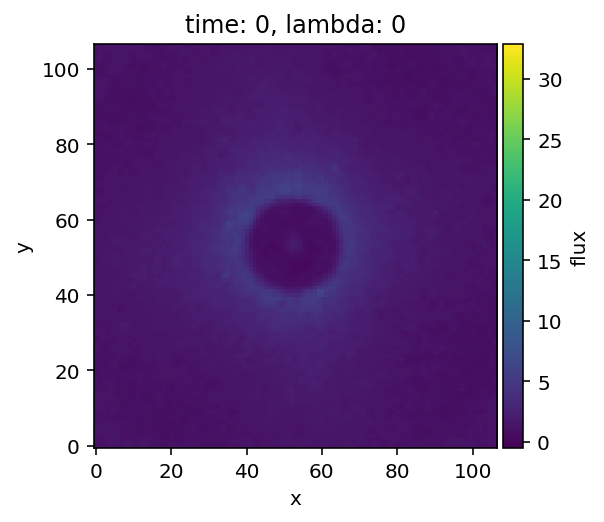

In [4]:
plot_cubes(cube)#, backend='bokeh')

We notice that the flux varies and the PSF size increases, both as a function of wavelength.

Now let's inspect the **PSF cube** (one frame per wavelength), which will be used for the actual injection of a fake planet:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
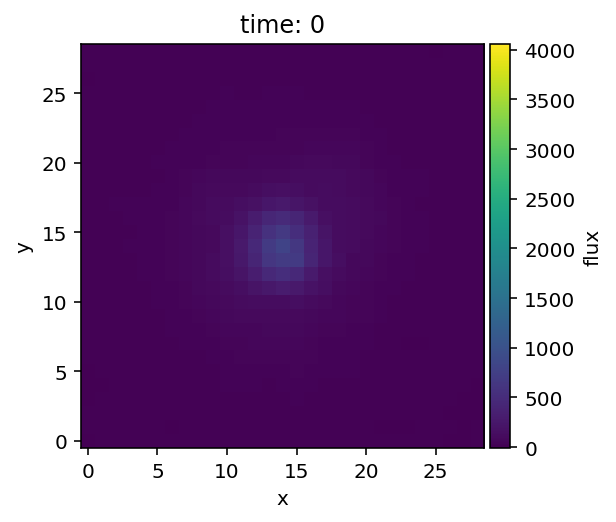

In [5]:
plot_cubes(psf)

As we can see, the flux varies as a function of wavelength. This reflects the intrinsic spectrum of the star but also the instrumental transmission and atmospheric absorption bands (e.g. associated to the water molecule) affecting some wavelengths more than others. The flux will be normalized in the next section, before injection.

Now let's check the **parallactic angle** and **airmass** variations:

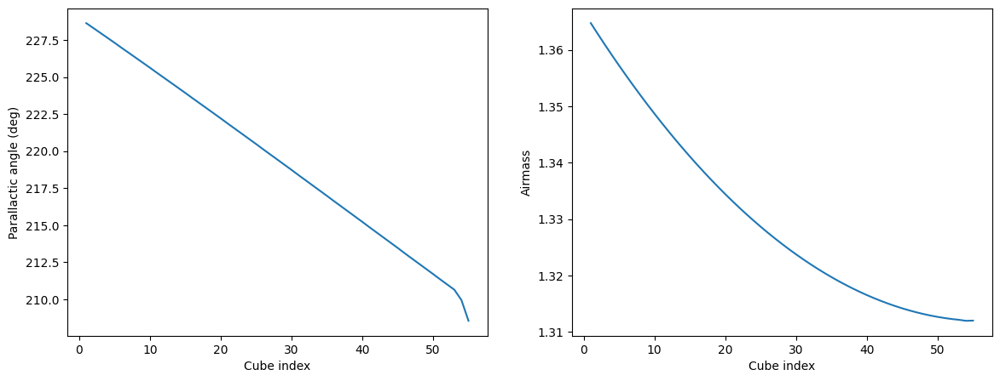

In [6]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(range(1,nz+1), derot_angles)
ax1.set_xlabel("Cube index")
ax1.set_ylabel("Parallactic angle (deg)")
ax2.plot(range(1,nz+1), X_sci)
ax2.set_xlabel("Cube index")
ax2.set_ylabel("Airmass")
plt.show()

Note the sudden variation in parallactic angle at the end of the sequence is because we trimmed bad frames from the sequence (all were located towards the end of the observation).

Let's define the **pixel scale** for IFS - note that this is optional since the planet coordinates will be given in pixels. It will still be useful to have meaningful radial separations expressed in arcsec.

In [7]:
plsc = VLT_SPHERE_IFS['plsc']
print(plsc, "arcsec/px")

0.00746 arcsec/px


Let's now load and visualize the coronagraphic radial **transmission** profile:

In [8]:
trans = open_fits(path+"../datasets/sphere_ifs_YJ_APLC_CoroTransmission.fits")

Fits HDU-0 data successfully loaded, header available. Data shape: (40, 23)


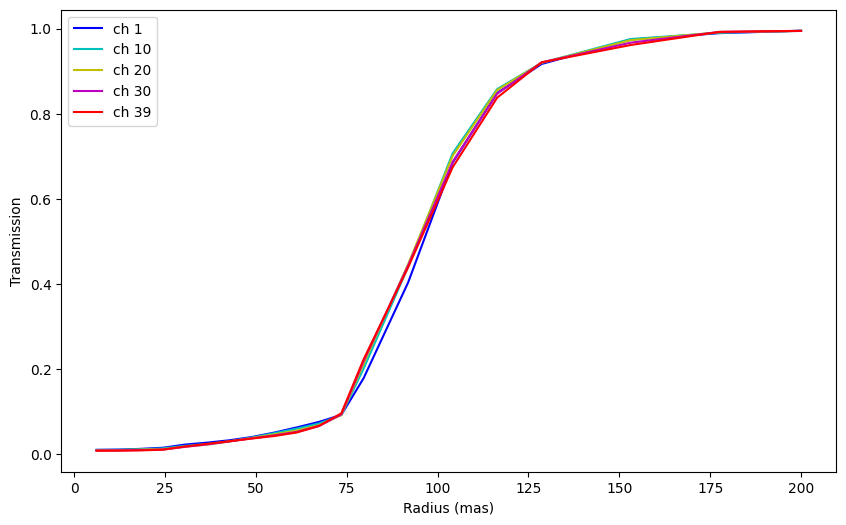

In [9]:
last_r = 20
plt.figure(figsize=(10,6))
plt.plot(trans[0,:last_r]*1000, trans[1,:last_r], 'b', label='ch 1')
plt.plot(trans[0,:last_r]*1000, trans[10,:last_r], 'c', label='ch 10')
plt.plot(trans[0,:last_r]*1000, trans[20,:last_r], 'y', label='ch 20')
plt.plot(trans[0,:last_r]*1000, trans[30,:last_r], 'm', label='ch 30')
plt.plot(trans[0,:last_r]*1000, trans[-1,:last_r], 'r', label='ch 39')
plt.xlabel("Radius (mas)")
plt.ylabel("Transmission")
plt.legend()

EDIT: this is not the most up-to-date SPHERE coronagraphic transmission curve. Please contact relevant SPHERE colleagues or check the ESO website for a newer version. Do not use the above curve for your research.

## 7.2. Planet parameters and spectra

Now let's set the **ground truth coordinates** and average **contrast** (over all wavelengths) at which two planets will be injected in this cube:

In [10]:
xy_b = (58.6,37.7)
contrast_b = 1e-3

xy_c = (83.8,29.9)
contrast_c = 2e-4

Let's convert cartesian to polar coordinates:

In [11]:
cy, cx = frame_center(cube)
r_b = dist(cy, cx, xy_b[1], xy_b[0])
r_c = dist(cy, cx, xy_c[1], xy_c[0])

theta_b = np.rad2deg(np.arctan2(xy_b[1]-cy, xy_b[0]-cx))
theta_c = np.rad2deg(np.arctan2(xy_c[1]-cy, xy_c[0]-cx))

In [12]:
print(cy, cx)
print(r_b, theta_b)
print(r_c, theta_c)

53 53
16.292636373527763 -69.89671372878468
38.5 -36.86989764584403


Now let's consider two fiducial model spectra for the injection of the 2 planets: a flat spectrum and a **1000K blackbody model** (note that this exercise is purely academic).

In [13]:
def blackbody(lbda, T): 
    fac = 2*c.h.value*(c.c.value**2)/(np.power(lbda*1e-6,5))
    div = (1/(np.exp((c.h.value*c.c.value)/((lbda*1e-6)*c.k_B.value*T))-1))
    # convert from W m-3 Sr-1 to W m-2 mu-1 Sr-1 
    conv = 1e-6
    return fac*div*conv

In [14]:
fluxes_b = np.ones_like(lbda)
fluxes_c = blackbody(lbda, 1000)

spec_b = np.array([lbda, fluxes_b])
spec_c = np.array([lbda, fluxes_c])

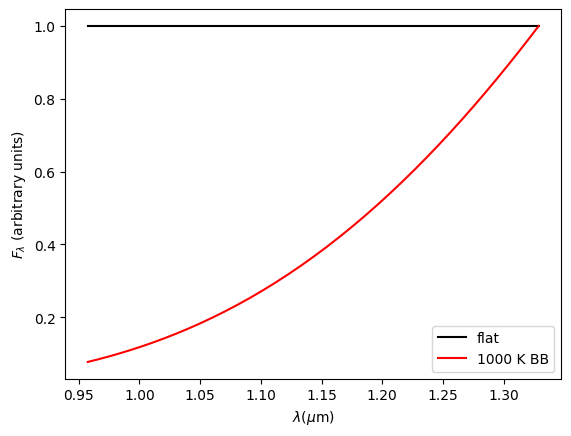

In [15]:
plt.plot(lbda, fluxes_b/np.amax(fluxes_b), 'k', label='flat')
plt.plot(lbda, fluxes_c/np.amax(fluxes_c), 'r', label='1000 K BB')
plt.xlabel(r"$\lambda (\mu$m)")
plt.ylabel(r"$ F_{\lambda}$ (arbitrary units)")
plt.legend()

## 7.3. Flux normalization

### 7.3.1. Non-coronagraphic PSF normalization

Let's measure the flux and FWHM of the non-coronagraphic PSF and normalize its flux to 1 in a 1-FWHM radius aperture (all at once), in all channels, using VIP's `fm/normalize_psf` function. We use the `debug` option to check that each 2D Gaussian fit worked properly:

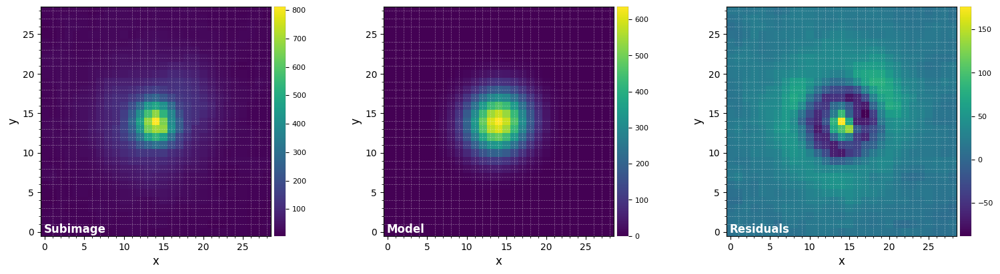

FWHM_y = 6.2499185906038734
FWHM_x = 5.955174570808004 

centroid y = 13.91271280451398
centroid x = 13.899308522396119
centroid y subim = 13.91271280451398
centroid x subim = 13.899308522396119 

amplitude = 636.3209207163184
theta = -40.20327494893463


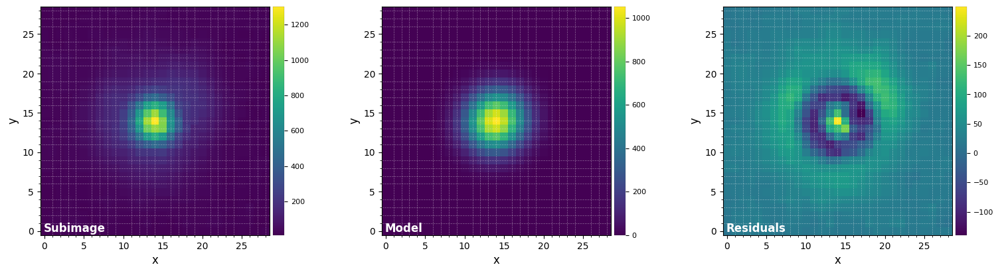

FWHM_y = 6.115031733429569
FWHM_x = 5.839092912200307 

centroid y = 14.027611189747118
centroid x = 13.902123414264741
centroid y subim = 14.027611189747118
centroid x subim = 13.902123414264741 

amplitude = 1054.2949916060757
theta = -37.53607125551687


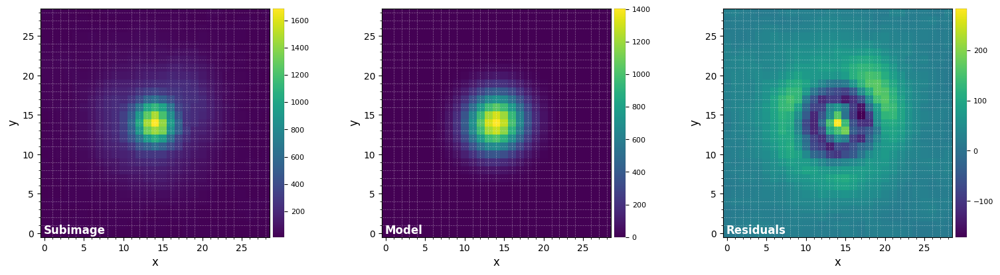

FWHM_y = 6.017536940985172
FWHM_x = 5.754055056932398 

centroid y = 14.064675014829234
centroid x = 13.921899407828272
centroid y subim = 14.064675014829234
centroid x subim = 13.921899407828272 

amplitude = 1404.794695125425
theta = -32.75340696040898


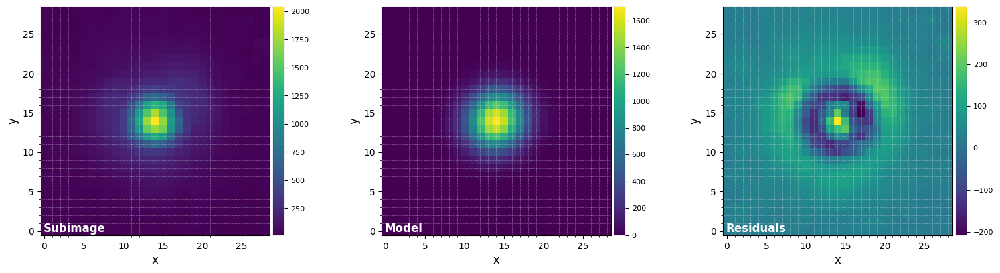

FWHM_y = 5.991878155204902
FWHM_x = 5.682647009421292 

centroid y = 14.065184394206566
centroid x = 13.946038597175642
centroid y subim = 14.065184394206566
centroid x subim = 13.946038597175642 

amplitude = 1705.2716467835362
theta = -37.3838283117331


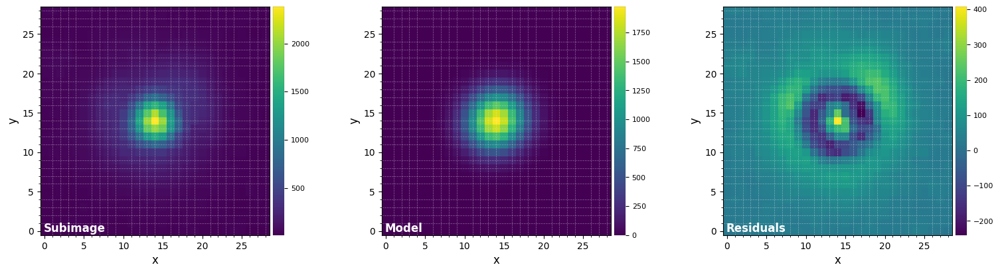

FWHM_y = 6.025210456840216
FWHM_x = 5.719302651409165 

centroid y = 14.075784813017492
centroid x = 13.955473078460203
centroid y subim = 14.075784813017492
centroid x subim = 13.955473078460203 

amplitude = 1975.5120237812189
theta = -39.22716810162709


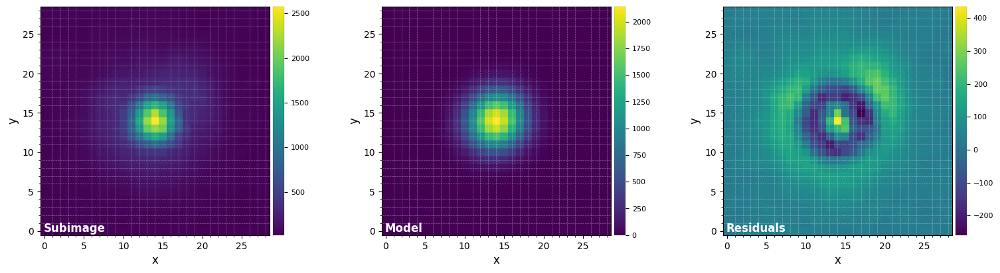

FWHM_y = 5.985037638845696
FWHM_x = 5.719904342290713 

centroid y = 14.090563585852337
centroid x = 13.954901979145369
centroid y subim = 14.090563585852337
centroid x subim = 13.954901979145369 

amplitude = 2143.9966998784653
theta = -37.89243906967075


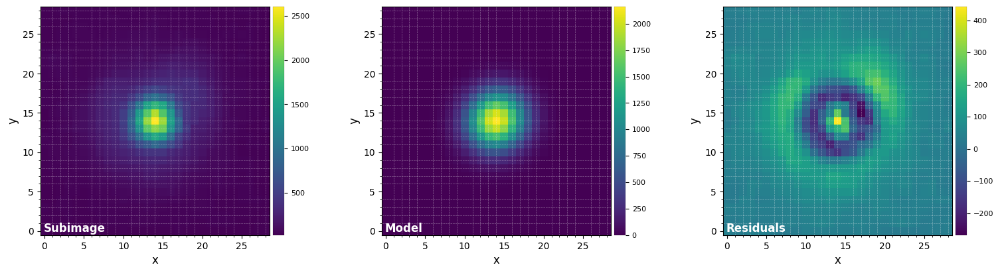

FWHM_y = 6.037449649433551
FWHM_x = 5.7537333670610575 

centroid y = 14.109510955089712
centroid x = 13.980317492176528
centroid y subim = 14.109510955089712
centroid x subim = 13.980317492176528 

amplitude = 2165.8668020759737
theta = -38.98816537803606


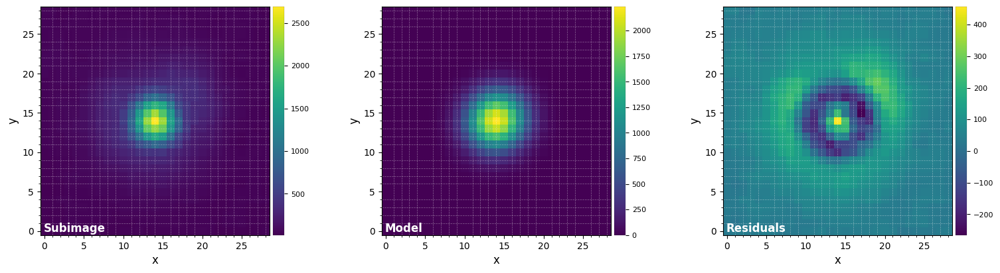

FWHM_y = 6.010425979656497
FWHM_x = 5.749988204486838 

centroid y = 14.09139902516843
centroid x = 13.986593684665714
centroid y subim = 14.09139902516843
centroid x subim = 13.986593684665714 

amplitude = 2237.452674183443
theta = -42.08255560940275


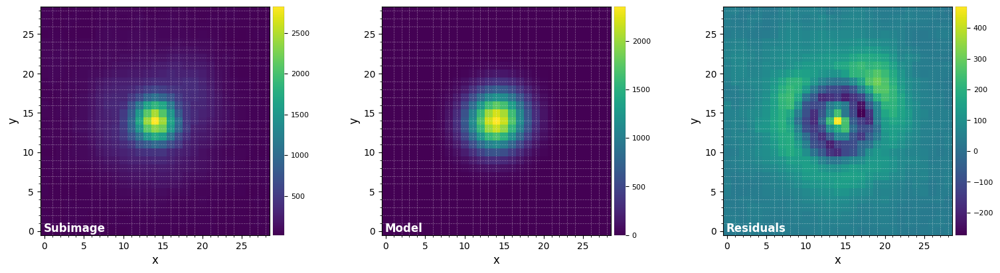

FWHM_y = 6.005151597188339
FWHM_x = 5.76618913736032 

centroid y = 14.090254937281216
centroid x = 14.000261828564383
centroid y subim = 14.090254937281216
centroid x subim = 14.000261828564383 

amplitude = 2355.107335363224
theta = -38.12872688402823


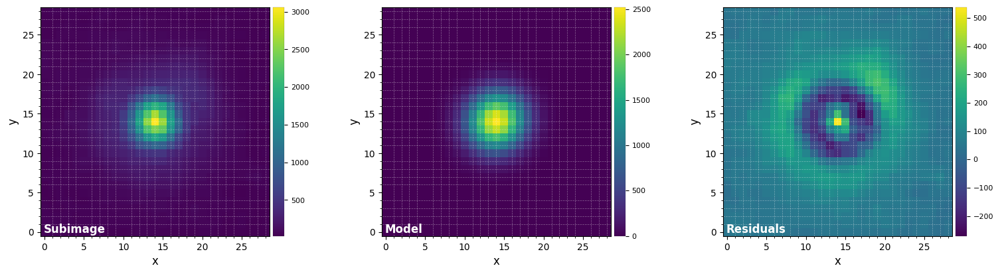

FWHM_y = 5.968097471114103
FWHM_x = 5.732989798767101 

centroid y = 14.102026780112466
centroid x = 14.00192256597961
centroid y subim = 14.102026780112466
centroid x subim = 14.00192256597961 

amplitude = 2523.9552216610077
theta = -36.166718794700756


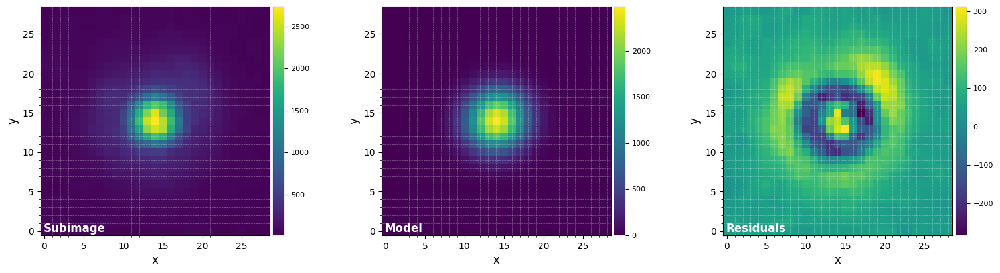

FWHM_y = 6.2010452530776154
FWHM_x = 5.952529125955214 

centroid y = 14.095618864845
centroid x = 14.011238141279225
centroid y subim = 14.095618864845
centroid x subim = 14.011238141279225 

amplitude = 2483.278573203233
theta = -40.01453306581354


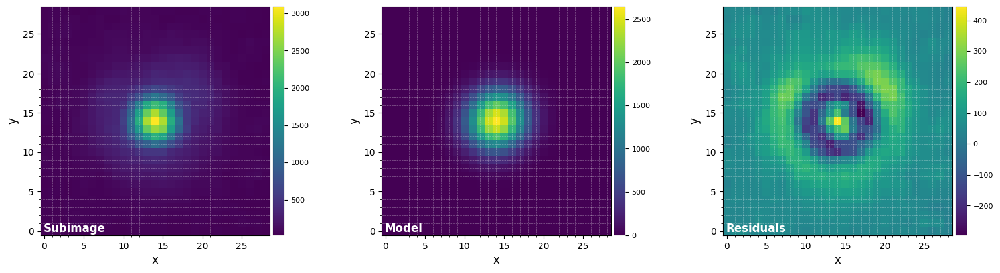

FWHM_y = 6.116743999603686
FWHM_x = 5.8392716209686455 

centroid y = 14.100847253492372
centroid x = 14.00962801008164
centroid y subim = 14.100847253492372
centroid x subim = 14.00962801008164 

amplitude = 2649.287384055851
theta = -42.972115252638694


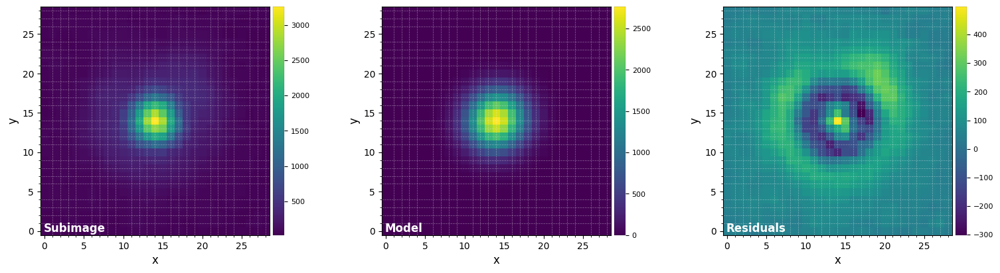

FWHM_y = 6.037056836634695
FWHM_x = 5.786392745945851 

centroid y = 14.110142788418528
centroid x = 14.004784235107898
centroid y subim = 14.110142788418528
centroid x subim = 14.004784235107898 

amplitude = 2770.024028598639
theta = -39.87700223679414


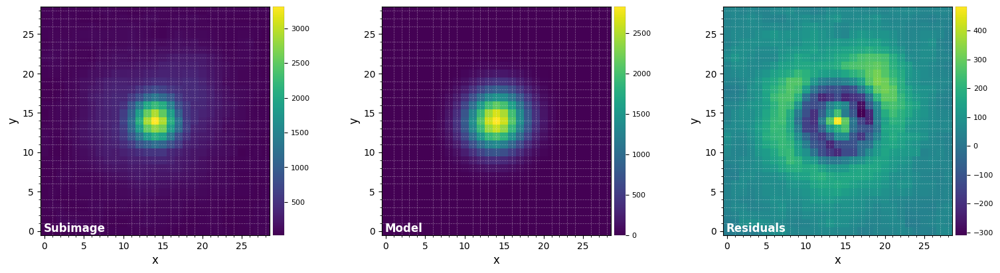

FWHM_y = 6.066318706454739
FWHM_x = 5.822724547903064 

centroid y = 14.099317823674594
centroid x = 14.003150239115127
centroid y subim = 14.099317823674594
centroid x subim = 14.003150239115127 

amplitude = 2830.2548549551825
theta = -47.812018317067206


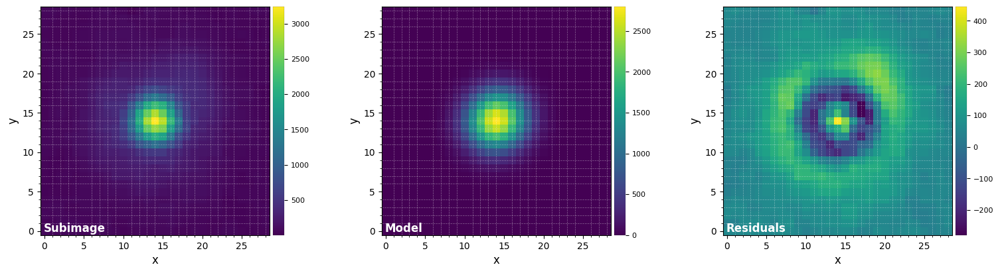

FWHM_y = 6.0762534866894
FWHM_x = 5.806486874018672 

centroid y = 14.112521461447967
centroid x = 14.034377198494248
centroid y subim = 14.112521461447967
centroid x subim = 14.034377198494248 

amplitude = 2803.4053532338025
theta = -1130.8992713799976


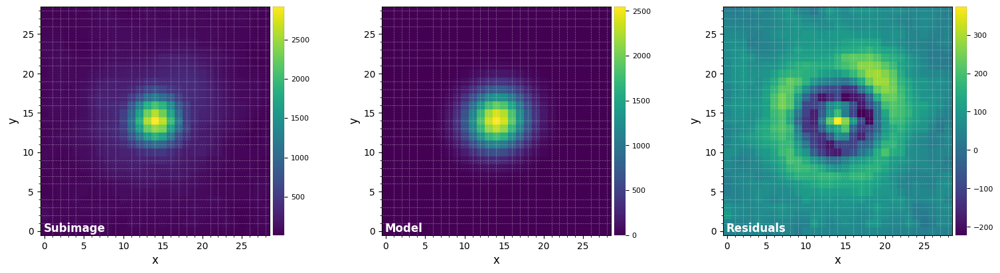

FWHM_y = 5.783408275201281
FWHM_x = 6.0947688987153565 

centroid y = 14.151451482312362
centroid x = 14.046235885495358
centroid y subim = 14.151451482312362
centroid x subim = 14.046235885495358 

amplitude = 2553.3202894435076
theta = -1046.1876651444493


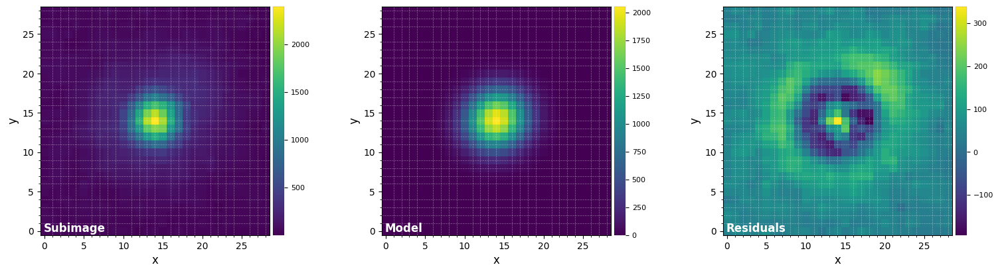

FWHM_y = 6.18160840917673
FWHM_x = 5.819390957373637 

centroid y = 14.20606445385617
centroid x = 14.027564827140305
centroid y subim = 14.20606445385617
centroid x subim = 14.027564827140305 

amplitude = 2063.1990467607516
theta = -591.897110332275


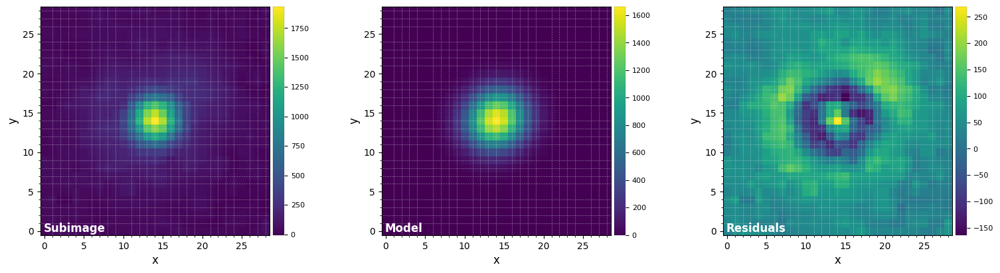

FWHM_y = 5.751799509227017
FWHM_x = 6.1765754988581305 

centroid y = 14.19949897448417
centroid x = 14.014692740126705
centroid y subim = 14.19949897448417
centroid x subim = 14.014692740126705 

amplitude = 1668.5838006836177
theta = 214.19574589903868


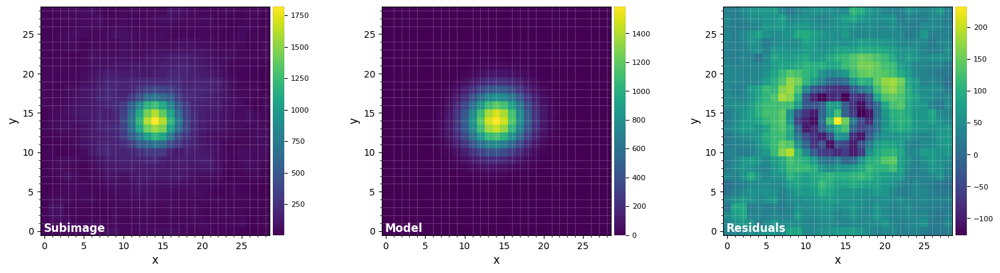

FWHM_y = 5.797247573087524
FWHM_x = 6.1407206833700165 

centroid y = 14.09188009914479
centroid x = 13.978278484577537
centroid y subim = 14.09188009914479
centroid x subim = 13.978278484577537 

amplitude = 1587.9799968312032
theta = 208.93362670690016


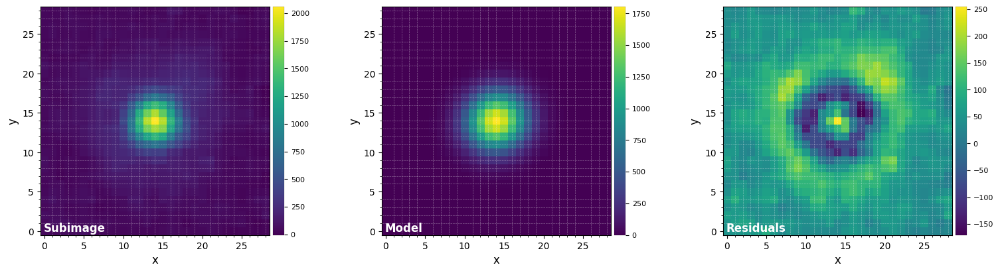

FWHM_y = 6.173286713166213
FWHM_x = 5.849770266197921 

centroid y = 14.020275158086994
centroid x = 14.002567343397786
centroid y subim = 14.020275158086994
centroid x subim = 14.002567343397786 

amplitude = 1805.5945901482098
theta = 117.55114919185252


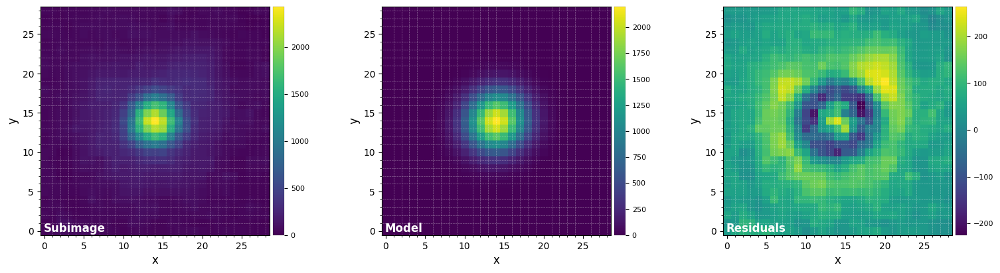

FWHM_y = 5.8792339430596385
FWHM_x = 6.127221726103625 

centroid y = 13.989753883492577
centroid x = 14.002807252408369
centroid y subim = 13.989753883492577
centroid x subim = 14.002807252408369 

amplitude = 2198.15726732781
theta = -320.21556683332454


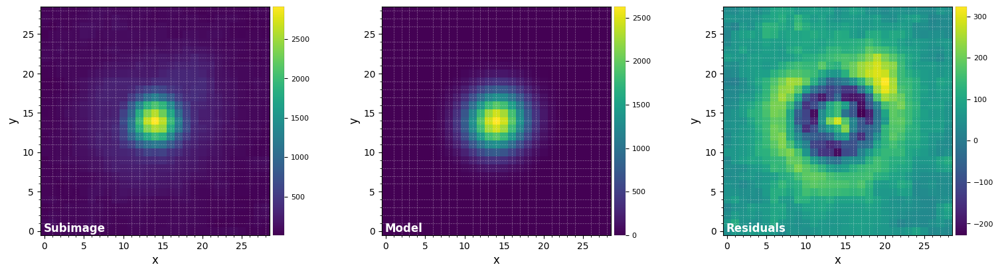

FWHM_y = 5.887171922875942
FWHM_x = 6.160164896057722 

centroid y = 14.006124941599417
centroid x = 14.009936779590372
centroid y subim = 14.006124941599417
centroid x subim = 14.009936779590372 

amplitude = 2628.450008946031
theta = -321.35901701076017


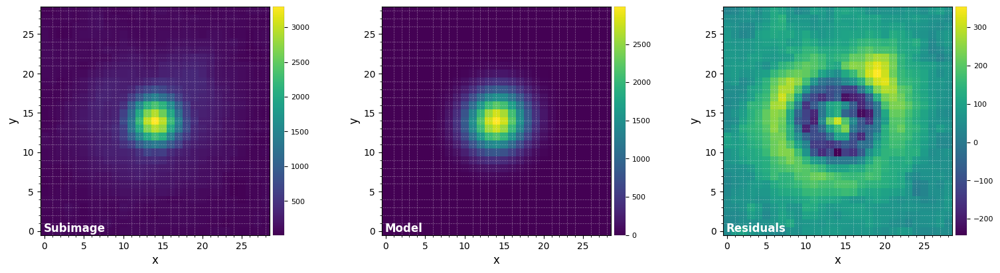

FWHM_y = 6.098319375621081
FWHM_x = 5.823811534748942 

centroid y = 14.045780781152429
centroid x = 14.014771011818317
centroid y subim = 14.045780781152429
centroid x subim = 14.014771011818317 

amplitude = 2992.271712291609
theta = -228.95610739084978


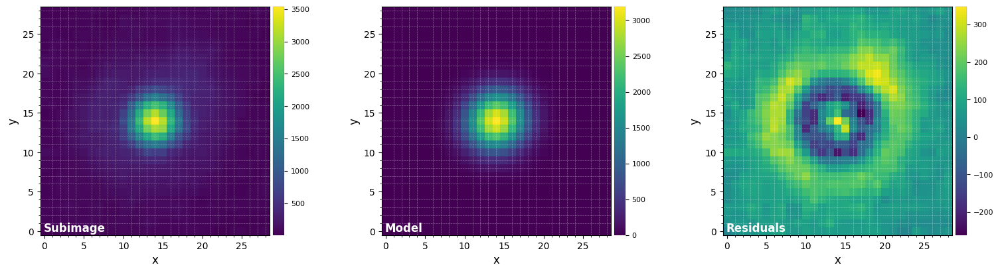

FWHM_y = 6.0881435225079805
FWHM_x = 5.800320948866406 

centroid y = 14.051247831816042
centroid x = 13.998093842075047
centroid y subim = 14.051247831816042
centroid x subim = 13.998093842075047 

amplitude = 3191.2868185639486
theta = -409.9397195034933


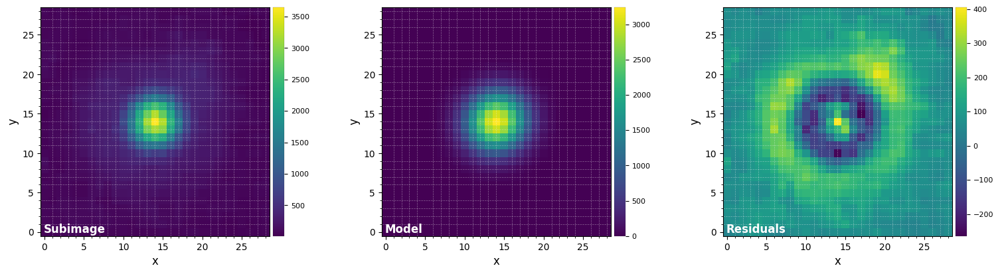

FWHM_y = 6.131166433598984
FWHM_x = 5.872212732710025 

centroid y = 14.035337815438458
centroid x = 13.998171477355866
centroid y subim = 14.035337815438458
centroid x subim = 13.998171477355866 

amplitude = 3243.1658846376727
theta = -50.094032052651215


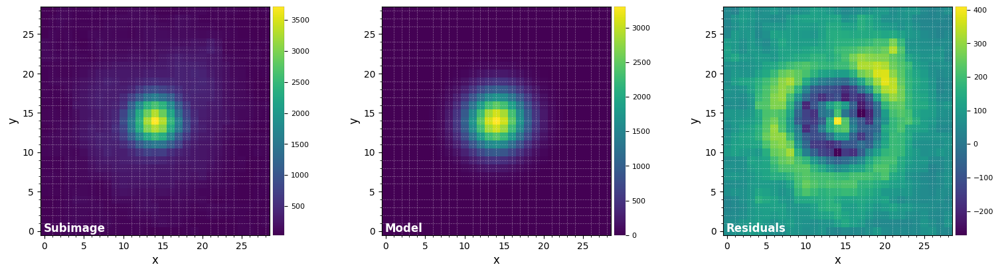

FWHM_y = 6.174942665281358
FWHM_x = 5.993212466027066 

centroid y = 14.039753518531834
centroid x = 13.991921001228043
centroid y subim = 14.039753518531834
centroid x subim = 13.991921001228043 

amplitude = 3307.870326350025
theta = -60.778524955012216


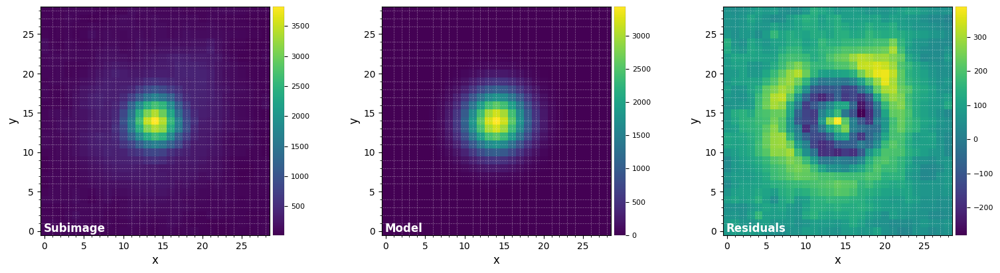

FWHM_y = 6.212946741792123
FWHM_x = 6.032862559194067 

centroid y = 14.009742407110084
centroid x = 13.967991908928983
centroid y subim = 14.009742407110084
centroid x subim = 13.967991908928983 

amplitude = 3436.0292572548005
theta = -233.0743437511544


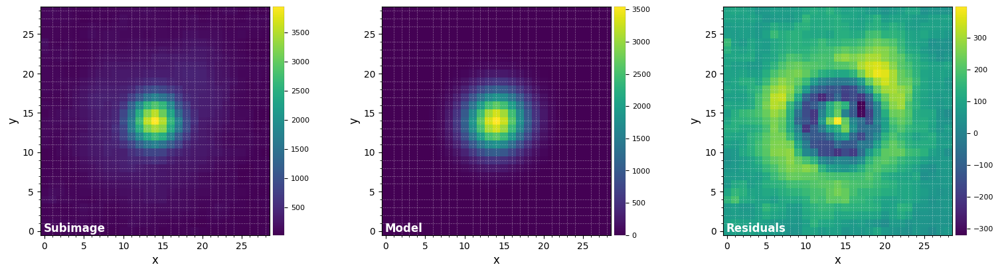

FWHM_y = 6.202834710260402
FWHM_x = 5.991454580720097 

centroid y = 14.020014512644996
centroid x = 13.952064722408837
centroid y subim = 14.020014512644996
centroid x subim = 13.952064722408837 

amplitude = 3546.6560417516
theta = -45.0887395475915


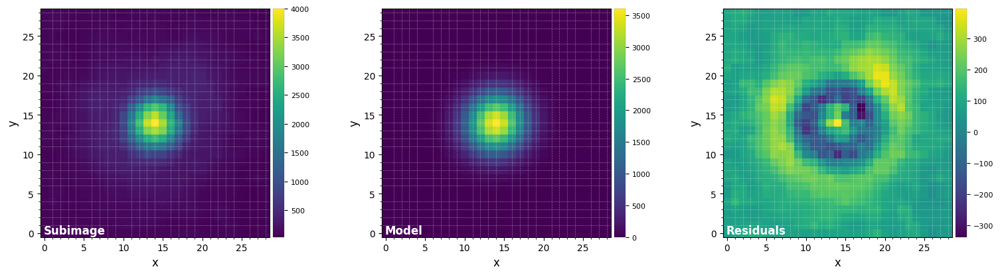

FWHM_y = 6.188582125824742
FWHM_x = 5.985402654686103 

centroid y = 14.01288592814225
centroid x = 13.933314914222532
centroid y subim = 14.01288592814225
centroid x subim = 13.933314914222532 

amplitude = 3607.1363107135303
theta = -45.54255278702486


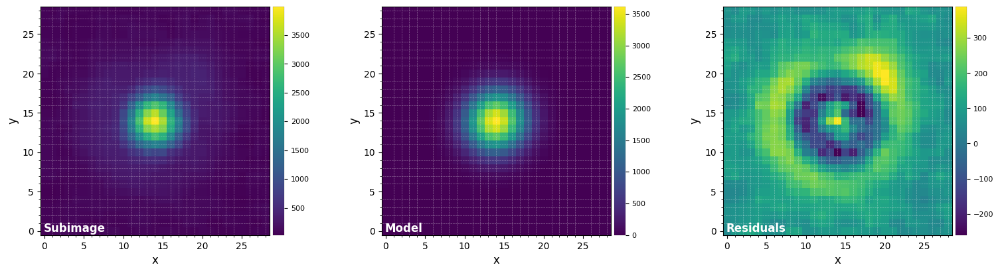

FWHM_y = 6.244755229547681
FWHM_x = 6.022172272874138 

centroid y = 14.005908973811751
centroid x = 13.928682611420811
centroid y subim = 14.005908973811751
centroid x subim = 13.928682611420811 

amplitude = 3616.190962501067
theta = -32.9257630430613


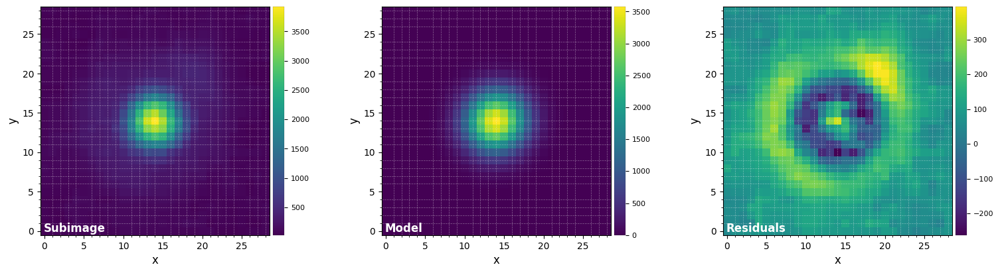

FWHM_y = 6.273041721822999
FWHM_x = 6.080609549848098 

centroid y = 13.982299985252563
centroid x = 13.934886096628695
centroid y subim = 13.982299985252563
centroid x subim = 13.934886096628695 

amplitude = 3579.5485931779963
theta = -38.8109468817101


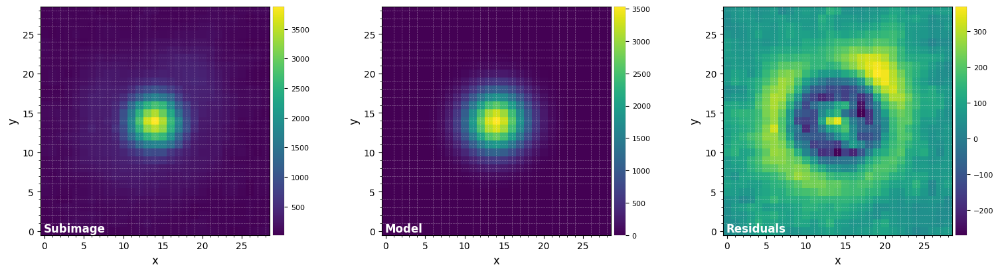

FWHM_y = 6.272897782073148
FWHM_x = 6.150604153616258 

centroid y = 13.949986873367504
centroid x = 13.940065010491569
centroid y subim = 13.949986873367504
centroid x subim = 13.940065010491569 

amplitude = 3535.362591691256
theta = -1487.0522520173815


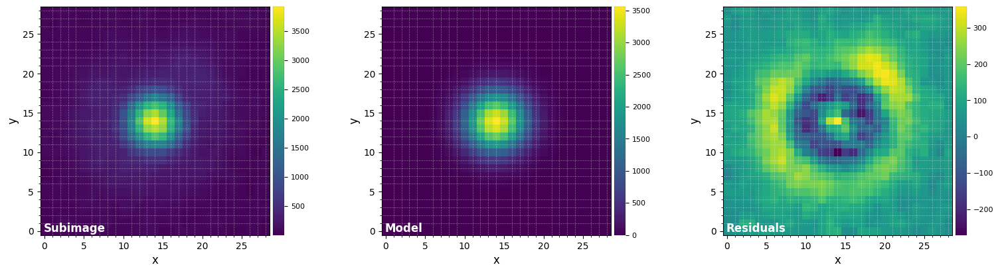

FWHM_y = 6.169653553625251
FWHM_x = 6.268150616054396 

centroid y = 13.93102667705402
centroid x = 13.920174694300993
centroid y subim = 13.93102667705402
centroid x subim = 13.920174694300993 

amplitude = 3562.2524885100333
theta = 32.84281796852144


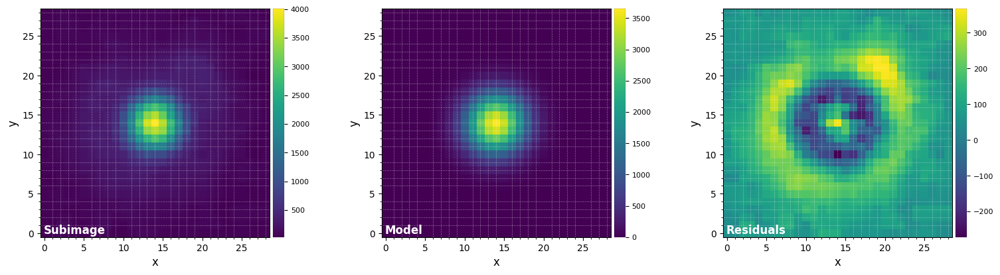

FWHM_y = 6.274537554461365
FWHM_x = 6.15783778729409 

centroid y = 13.934250084708731
centroid x = 13.921697907180066
centroid y subim = 13.934250084708731
centroid x subim = 13.921697907180066 

amplitude = 3655.6640709273543
theta = 129.00320367484554


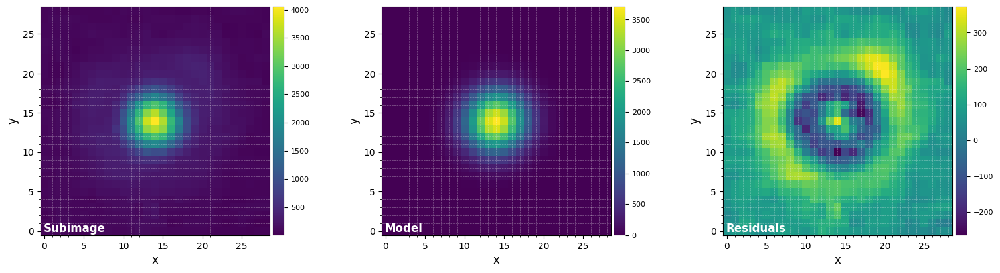

FWHM_y = 6.311436197883887
FWHM_x = 6.1353158474999905 

centroid y = 13.94518468204029
centroid x = 13.904558439173428
centroid y subim = 13.94518468204029
centroid x subim = 13.904558439173428 

amplitude = 3713.2225587915073
theta = -41.34373753295239


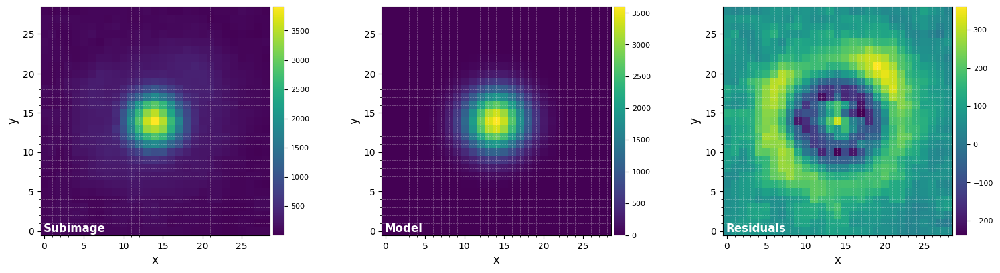

FWHM_y = 6.330588326064803
FWHM_x = 6.183593806778592 

centroid y = 13.972693149768391
centroid x = 13.88644208061843
centroid y subim = 13.972693149768391
centroid x subim = 13.88644208061843 

amplitude = 3603.9831791184242
theta = -39.62090236137112


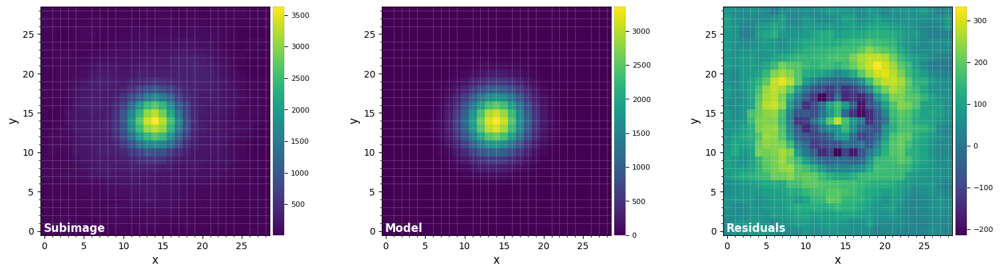

FWHM_y = 6.184001319791858
FWHM_x = 6.343494125581091 

centroid y = 13.949799213255506
centroid x = 13.88297982179931
centroid y subim = 13.949799213255506
centroid x subim = 13.88297982179931 

amplitude = 3362.4927849833225
theta = -131.56407953215066


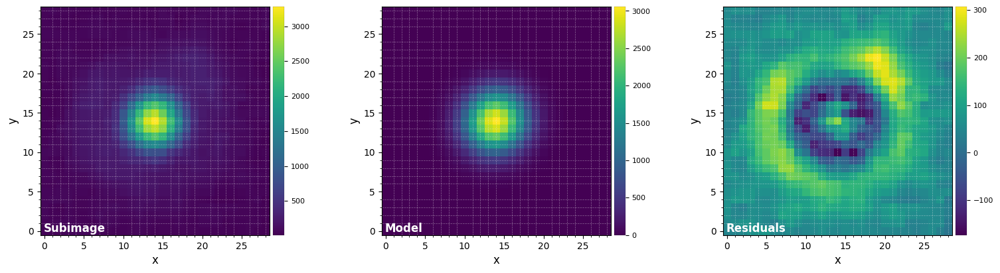

FWHM_y = 6.104938363807356
FWHM_x = 6.326105627594453 

centroid y = 13.96352838089737
centroid x = 13.869285619427107
centroid y subim = 13.96352838089737
centroid x subim = 13.869285619427107 

amplitude = 3062.496146821083
theta = -498.2520143063228


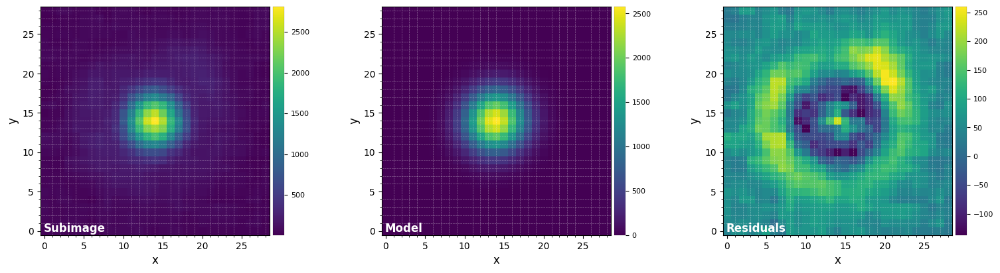

FWHM_y = 6.281872522406608
FWHM_x = 6.1068962716933175 

centroid y = 14.035165570900137
centroid x = 13.854666632371053
centroid y subim = 14.035165570900137
centroid x subim = 13.854666632371053 

amplitude = 2583.8408147326386
theta = -35.59944036195603
Mean FWHM per channel: 
[6.103 5.977 5.886 5.837 5.872 5.852 5.896 5.88  5.886 5.851 6.077 5.978
 5.912 5.945 5.941 5.939 6.    5.964 5.969 6.012 6.003 6.024 5.961 5.944
 6.002 6.084 6.123 6.097 6.087 6.133 6.177 6.212 6.219 6.216 6.223 6.257
 6.264 6.216 6.194]
Flux in 1xFWHM aperture: 
[13397.649 21373.517 27661.433 33057.763 38754.981 41781.661 42805.645
 44021.68  46395.703 49082.614 52371.307 53918.696 55093.806 56930.742
 56350.541 51298.303 42189.297 33733.493 32181.659 37142.073 45223.932
 54394.967 60556.863 64201.073 66477.378 69675.456 73203.718 74978.343
 76002.683 77311.678 77583.749 77448.172 78182.432 80187.787 81616.948
 80114.272 74899.496 67091.761 56185.008]


In [16]:
%matplotlib inline
psfn, flux_st, fwhm = normalize_psf(psf, fwhm='fit', full_output=True, debug=True)

Now let's plot the measured FWHM and stellar flux:

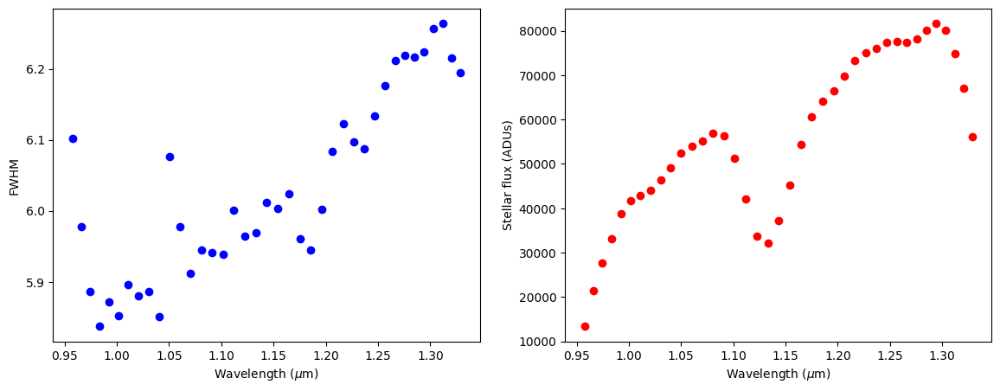

In [17]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, fwhm, 'bo')
ax1.set_xlabel(r"Wavelength ($\mu$m)")
ax1.set_ylabel("FWHM")
ax2.plot(lbda, flux_st, 'ro')
ax2.set_xlabel(r"Wavelength ($\mu$m)")
ax2.set_ylabel("Stellar flux (ADUs)")
plt.show()

**Fig. 3.1**: Measured FWHM and stellar flux in the non-coronagraphic PSF cube.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
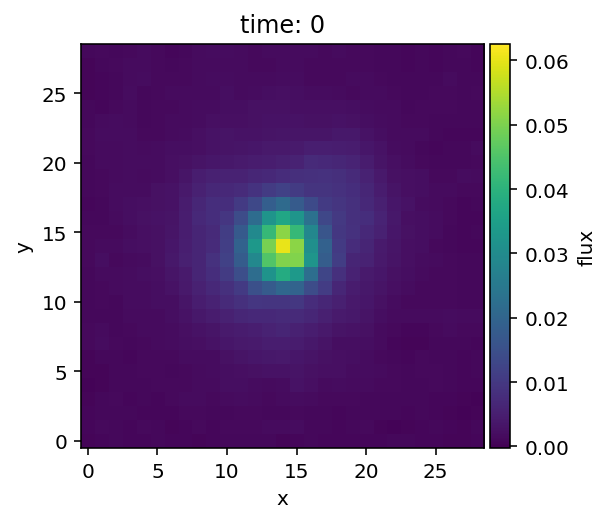

In [18]:
plot_cubes(psfn, grid=True)

Now let's save the measured spectrum of the star in the format we will need for the injection function:

In [19]:
spec_star = np.array([lbda, flux_st])

### 7.3.2. Stellar SED model

The spectral type of the star (HIP39826) is K7V. For the purpose of this tutorial, we simply load a BT-NextGen SED model that has already be resampled considering the spectral resolution and sampling of SPHERE-IFS:

In [20]:
spec_star_mod = open_fits("../datasets/sphere_ifs_HIP39826_SED_model.fits")

plt.plot(spec_star_mod[0], spec_star_mod[0]*spec_star_mod[1], 'k', label='Model SED for the star')
plt.ylabel(r"$\lambda F_{\lambda}$ (arbitrary units)")
plt.legend()

Fits HDU-0 data successfully loaded, header available. Data shape: (2, 39)


### 7.3.3. Airmass

Airmass variation can also be taken into consideration during the injection of the planet spectra (more specifically we consider the ratio between individual airmass values and the median airmass over the observation):

In [21]:
med_X = np.median(X_sci)
X_fac = np.exp(-(X_sci-med_X))

Let's plot the factors to be applied to correct for airmass (w.r.t median airmass):

In [22]:
%matplotlib inline
plt.plot(range(1,nz+1), X_fac, 'k')
plt.xlabel("Cube index")
plt.ylabel("X factor")

Text(25.097222222222214, 0.5, 'X factor')

### 7.3.4. Final fluxes

Let's now calculate the fluxes at which the normalized PSF will actually be injected in each frame of each spectral cube.

Considering the effect of instrumental and atmospheric transmission, we have:

In [23]:
flux_b_trans = fluxes_b*(flux_st/spec_star_mod[1])
flux_c_trans = fluxes_c*(flux_st/spec_star_mod[1])                     

Considering the actual mean contrast we want the planet to be injected, with respect to the star, we have:

In [24]:
flux_b_scal = flux_b_trans*contrast_b*np.mean(flux_st)/np.mean(flux_b_trans)
flux_c_scal = flux_c_trans*contrast_c*np.mean(flux_st)/np.mean(flux_c_trans) 

Finally let's consider the airmass:

In [25]:
final_fluxes_b = np.outer(flux_b_scal, X_fac)
final_fluxes_c = np.outer(flux_c_scal, X_fac)

Note that the effect of coronagraphic transmission is directly taken into account in the injection function (next section).

## 7.4. Injection

The actual injection can be simply performed with the `cube_inject_companions` function, which can handle 4D input cubes. Let's inject the first planet first:

In [26]:
cube_fc = cube_inject_companions(cube, psfn, derot_angles, flevel=final_fluxes_b, 
                                 plsc=plsc, rad_dists=[r_b], n_branches=1, 
                                 theta=theta_b, transmission=trans, verbose=True)

*** Processing spectral channel 1/39 ***
*** Processing spectral channel 2/39 ***
*** Processing spectral channel 3/39 ***
*** Processing spectral channel 4/39 ***
*** Processing spectral channel 5/39 ***
*** Processing spectral channel 6/39 ***
*** Processing spectral channel 7/39 ***
*** Processing spectral channel 8/39 ***
*** Processing spectral channel 9/39 ***
*** Processing spectral channel 10/39 ***
*** Processing spectral channel 11/39 ***
*** Processing spectral channel 12/39 ***
*** Processing spectral channel 13/39 ***
*** Processing spectral channel 14/39 ***
*** Processing spectral channel 15/39 ***
*** Processing spectral channel 16/39 ***
*** Processing spectral channel 17/39 ***
*** Processing spectral channel 18/39 ***
*** Processing spectral channel 19/39 ***
*** Processing spectral channel 20/39 ***
*** Processing spectral channel 21/39 ***
*** Processing spectral channel 22/39 ***
*** Processing spectral channel 23/39 ***
*** Processing spectral channel 24/39 ***
*

Let's now inject the second planet in the same cube:

In [27]:
cube_fc = cube_inject_companions(cube_fc, psfn, derot_angles, flevel=final_fluxes_c, 
                                 plsc=plsc, rad_dists=[r_c], n_branches=1, 
                                 theta=theta_c, transmission=trans, verbose=False)

Let's inspect the cube with the inject companions:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
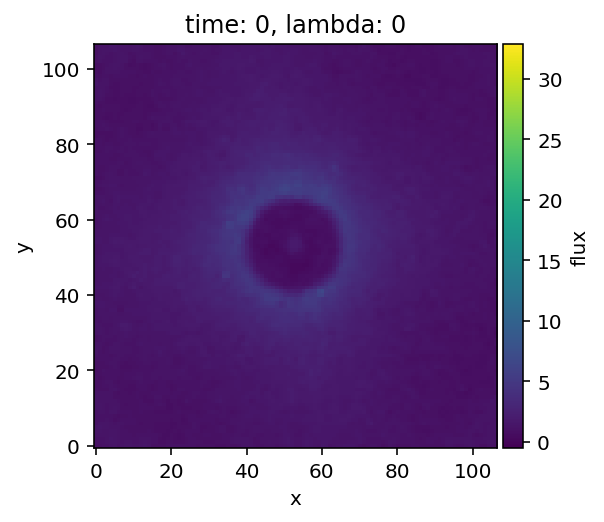

In [28]:
plot_cubes(cube_fc)

[Go to the top](#Table-of-contents)

## 7.5. Post-processing of IFS data

Let's now try to recover the 2 injected companions using different post-processing algorithms.

### 7.5.1. Optimal scaling factors

In order to leverage the radial expansion of the stellar PSF with wavelength through spectral differential imaging, let's first compute the optimal scaling factors between the spectral channels. For a perfect AO correction and flat stellar spectrum, one would expect the scaling factors to be (exactly) inversely proportional to the wavelength. Reality deviates a bit from these assumptions but this still makes for a good first guess:

In [29]:
th_scal = lbda[-1]/lbda
th_scal

array([1.3877398, 1.375682 , 1.3635113, 1.3512615, 1.3389585, 1.3266245,
       1.3142908, 1.3019674, 1.2896852, 1.2774729, 1.2653329, 1.2532798,
       1.2413497, 1.2295421, 1.217879 , 1.2063586, 1.1950108, 1.1838219,
       1.1728301, 1.1620203, 1.151418 , 1.1410172, 1.1308315, 1.1208638,
       1.1111166, 1.1016016, 1.092311 , 1.0832641, 1.0744526, 1.0658859,
       1.0575558, 1.0494791, 1.0416555, 1.0340765, 1.0267497, 1.0196825,
       1.0128585, 1.0063006, 1.       ], dtype=float32)

Let's use `preproc.find_scal_vector` to refine this estimate. This function will find the optimal scaling factors (both in terms of geometric scaling and flux scaling) between each spectral channel and the last one such that their subtraction yields minimal residuals. For coronagraphic observations, it is recommended to provide a binary `mask`, corresponding to the location where the residuals will be calculated, which avoids the area encompassed by the coronagraphic mask, in order to achieve the best estimate.
Here we use the mean of the 4D cube along the temporal direction to find the factors:

In [30]:
mask = np.ones_like(cube[0,0])
mask = mask_circle(mask, int(0.16/plsc))

opt_scal_mean, opt_flux = find_scal_vector(np.mean(cube,axis=1), lbda, flux_st, 
                                           mask=mask, nfp=2, fm="stddev")

Although a bit slower, another approach would be to calculate the scaling factors for each individual spectral cube, and use the median values:

In [31]:
opt_scals = np.zeros([cube.shape[1],cube.shape[0]])
opt_fluxes = np.zeros([cube.shape[1],cube.shape[0]])
for i in range(cube.shape[1]):
    opt_scals[i], opt_fluxes[i] = find_scal_vector(cube[:,i], lbda, flux_st, mask=mask, nfp=2, fm="stddev")

In [32]:
opt_scal_med = np.median(opt_scals,axis=0)
opt_flux_med = np.median(opt_fluxes,axis=0)

Let's plot the theoretical and empirical scaling factors: 

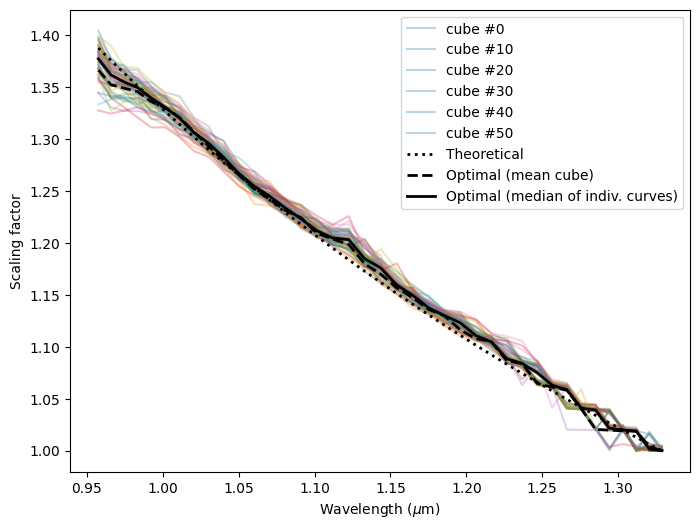

In [33]:
%matplotlib inline
plt.figure(figsize=(8,6))
for i in range(cube.shape[1]):
    if not i%10:
        label = 'cube #{}'.format(i)
    else:
        label = None
    plt.plot(lbda, opt_scals[i], alpha=0.3, label=label)
plt.plot(lbda, th_scal, 'k:', lw=2, label='Theoretical')
plt.plot(lbda, opt_scal_mean, 'k--', lw=2, label='Optimal (mean cube)')
plt.plot(lbda, np.median(opt_scals,axis=0), 'k-', lw=2, label='Optimal (median of indiv. curves)')
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("Scaling factor")
plt.legend()

Let's visualize the actual residuals in the first spectral cube:

In [34]:
res_cube_test_opt = np.zeros([cube.shape[0],cube.shape[-2],cube.shape[-1]])
for i in range(cube.shape[0]):
    res_cube_test_opt[i] = opt_fluxes[0,i]*frame_rescaling(cube[i,0], scale=opt_scal_med[i])-cube[-1,0]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[107, 107, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
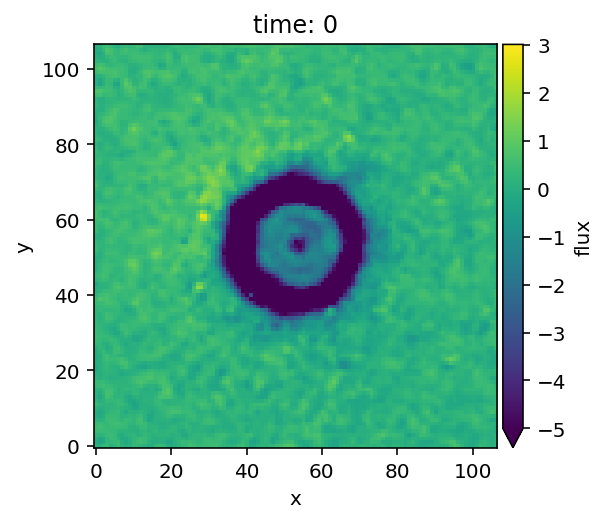

In [35]:
plot_cubes(res_cube_test_opt, vmin=-5)

Apart from the residual starlight at the edge of the coronagraphic mask (which does not expand radially), we see that the stellar halo is very well subtracted.

### 7.5.2. median-SDI 

The most basic way to leverage the radial diversity present in IFS data is to perform median-SDI (i.e. the radial equivalent to median-ADI). For that just use the `psfsub.median_sub` function, with the `sdi_only` option on: 

In [36]:
mask_px = int(0.1/plsc)

med_SDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, sdi_only=True,
                     radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:37:39
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:28.743692
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:32.278444
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


For better results, it is recommended to use both the geometrical and flux scaling factors found in the previous section:

In [37]:
med_SDI_opt = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med, sdi_only=True,
                         radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:38:12
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:28.332437
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:32.218888
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's compare both reductions, showing circles at the ground truth locations where we injected the fake companions.

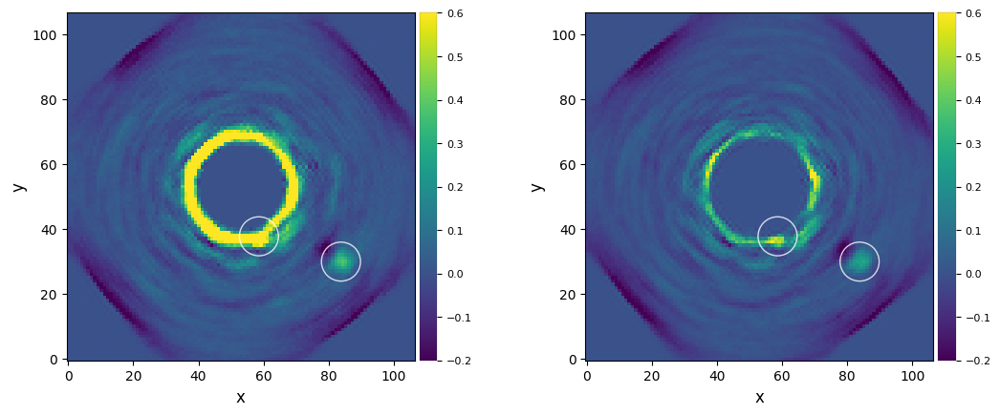

In [38]:
%matplotlib inline
plot_frames((med_SDI, med_SDI_opt), circle=(xy_b,xy_c), vmin=-0.2, vmax=0.6)

In the first image, we notice the limitation of SDI at short angular separation. Since the stellar residuals at the edge of the coronagraphic mask do not expand radially as the rest of the stellar halo, we are left with a bright spurious ring, preventing the re-detection of fake planet b.

We see that the median-SDI reduction with scaled fluxes performs slightly better at subtracting stellar residuals near the edge of the coronagraphic mask, although fake planet b is still not recovered.

Fake planet c is redetected. Let's compare its signal-to-noise ratio in both images:

In [39]:
snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_sc = snr(med_SDI_opt, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c, snr_c_sc)

19.817929423515157 23.22640656961355


Overall, we can conclude that the scaled flux version of median-SDI performs better than the non-flux scaled version.

### 7.5.3. PCA-SDI 

Let's now run a PCA-SDI reduction. Note that this approach may be useful in datasets with azimuthally extended disc features (since ADI can filter such signals). 

For PCA reductions, flux scaling factors are not necessary. This is because: i) the basis is orthonormal and an internal scaling is performed anyway when the principal components are projected onto each images; ii) flux scaling will typically increase the noise contribution before calculation of the principal components, which can bias their values. Our tests suggest indeed that better results are obtained (i.e. higher SNR for injected fake planets) when no flux scaling factor is considered before PCA.

#### 7.5.3.1. Full-frame PCA

To trigger SDI alone with the `psfsub.pca` function, you need to set: 

- `adimsdi='double'` to separate the PCA-SDI and PCA-ADI
- `ncomp` to a tuple of 2 values, the first of which being the number of principal components for PCA-SDI, and the second to be set to None - to prevent PCA-ADI (i.e. simply derotate and stack the SDI residual images);

Let's use the `mask_center_px` argument to set a numerical mask of 0.1'' radius in order not to include the coronagraphic mask.

In [40]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)

pca_sdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=(ncomp_sdi,None), 
              adimsdi='double', crop_ifs=False, imlib='opencv', 
              interp_zeros=True, mask_val=0, mask_center_px=mask_px)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:38:44
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 0.693 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:00:42.624267
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
De-rotating and combining frames (skipping PCA)
Running time:  0:00:42.726900
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's show the final image with and without the application of a large (0.15'' radius) numerical mask, and with circles at the ground truth location where we injected the fake companions.

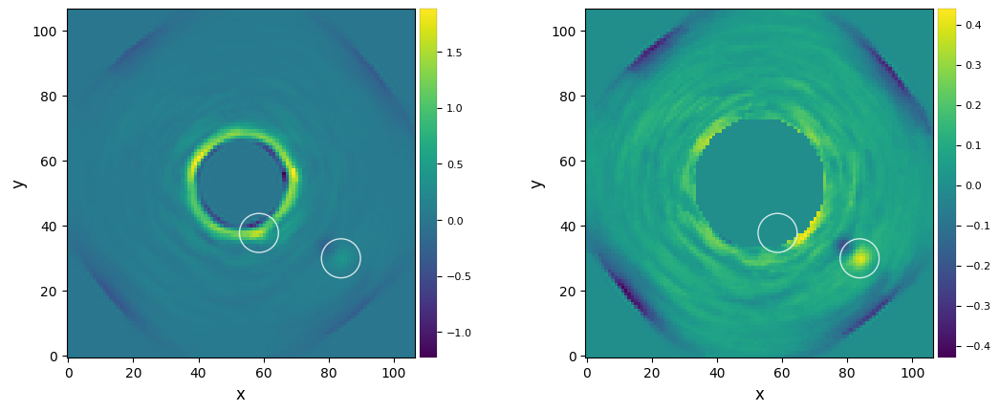

In [41]:
%matplotlib inline
plot_frames((pca_sdi, mask_circle(pca_sdi,20)),
            circle=(xy_b,xy_c))

In the first image, we notice the same effect as with median-SDI: significant stellar residuals at the edge of the coronagraphic mask.

On the other hand, fake planet c is easily re-detected. Notice the negative side lobe, that is reminiscent of ADI side lobes.

<font color=orange> **Question 7.1**: Why is the negative side lobe only radially inward of the planet in our final SDI image? </font>

This time the images obtained without and with flux-scaling applied to the cube before PCA appears to yield similar results. We note that flux scaling may actually have been slightly counter-productive, based on the raw fluxes at the location of the companion (peak value closer to ~0.4 without flux scaling, while closer to ~0.3 with flux scaling). Let's confirm that by measuring the SNR of c:

In [42]:
snr_c = snr(pca_sdi, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

13.016305973174017


#### 7.5.3.2. Annular PCA

PCA-SDI can also be performed in concentric annuli using `psfsub.pca_annular`. Again let's demonstrate whether flux scaling is useful or not:

In [43]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)
fwhm_m = np.mean(fwhm)

pca_sdi_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, 
                          ncomp=(ncomp_sdi,None), radius_int=mask_px, fwhm=fwhm_m, asize=fwhm_m,
                          delta_sep=(0.4, 1), delta_rot=(0.5, 1),
                          mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:39:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:02:39.790005
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Skipping the second PCA subtraction


We mask the central part of the image, dominated by residual stellar light, to only focus on planet c:

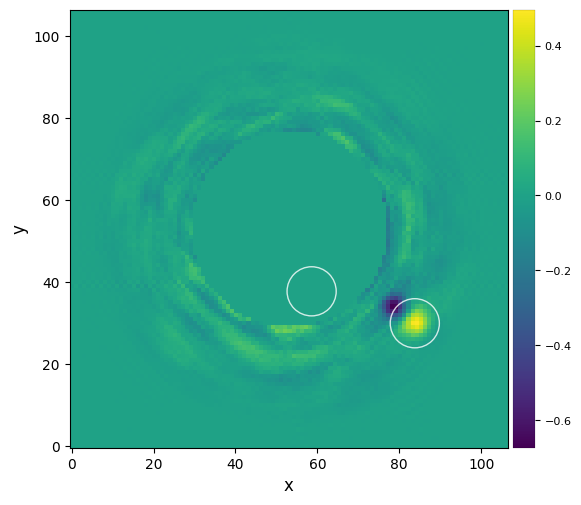

In [44]:
plot_frames(mask_circle(pca_sdi_ann, int(0.18/plsc)), circle=(xy_b,xy_c))

In [45]:
snr_c = snr(pca_sdi_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

16.071668104095398


Despite both reductions yielding relatively similar final images, we note that flux-scaling is slightly counter-productive (SNR slightly lower), similarly to the full-frame PCA reduction.

### 7.5.4. median-ASDI

Let's now combine both SDI and ADI, which should yield a better subtraction of the stellar residuals. Again, let's start with the most basic way to combine both strategies: median-ASDI. 

This simply involves the same calls to `median_sub` as in Sec. [7.5.2.](#7.5.2.-median-SDI), but removing `sdi_only=True`:

In [46]:
mask_px = int(0.1/plsc)

med_ASDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med,
                      radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:42:11
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:30.957841
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:35.460381
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's check the ASDI image:

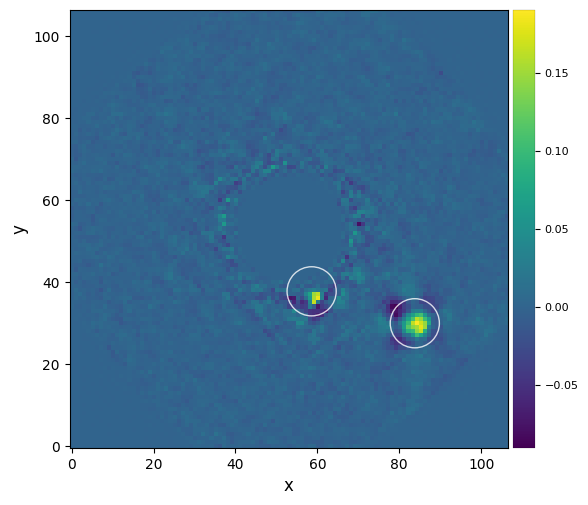

In [47]:
%matplotlib inline
plot_frames(med_ASDI, circle=(xy_b,xy_c))

This time we find signal at the location of fake planet b - although it does appear significantly filtered.

Fake planet c is easily redetected. Let's measure the signal-to-noise ratio for both fake planets:

In [48]:
snr_b = snr(med_SDI, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

0.9096708138344058
19.817929423515157


### 7.5.5. PCA-ASDI

#### 7.5.4.1. Full-frame PCA-ASDI (single step)

The ``psfsub.pca`` function in `VIP` offers the possibility to do this in either a single or 2 consecutive steps. 

In the first case, a master PCA library is created with all images acquires at different parallactic angles and at different wavelengths (i.e. containing both angular and radial diversity). This is done by setting:

- `adimsdi='single'` (default);
- `ncomp` to a scalar value (integer to use that number of principal components, or float betweeb 0 and 1 to indicate the desired cumulative explained variance ratio).

In [49]:
ncomp = 6
pca_asdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                adimsdi='single', crop_ifs=False, mask_center_px=mask_px,
                interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:42:47
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 0.714 GB
Rescaling the spectral channels to align the speckles
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:14
Running time:  0:00:14.913639
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
2145 total frames
Performing single-pass PCA
Done vectorizing the frames. Matrix shape: (2145, 22201)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:03:22.630326
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Descaling the spectral channels
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:08
De-rotating and combining residuals
Running time:  0:03:31.259490
―――――――――――――――――――――――――――――――――――――――――――――――――――

Let's visualize the resulting image, including circles at the ground truth locations of the injected planets:

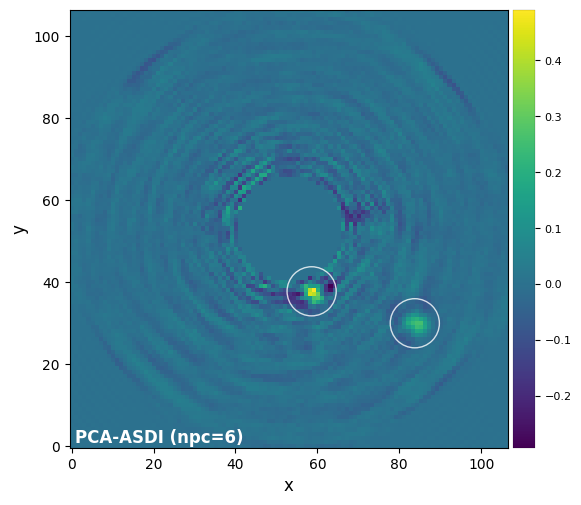

In [50]:
plot_frames(pca_asdi, label='PCA-ASDI (npc={:.0f})'.format(ncomp),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [51]:
snr_b = snr(pca_asdi, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_asdi, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

5.619268762575455
27.68203685221518


Again we notice that pre-scaling the cube before PCA does not help with the detections.

#### 7.5.4.2. Full-frame PCA-ASDI (double step)

The second option consists in performing PCA-SDI first, and then PCA-ADI on the cube consisting of SDI frames obtained for each individual spectral cube. This mode can be activated by setting `adimsdi='double'` (instead of the default 'single' value):

In [52]:
ncomp = (1,1)
pca_asdi_2s = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                adimsdi='double', crop_ifs=False, mask_center_px=mask_px,
                interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:46:22
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 1.181 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:01:08.316980
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA stage exploiting rotational variability
De-rotating and combining residuals
Running time:  0:01:12.588869
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


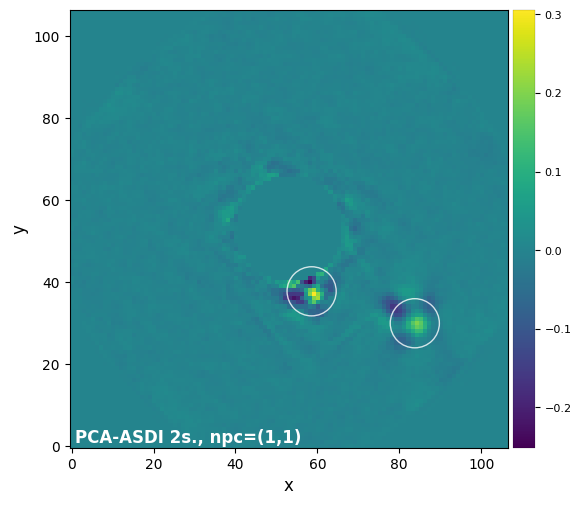

In [53]:
plot_frames(pca_asdi_2s,
            label='PCA-ASDI 2s., npc=({:.0f},{})'.format(ncomp[0],ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [54]:
snr_b = snr(pca_asdi_2s, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_asdi_2s, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

5.0778823844907235
50.36533166314871


#### 7.5.4.3. Annular PCA-ASDI (double step) 

In [55]:
ncomp = (1,1)
pca_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                      radius_int=mask_px, fwhm=np.mean(fwhm), asize=np.mean(fwhm), 
                      mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 01:47:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:22:43.853967
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA subtraction exploiting the angular variability
N annuli = 6, FWHM = 6.000
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  2.15    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:23:00.757464
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  4.36    Ann center:  22    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:23:13.401731
―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

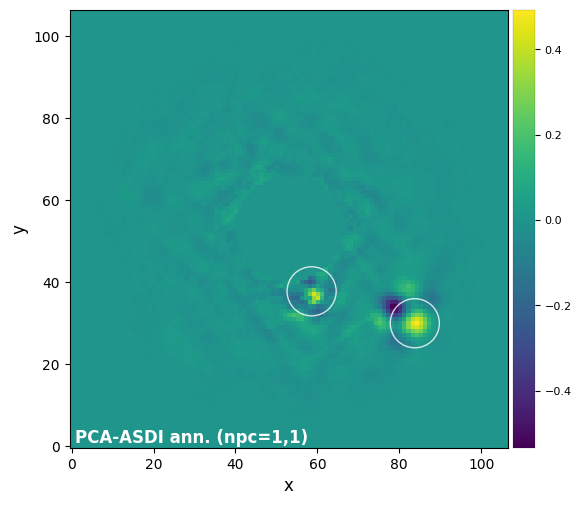

In [56]:
plot_frames(pca_ann, label='PCA-ASDI ann. (npc={:.0f},{:.0f})'.format(ncomp[0], ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [57]:
snr_b = snr(pca_ann, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

7.470215117063276
38.30967444038134


In [58]:
sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

4.753149970912784
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


### 7.5.6. PCA-ADI for all spectral channels

If you provide a 4d input cube without `scale_list` to the `pca` or `pca_annular` functions, their default behaviour will be to perform PCA-ADI on each spectral channel and then combine the final ADI images from each spectral channel into a single one. 

In [59]:
mask_px = int(0.08/plsc)

Let's try different flavours of PCA. First let's run it in full frames:

In [60]:
ncomp_ff = 6
pca_adi_mean = pca(cube_fc, derot_angles, ncomp=ncomp_ff, adimsdi='single', mask_center_px=mask_px,
                   interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:11:15
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 0.715 GB
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.432250
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:03.057175
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:03.652544
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:06.263238
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55

Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:01:15.558264
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:01:18.181933
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:01:18.928385
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:01:21.552550
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:01:22.220458
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:01:24.830750
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the

Now in concentric annuli, with a PA threshold (set by `delta_rot`):

In [61]:
ncomp_ann = 4
pca_adi_ann_mean = pca_annular(cube_fc, derot_angles, ncomp=ncomp_ann, radius_int=mask_px, 
                               fwhm=np.mean(fwhm), asize=2*np.mean(fwhm), delta_rot=(0.2,1),
                               mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:13:55
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:43.174966
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:10.588906
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:30.268961
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:01:33.845001
――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:05:52.966614
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:06:00.705006
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:06:07.309828
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:06:09.804348
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:06:26.107032
―――――――――――――――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:09:46.504212
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:09:49.108582
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:09:57.345131
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:10:02.479730
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:10:04.688715
―――――――――――――――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:12:30.540238
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:12:35.701615
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:12:38.357554
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:12:40.923732
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:12:44.428328
―――――――――――――――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:14:28.103359
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:14:30.603843
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:14:33.216815
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:14:34.944250
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:14:36.317692
―――――――――――――――――――――――――――――――――――――――――――――

Finally, let's also run it as a single wide annulus including both injected planets:

In [62]:
ncomp_a = 3
pca_adi_a_mean = pca_annulus(cube_fc, derot_angles, ncomp=ncomp_a, r_guess=(r_b+r_c)/2, 
                           annulus_width=r_c, mask_val=0, interp_zeros=True)

Let's compare the results:

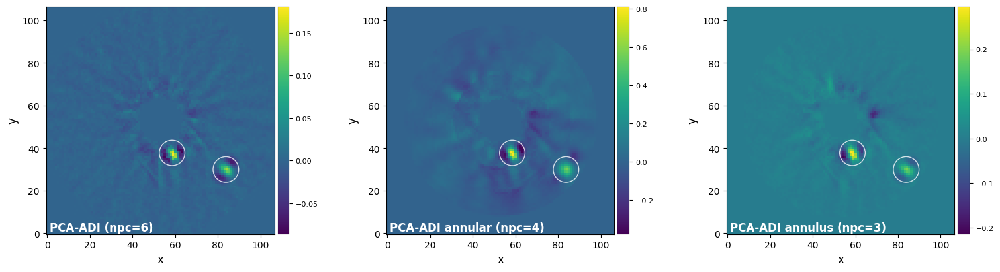

In [63]:
plot_frames((pca_adi_mean, pca_adi_ann_mean, pca_adi_a_mean),
            label=('PCA-ADI (npc={:.0f})'.format(ncomp_ff),
                   'PCA-ADI annular (npc={:.0f})'.format(ncomp_ann),
                   'PCA-ADI annulus (npc={:.0f})'.format(ncomp_a)),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [64]:
snr_b_ff = snr(pca_adi_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_ann = snr(pca_adi_ann_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_a = snr(pca_adi_a_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b_ff, snr_b_ann, snr_b_a)
snr_b = max(snr_b_ff, snr_b_ann, snr_b_a)

snr_c_ff = snr(pca_adi_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_ann = snr(pca_adi_ann_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_a = snr(pca_adi_a_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c_ff, snr_c_ann, snr_c_a)
snr_c = max(snr_c_ff, snr_c_ann, snr_c_a)

9.935243599527908 6.209986724918728 4.704459026815971
31.48109617062875 11.398186426969303 24.70475296809838


In [65]:
sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

5.433364722813859
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


In this case, we see that ADI alone recovers better the innermost planet. This is because of the bright stellar residuals at the edge of the coronagraphic mask, preventing SDI to do a good job at good separation.

<font color=green> **Answer 7.1**: The scaling factors are such that all spectral channels are upscaled, for the stellar halo to match the last spectral channel, i.e. all factors are >= 1 (exactly 1 for the last spectral channel). The PSF model and subtraction with PCA is then made with these upscaled images, where the planet is now present at different radial separations. However since we injected a very red spectrum for planet c (blackbody of 1100 K), it is the brightest in the last spectral channels. This means the strongest positive (resp. negative) imprint will be in the long (resp. short) wavelength channels, where the planet was not moved (resp. moved radially outward), i.e. the positive (resp. negative) imprint is unchanged (resp. radially inward) with respect to its position in the upscaled cube. After final downscaling, the negative imprint stays thus radially inward from the location of the fake planet. 
You can test this explanation by injecting a blue spectrum for planet c (e.g. 1/blackbody). </font>

## 7.6. Astrometry retrieval

The `firstguess` function can accept a 4D input cube to infer a first guess on the position (a single one for all channels) and fluxes (one per channel). Since it would be very slow to run it on all 39 spectral channels, let's just focus on the 8 channels (~20% of all channels) with the maximum S/N ratio. Let's find these channels for planet c. 

As the rest of this tutorial is CPU-intensive, **we will only focus on planet c** - although the same procedure can be applied to planet b.

### 7.6.1. Spectral channels with maximum SNR

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:19
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.172078
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=1.380
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.213
Central pixel S/N = 1.124
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 1.375
Max S/N (shifting the aperture center) = 2.200
stddev S/N (shifting the aperture center) = 0.565

Opt SNR: 1.3801916275528059, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starti

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.308261
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=3.570
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.134
Central pixel S/N = 4.537
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.582
Max S/N (shifting the aperture center) = 4.669
stddev S/N (shifting the aperture center) = 0.761

Opt SNR: 3.569572865199436, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:21
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.150355
―――――――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.384
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.378
Central pixel S/N = 3.798
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.380
Max S/N (shifting the aperture center) = 4.865
stddev S/N (shifting the aperture center) = 0.671

Opt SNR: 3.3843922448871435, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:23
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.172274
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=3.538
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.718
Central pixel S/N = 4.374
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.554
Max S/N (shifting the aperture center) = 4.297
stddev S/N (shifting the aperture center) = 0.503

Opt SNR: 3.5377834729055544, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:24
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.139424
――――――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.486
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.989
Central pixel S/N = 4.425
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.488
Max S/N (shifting the aperture center) = 4.297
stddev S/N (shifting the aperture center) = 0.507

Opt SNR: 3.4860830354309655, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:25
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.163984
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=3.913
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.236
Central pixel S/N = 4.852
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.906
Max S/N (shifting the aperture center) = 4.805
stddev S/N (shifting the aperture center) = 0.594

Opt SNR: 3.9129844764200956, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:26
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.153451
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=3.632
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.046
Central pixel S/N = 4.416
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.601
Max S/N (shifting the aperture center) = 4.576
stddev S/N (shifting the aperture center) = 0.568

Opt SNR: 3.6323039929489287, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.181829
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=4.143
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.449
Central pixel S/N = 5.386
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.148
Max S/N (shifting the aperture center) = 5.303
stddev S/N (shifting the aperture center) = 0.670

Opt SNR: 4.143193729826148, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:29
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.156198
―――――――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.457
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.664
Central pixel S/N = 5.837
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.441
Max S/N (shifting the aperture center) = 5.895
stddev S/N (shifting the aperture center) = 0.880

Opt SNR: 4.457385421253395, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:30
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.135272
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.096
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.551
Central pixel S/N = 5.117
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.025
Max S/N (shifting the aperture center) = 5.454
stddev S/N (shifting the aperture center) = 0.851

Opt SNR: 4.095758083355251, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:31
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.159990
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.282
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.074
Central pixel S/N = 5.362
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.252
Max S/N (shifting the aperture center) = 5.566
stddev S/N (shifting the aperture center) = 0.937

Opt SNR: 4.281749743702011, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:33
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.143358
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=4.445
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.997
Central pixel S/N = 5.858
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.115
Max S/N (shifting the aperture center) = 6.379
stddev S/N (shifting the aperture center) = 1.112

Opt SNR: 4.444589215208261, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:34
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.150985
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=5.324
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.983
Central pixel S/N = 6.557
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.820
Max S/N (shifting the aperture center) = 7.051
stddev S/N (shifting the aperture center) = 1.409

Opt SNR: 5.323671172061005, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.151040
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=6.188
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.252
Central pixel S/N = 7.141
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.329
Max S/N (shifting the aperture center) = 7.451
stddev S/N (shifting the aperture center) = 1.474

Opt SNR: 6.1879143028055115, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:36
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.142978
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 6, for S/N=6.063
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.062
Central pixel S/N = 7.120
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.028
Max S/N (shifting the aperture center) = 7.533
stddev S/N (shifting the aperture center) = 1.633

Opt SNR: 6.063078806745727, for npc=6
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:38
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.163677
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 7, for S/N=7.297
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.233
Central pixel S/N = 8.846
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.376
Max S/N (shifting the aperture center) = 9.764
stddev S/N (shifting the aperture center) = 1.999

Opt SNR: 7.297307899668932, for npc=7
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:39
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.160687
―――――――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=5.542
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.950
Central pixel S/N = 7.021
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.521
Max S/N (shifting the aperture center) = 8.210
stddev S/N (shifting the aperture center) = 1.461

Opt SNR: 5.542426844570617, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:40
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.148090
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.976
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.305
Central pixel S/N = 5.791
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.041
Max S/N (shifting the aperture center) = 7.733
stddev S/N (shifting the aperture center) = 1.357

Opt SNR: 4.976408389408834, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:41
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.162430
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.888
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.248
Central pixel S/N = 6.085
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.908
Max S/N (shifting the aperture center) = 7.287
stddev S/N (shifting the aperture center) = 1.327

Opt SNR: 4.887618306863193, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:42
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.171271
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 2, for S/N=6.132
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.768
Central pixel S/N = 8.101
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.968
Max S/N (shifting the aperture center) = 8.960
stddev S/N (shifting the aperture center) = 1.641

Opt SNR: 6.131787040588891, for npc=2
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:44
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.163084
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=7.050
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.945
Central pixel S/N = 8.241
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.651
Max S/N (shifting the aperture center) = 9.537
stddev S/N (shifting the aperture center) = 1.668

Opt SNR: 7.05004660935525, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/Users/valentin/GitHub/VIP/vip_hci/psfsub/utils_pca.py:378: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=vip_figsize, dpi=vip_figdpi)
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.161692
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=8.520
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.583
Central pixel S/N = 9.774
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 7.872
Max S/N (shifting the aperture center) = 12.441
stddev S/N (shifting the aperture center) = 2.382

Opt SNR: 8.51991694741128, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:46
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.177536
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 4, for S/N=10.523
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.150
Central pixel S/N = 12.074
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.799
Max S/N (shifting the aperture center) = 12.193
stddev S/N (shifting the aperture center) = 2.371

Opt SNR: 10.522543185354458, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:48
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.141425
―――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=10.808
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.420
Central pixel S/N = 12.540
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.680
Max S/N (shifting the aperture center) = 12.377
stddev S/N (shifting the aperture center) = 2.430

Opt SNR: 10.8078900868622, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:49
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.141612
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=13.470
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.973
Central pixel S/N = 13.874
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.462
Max S/N (shifting the aperture center) = 14.511
stddev S/N (shifting the aperture center) = 2.743

Opt SNR: 13.469995229225095, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:50
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.158984
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=11.545
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.677
Central pixel S/N = 13.461
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.936
Max S/N (shifting the aperture center) = 13.917
stddev S/N (shifting the aperture center) = 3.185

Opt SNR: 11.54528352825929, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:51
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.194780
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 5, for S/N=12.399
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.907
Central pixel S/N = 14.168
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 9.529
Max S/N (shifting the aperture center) = 14.563
stddev S/N (shifting the aperture center) = 3.334

Opt SNR: 12.399403452618305, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:53
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.172081
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 5, for S/N=14.401
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.256
Central pixel S/N = 14.394
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.335
Max S/N (shifting the aperture center) = 16.271
stddev S/N (shifting the aperture center) = 3.354

Opt SNR: 14.400880849221048, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:54
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.145335
――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=15.905
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.374
Central pixel S/N = 13.677
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.019
Max S/N (shifting the aperture center) = 14.897
stddev S/N (shifting the aperture center) = 3.339

Opt SNR: 15.905222243634217, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:55
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.157516
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 5, for S/N=16.850
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.725
Central pixel S/N = 13.695
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.344
Max S/N (shifting the aperture center) = 15.549
stddev S/N (shifting the aperture center) = 3.404

Opt SNR: 16.85041666766923, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:56
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.187688
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 5, for S/N=18.350
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.657
Central pixel S/N = 13.588
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.839
Max S/N (shifting the aperture center) = 16.412
stddev S/N (shifting the aperture center) = 3.782

Opt SNR: 18.350086921277214, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:58
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.161833
――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=17.783
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 4.466
Central pixel S/N = 17.643
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 12.036
Max S/N (shifting the aperture center) = 18.667
stddev S/N (shifting the aperture center) = 3.600

Opt SNR: 17.783140514296875, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:30:59
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.156582
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=18.553
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.253
Central pixel S/N = 18.294
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 12.658
Max S/N (shifting the aperture center) = 18.712
stddev S/N (shifting the aperture center) = 3.802

Opt SNR: 18.55268571440183, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:31:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.169687
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=19.464
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.656
Central pixel S/N = 17.124
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.872
Max S/N (shifting the aperture center) = 18.229
stddev S/N (shifting the aperture center) = 3.599

Opt SNR: 19.463793274816332, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:31:02
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.157480
――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=21.409
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 5.131
Central pixel S/N = 18.370
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 13.538
Max S/N (shifting the aperture center) = 22.127
stddev S/N (shifting the aperture center) = 4.682

Opt SNR: 21.408706896724635, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:31:03
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.160721
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=20.230
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.500
Central pixel S/N = 16.489
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.942
Max S/N (shifting the aperture center) = 18.383
stddev S/N (shifting the aperture center) = 3.846

Opt SNR: 20.22991160189573, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:31:04
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.162431
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=19.659
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 16.885
Central pixel S/N = 21.916
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 16.410
Max S/N (shifting the aperture center) = 22.823
stddev S/N (shifting the aperture center) = 4.146

Opt SNR: 19.65899244349856, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:31:06
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.139186
――――――――――――――――

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=20.985
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 15.664
Central pixel S/N = 24.092
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 17.044
Max S/N (shifting the aperture center) = 24.572
stddev S/N (shifting the aperture center) = 4.642

Opt SNR: 20.985161521318123, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:31:07
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.147639
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 2, for S/N=23.447
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.526
Central pixel S/N = 14.151
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 14.491
Max S/N (shifting the aperture center) = 19.392
stddev S/N (shifting the aperture center) = 3.315

Opt SNR: 23.446658828695938, for npc=2


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_20804/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


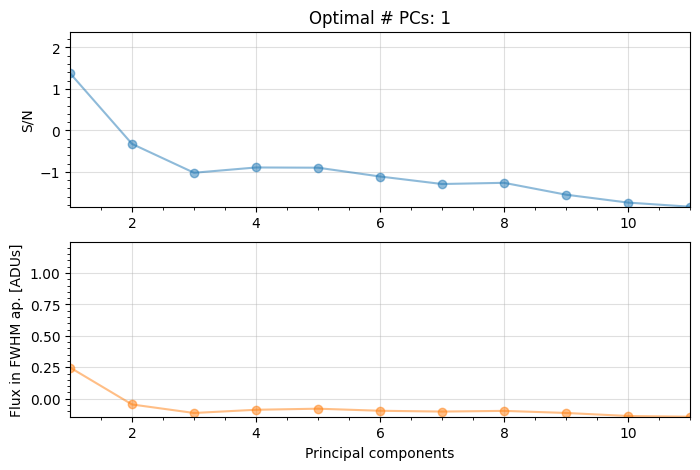

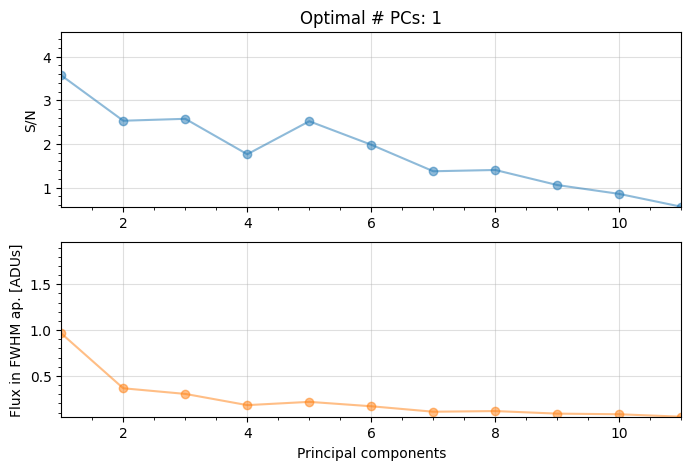

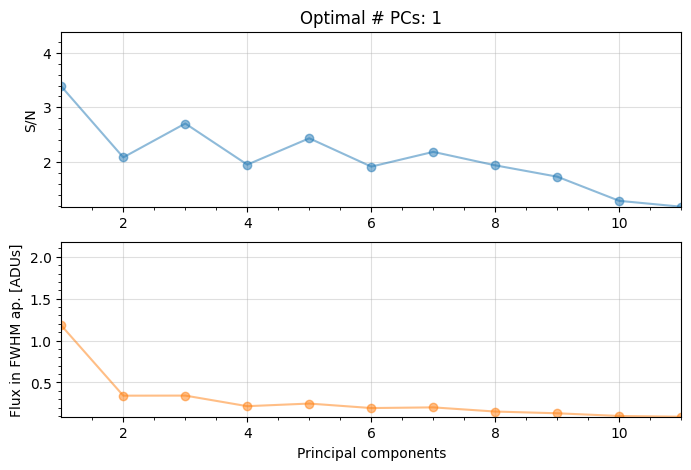

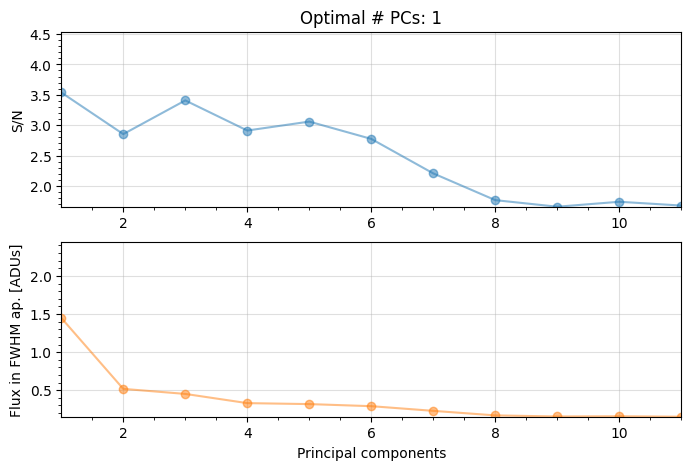

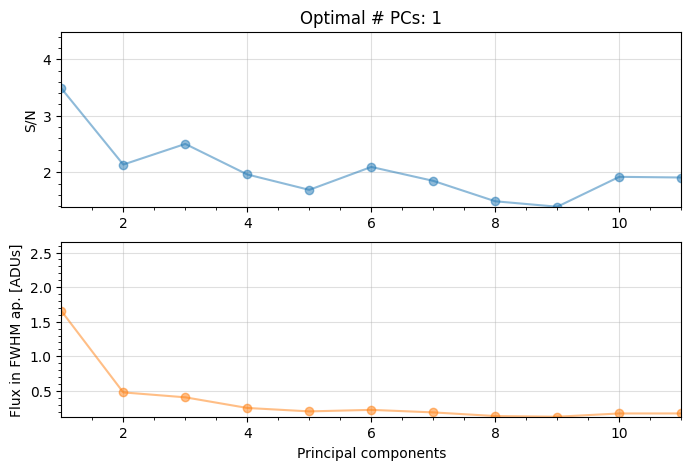

...

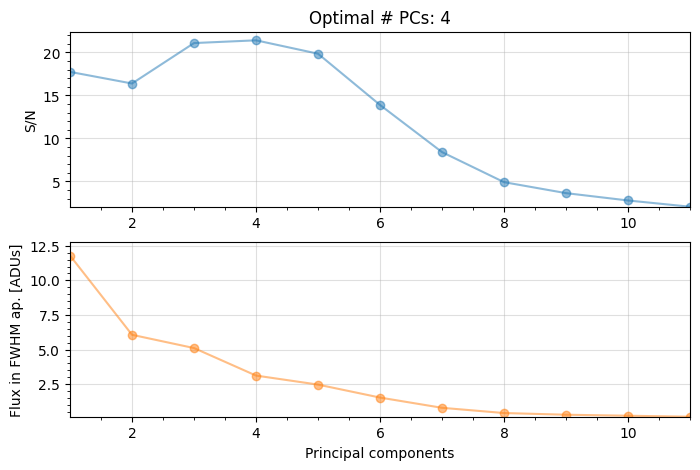

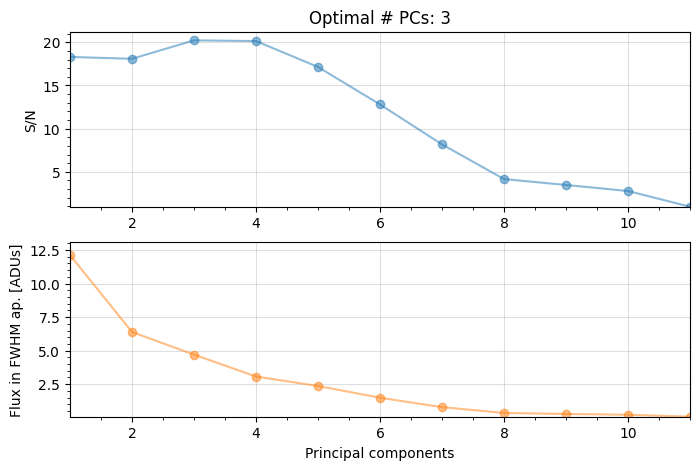

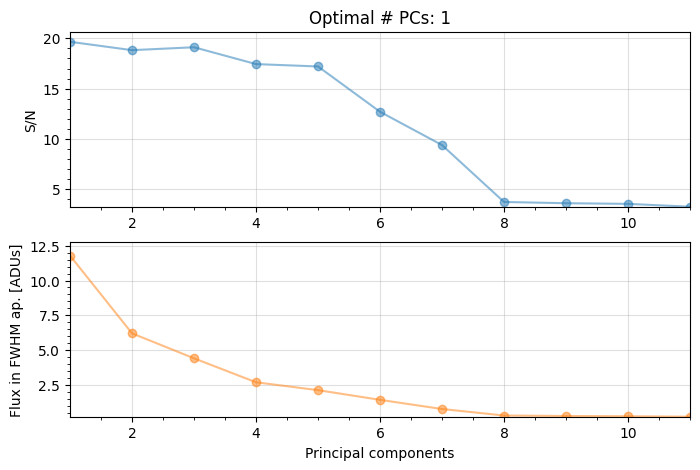

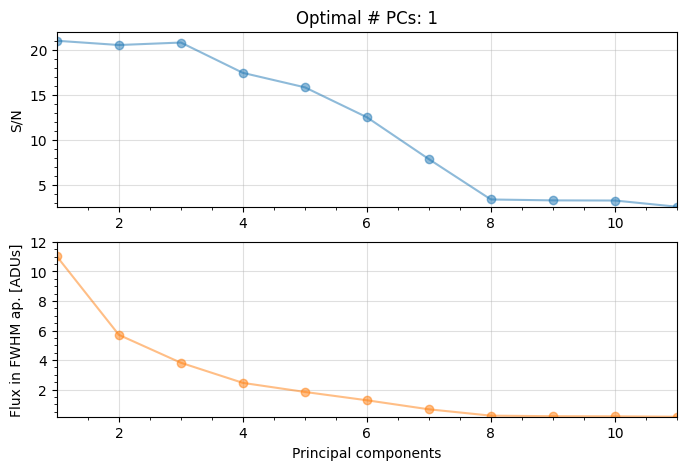

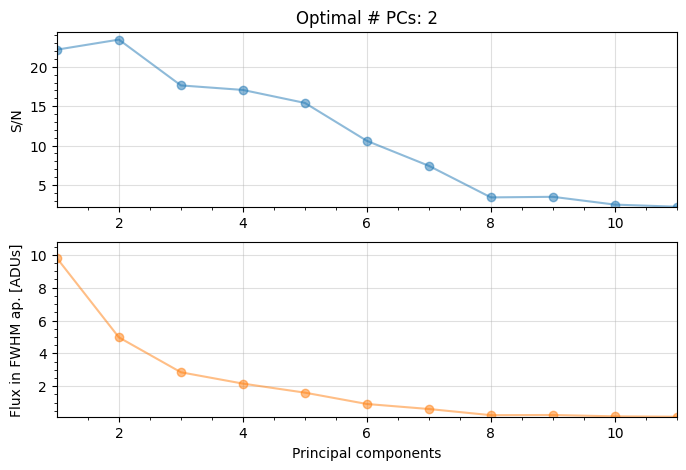

In [66]:
all_frs = []
all_snrs = []
all_pcs = []
for i in range(nch):
    res_ann_opt = pca_grid(cube_fc[i], derot_angles, fwhm=fwhm[i], range_pcs=(1,11,1), 
                           source_xy=xy_c, mode='annular', annulus_width=int(4*fwhm[i]), 
                           imlib='opencv', full_output=True, plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, df, opt_npc_ann = res_ann_opt
    all_frs.append(final_ann_opt)
    pcs = df['PCs']
    snrs = df['S/Ns']
    opt_snr = snrs[df.index[pcs==opt_npc_ann]]
    print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
    all_snrs.append(float(opt_snr))
    all_pcs.append(opt_npc_ann)

Let's plot the results:

Text(0, 0.5, 'SNR of c')

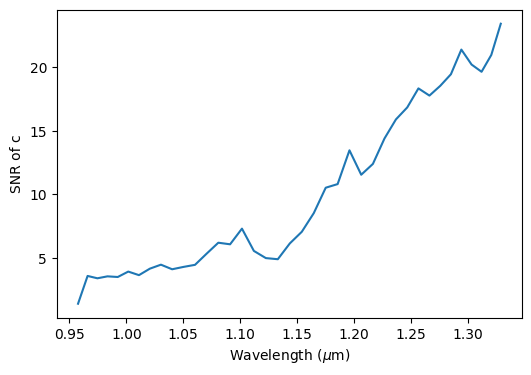

In [67]:
plt.figure(figsize=(6,4))
plt.plot(lbda, all_snrs)
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("SNR of c")

Let's (reverse) sort to only keep the best 8 channels:

In [68]:
order_snr = np.flip(np.argsort(all_snrs))
sorted_npc = np.array(all_pcs)[order_snr]
sorted_ch = np.arange(nch)[order_snr]
sorted_frs = np.array(all_frs)[order_snr]
sorted_snr = np.array(all_snrs)[order_snr]

Let's finally show these 8 channels with optimal SNR:

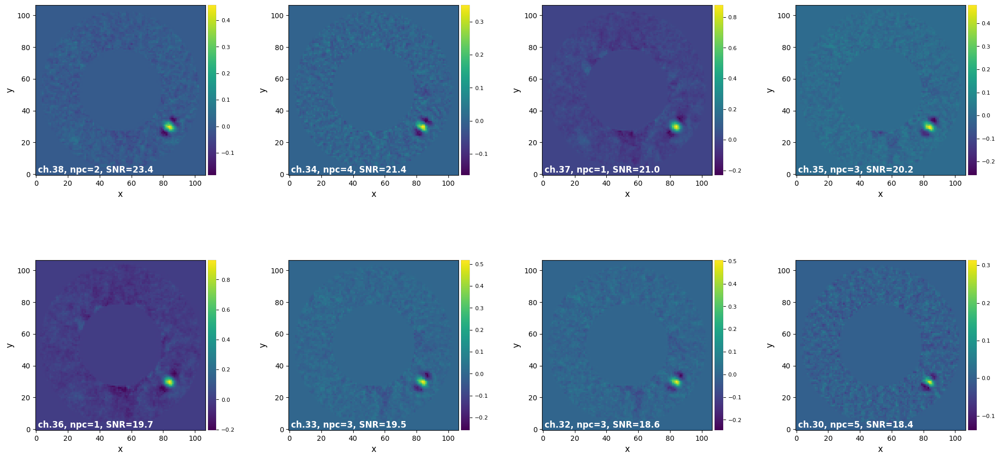

In [69]:
cutoff = 8
final_frs_c = tuple(sorted_frs[:cutoff])
final_chs_c = sorted_ch[:cutoff]
final_npcs_c = sorted_npc[:cutoff]

labels = ['ch.{}, npc={}, SNR={:.1f}'.format(final_chs_c[i], final_npcs_c[i], sorted_snr[i]) for i in range(cutoff)]
labels = tuple(labels)

plot_frames(final_frs_c, label=labels, rows=2)

### 7.6.2. NEGFC+PCA-ADI (simplex)

Let's now find the optimal position of planet c by running the `firstguess` function on the 8 best spectral channels (corresponding to the highest SNR, as determined above):

In [70]:
crop_cube_c = cube_fc[final_chs_c]
crop_cube_c.shape

(8, 55, 107, 107)

In [71]:
psfn_crop_c = psfn[final_chs_c]

In [72]:
trans_crop_c = [trans[0]]
for i in final_chs_c:
    trans_crop_c.append(trans[i])
trans_crop_c = np.array(trans_crop_c)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 02:31:20
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.8,29.9], running ...
Processing spectral channel 0...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 1...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.5)
Processing spectral channel 2...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 3...
... optimal grid flux: 38.566 ($\chi^2_r$ = 1.4)
Processing spectral channel 4...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 5...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 6...
... optimal gr

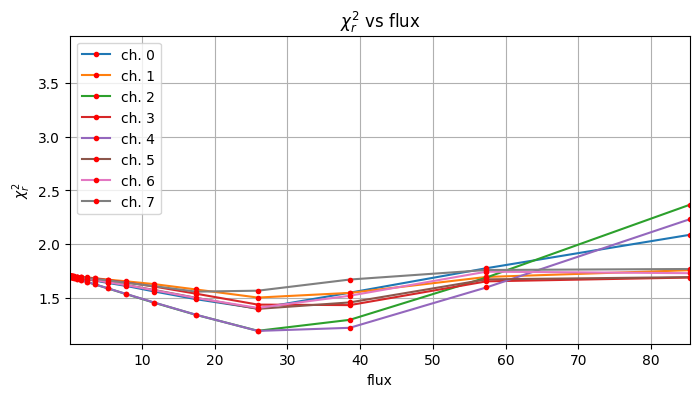

Planet 0: preliminary position guess: (r, theta)=(38.5, 323.1)
Planet 0: preliminary flux guess: 25.9, 25.9, 25.9, 38.6, 25.9, 25.9, 25.9, 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 446, nfev: 821, chi2r: 0.08853499430766378
message: Optimization terminated successfully.
Planet 0: simplex result: (r, theta, f0, f1, f2, f3, f4, f5, f6, f7)=(25.571, 23.625, 29.279, 31.809, 31.204, 29.231, 27.062, 17.118) at 
          (X,Y)=(83.77, 29.95)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:29:30.002549
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


In [73]:
res = firstguess(crop_cube_c, derot_angles, psfn_crop_c, ncomp=list(final_npcs_c),
                 planets_xy_coord=[xy_c], fwhm=np.mean(fwhm), annulus_width=int(4*np.mean(fwhm)),
                 aperture_radius=2, imlib='opencv', transmission=trans_crop_c, mu_sigma=True, 
                 force_rPA=False, simplex=True, plot=True, verbose=True)
r0c = res[0]
theta0c = res[1]
fluxes0c = res[2]

In [74]:
res

(array([38.448522]),
 array([323.1687874]),
 array([[25.57130164, 23.62535398, 29.27905427, 31.80925639, 31.20381454,
         29.23071464, 27.06177037, 17.11751566]]))

Let's compare the estimates to their respective ground truth values:

In [75]:
print("r (gt): {:.2f} VS. r (estimated): {:.2f}".format(r_c, r0c[0]))
print("theta (gt): {:.2f} VS. r (estimated): {:.2f}".format(theta_c%360, theta0c[0]))
for i, ch in enumerate(final_chs_c):
    print("flux ch.{} (gt): {:.2f} VS. r (estimated): {:.2f}".format(ch, flux_c_scal[ch], fluxes0c[0,i]))

r (gt): 38.50 VS. r (estimated): 38.45
theta (gt): 323.13 VS. r (estimated): 323.17
flux ch.38 (gt): 24.66 VS. r (estimated): 25.57
flux ch.34 (gt): 29.42 VS. r (estimated): 23.63
flux ch.37 (gt): 28.25 VS. r (estimated): 29.28
flux ch.35 (gt): 30.51 VS. r (estimated): 31.81
flux ch.36 (gt): 30.09 VS. r (estimated): 31.20
flux ch.33 (gt): 27.34 VS. r (estimated): 29.23
flux ch.32 (gt): 25.13 VS. r (estimated): 27.06
flux ch.30 (gt): 22.10 VS. r (estimated): 17.12


### 7.6.3. NEGFC+PCA-ADI (MCMC)

A better, albeit slower way, to infer the astrometry of each planet with uncertainties is to use an MCMC approach. Our specific case can be solved with the `mcmc_negfc_sampling`, which can, since VIP v1.2.3, also deal with 4D cubes. We refer to tutorial 5 for more details on how to set up the parameters for the MCMC algorithm.

In [76]:
import pickle

lab='c'
ann_width = 4*np.mean(fwhm)
aperture_radius=2
imlib_rot='opencv'
interpolation = 'lanczos4'
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib_rot, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': 2}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

Note that when the flux variation is known throughout the observation (e.g. through a background star or satellite spots) or if you wish to take into account the effect of airmass, it is possible to provide a `weights` parameter for the injection of the mean flux to be scaled at the moment of injection in each image to follow in (this is a new addition since [Christiaens et al. 2021](https://ui.adsabs.harvard.edu/abs/2021MNRAS.502.6117C/abstract)).

In [77]:
weights=X_fac

In [78]:
# input to MCMC
init = [r0c[0], theta0c[0]]
for i in range(cutoff):
    init.append(fluxes0c[0,i])
initial_state = np.array(init)
obs_params['psfn']= psfn[final_chs_c]
obs_params['fwhm']= np.mean(fwhm[final_chs_c]) # REPLACE AFTER DEALING WITH FWHM format
obs_params['transmission']= trans_crop_c
algo_params['ncomp'] = list(final_npcs_c)

**Warning**: The following box is very computer intensive. It can be skipped if needed.

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 03:00:50
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean and stddev in the annulus at the radius of the companion (excluding the PA area directly adjacent to it) are -0.00 and 0.08 respectively.
Beginning emcee Ensemble sampler...
emcee Ensemble sampler successful

Start of the MCMC run ...
Step  |  Duration/step (sec)  |  Remaining Estimated Time (sec)
0		42.51746			21216.21404
1		42.41981			21125.06389
2		42.32732			21036.67804
3		42.39256			21026.70728
4		42.41644			20996.13879
5		42.39147			20941.38816
6		42.31432			20860.96173
7		42.42714			20874.15239
8		42.38404			20810.56560
9		42.32164			20737.60164
10		42.44019			20753.25438
11		42.39037			20686.50007
12		42.34000			20619.58049
13		42.38203			20597.

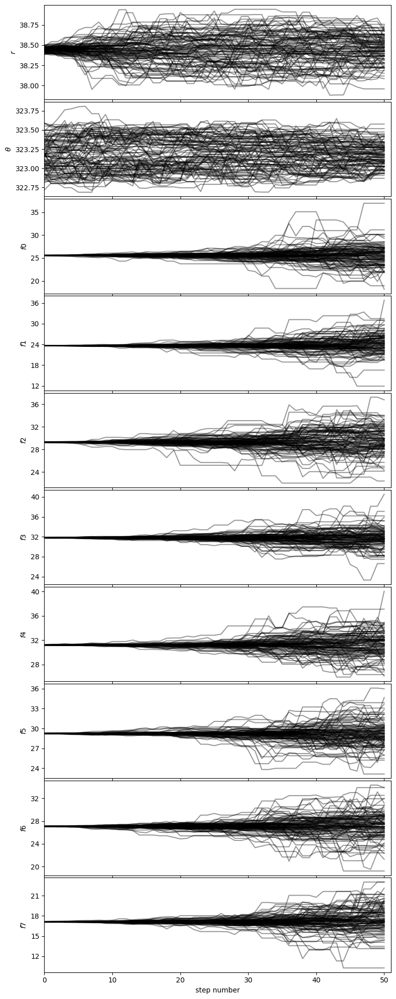

51		43.89956			19667.00154
52		42.40241			18953.87682
53		42.39427			18907.84442
54		42.36796			18853.74354
55		41.72260			18524.83573
56		42.39049			18778.98796
57		42.32541			18707.82901
58		42.45858			18724.23598
59		42.40125			18656.54824
60		42.33382			18584.54698
61		42.40555			18573.63309
62		42.37394			18517.40960
63		42.38599			18480.29077
64		41.58111			18087.78502
65		42.42695			18413.29500
66		42.42288			18369.10704
67		42.36767			18302.83344
68		41.64673			17949.74235
69		42.42120			18241.11557
70		42.31094			18151.39283
71		42.35410			18127.55394
72		42.40232			18105.78851
73		42.36386			18047.00521
74		42.31530			17984.00293
75		41.71230			17686.01562
76		42.36985			17922.44782
77		42.31474			17856.82155
78		41.68101			17547.70521
79		42.38214			17800.49880
80		42.37643			17755.72333
81		42.44260			17741.00513
82		42.40902			17684.56217
83		42.46848			17666.88726
84		42.33895			17570.66300
85		42.42040			17562.04477
86		42.43361			17525.08176
87		42.35026			17448.30836
8

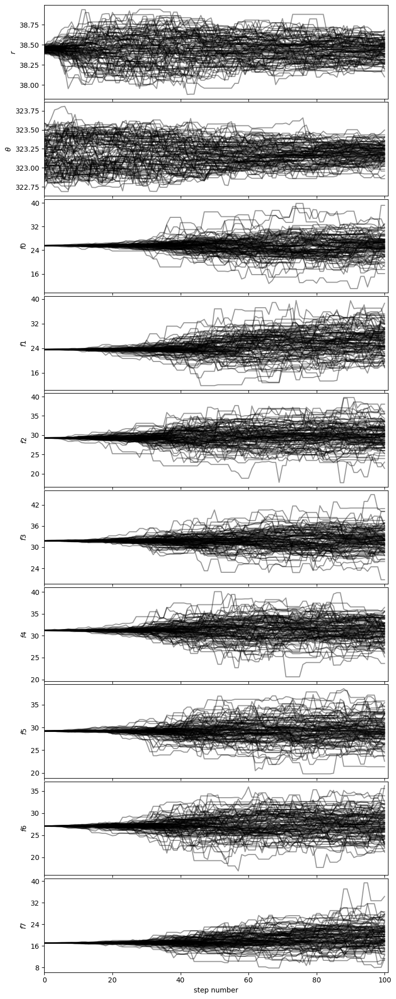

101		43.68780			17387.74440
102		42.39295			16830.00155
103		42.43447			16804.05012
104		42.31420			16714.11058
105		42.33873			16681.45923
106		41.68523			16382.29382
107		40.91506			16038.70313
108		42.35358			16560.24939
109		42.41128			16540.39881
110		42.37286			16483.04410
111		42.32706			16422.89967
112		42.39999			16408.79536
113		42.37245			16355.76724
114		41.60710			16018.73542
115		42.40740			16284.44275
116		41.61094			15936.98925
117		42.40746			16199.64934
118		42.30879			16119.64785
119		42.36574			16098.98158
120		42.43303			16082.11989
121		42.31276			15994.22215
122		42.42104			15992.73396
123		42.47743			15971.51218
124		41.65341			15620.02875
125		42.42182			15865.75993
126		41.82050			15599.04613
127		42.40554			15774.86125
128		41.65154			15452.72023
129		42.40760			15690.81237
130		42.38620			15640.50706
131		41.60334			15310.03096
132		41.64302			15282.98871
133		41.64664			15242.66951
134		41.61042			15187.80220
135		42.36074			15419.31009
136		42.38566			1538

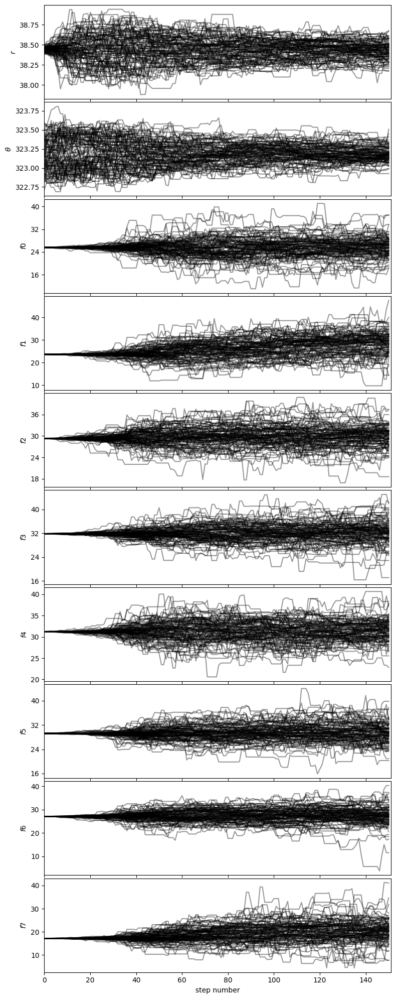

151		43.39010			15099.75376
152		41.68112			14463.34760
153		42.38761			14666.11341
154		40.82917			14086.06468
155		41.69949			14344.62525
156		41.83583			14349.69038
157		42.34181			14480.89834
158		40.21461			13713.18133
159		40.88479			13900.82758
160		40.83320			13842.45548
161		40.93258			13835.21305
162		40.17144			13537.77663
163		42.34638			14228.38301
164		41.66053			13956.27822
165		41.65131			13911.53620
166		40.20679			13388.86240
167		41.65544			13829.60575
168		41.69991			13802.66922
169		41.80721			13796.37963
170		42.36801			13939.07463
171		41.65457			13662.69765
172		41.67066			13626.30484
173		41.66451			13582.63059
174		40.19969			13064.90023
175		39.47696			12790.53472
176		42.31233			13666.88227
177		39.40577			12688.65730
178		40.96217			13148.85721
179		40.11863			12837.96192
180		40.93653			13058.75339
181		41.76227			13280.40313
182		40.99625			12995.80967
183		41.56069			13133.17899
184		40.92898			12892.62807
185		42.36898			13303.86066
186		42.34206			1325

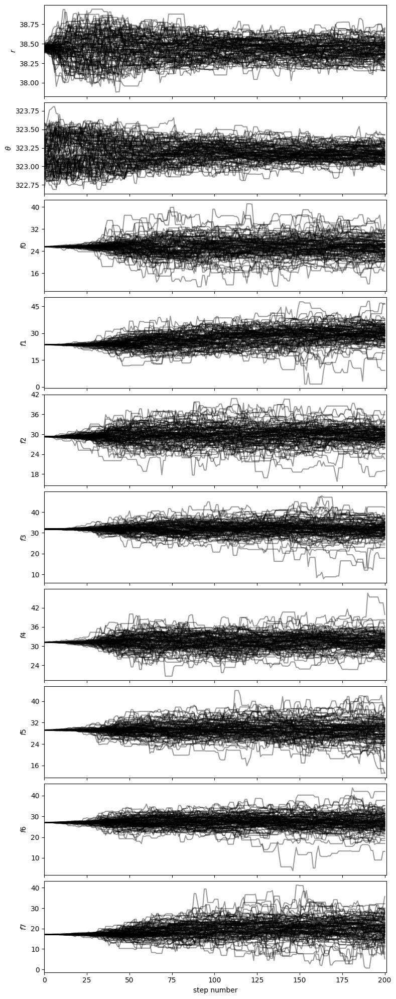

Auto-corr tau/N = [0.08920477 0.09084127 0.08070282 0.11058679 0.08019716 0.08514837
 0.08302614 0.08555765 0.08535995 0.09964724]
tau/N <= 0.02 = [False False False False False False False False False False] 

201		43.11478			12848.20355
202		41.58080			12349.49730
203		41.60100			12313.89659
204		42.39558			12506.69728
205		42.35307			12451.80140
206		42.32924			12402.46732
207		42.42435			12387.91020
208		42.37252			12330.40274
209		42.39836			12295.52440
210		42.49091			12279.87415
211		42.42594			12218.67158
212		41.02267			11773.50658
213		42.33813			12108.70632
214		41.66214			11873.70933
215		42.43076			12050.33556
216		41.60045			11772.92792
217		41.61955			11736.71423
218		40.95255			11507.66739
219		41.59538			11646.70528
220		42.37288			11822.03352
221		40.97527			11391.12450
222		41.59882			11522.87314
223		41.61226			11484.98459
224		41.67858			11461.61033
225		42.34690			11603.05087
226		41.55132			11343.51063
227		41.66285			11332.29411
228		42.33723			11473.38906
229		

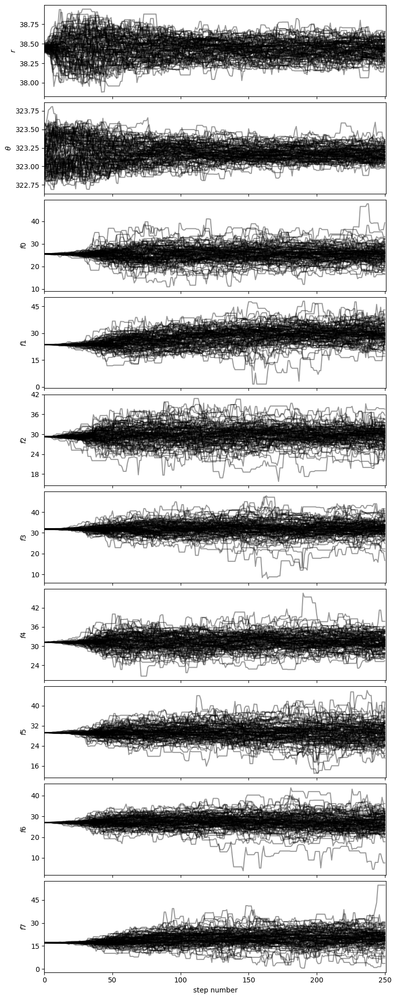

Auto-corr tau/N = [0.09030557 0.08967278 0.07890243 0.10651214 0.07710283 0.07952395
 0.0858965  0.08342434 0.0795758  0.09320014]
tau/N <= 0.02 = [False False False False False False False False False False] 

251		43.40613			10764.71999
252		41.65469			10288.70769
253		41.06675			10102.41952
254		41.01069			10047.61954
255		40.88115			9974.99987
256		41.73176			10140.81865
257		42.43233			10268.62459
258		42.41225			10221.35153
259		42.34788			10163.49192
260		41.60446			9943.46713
261		42.43663			10099.91699
262		41.68915			9880.32784
263		40.92760			9658.91454
264		41.68251			9795.38915
265		41.57673			9728.95576
266		42.43412			9887.15089
267		41.66076			9665.29586
268		42.31376			9774.47948
269		42.33502			9737.05460
270		42.40222			9710.10815
271		41.65926			9498.31242
272		41.57491			9437.50570
273		41.69476			9423.01553
274		42.37172			9533.63790
275		41.55331			9307.94256
276		42.42367			9460.47886
277		40.90734			9081.42948
278		41.59898			9193.37568
279		41.63361			9159.394

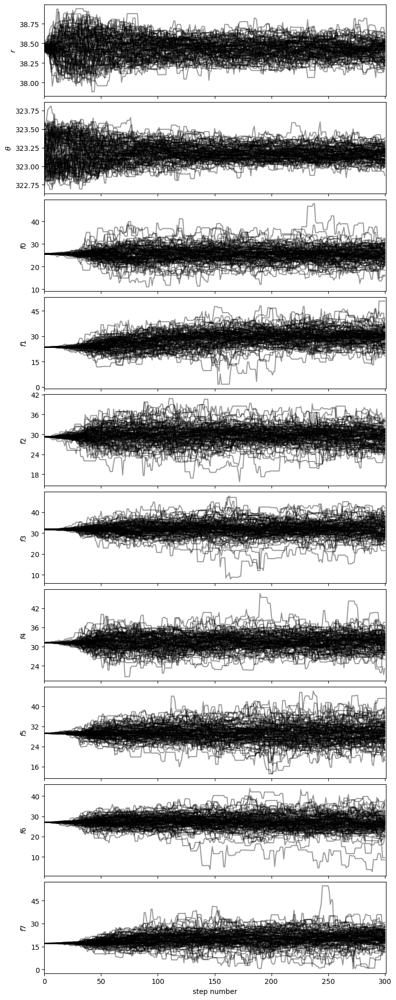

Auto-corr tau/N = [0.08626078 0.08558673 0.07704599 0.10018028 0.07220745 0.07769066
 0.08300508 0.07671402 0.07714248 0.09004502]
tau/N <= 0.02 = [False False False False False False False False False False] 

301		43.84168			8680.65304
302		42.49964			8372.42908
303		42.37093			8304.70248
304		42.37365			8262.86253
305		42.39796			8225.20385
306		42.33438			8170.53534
307		42.49999			8159.99789
308		42.30526			8080.30409
309		42.38945			8053.99474
310		41.67969			7877.46198
311		42.32160			7956.46099
312		42.32979			7915.67017
313		41.63167			7743.49081
314		41.59068			7694.27617
315		42.31806			7786.52230
316		42.42579			7763.91902
317		42.52009			7738.65693
318		42.32648			7661.09252
319		42.42911			7637.24052
320		42.34268			7579.33972
321		41.56555			7398.66808
322		41.66136			7374.06125
323		41.66264			7332.62394
324		40.87589			7153.28162
325		42.35989			7370.62103
326		41.66105			7207.36251
327		41.67180			7167.54960
328		42.31745			7236.28327
329		41.64285			7079.28450
330		4

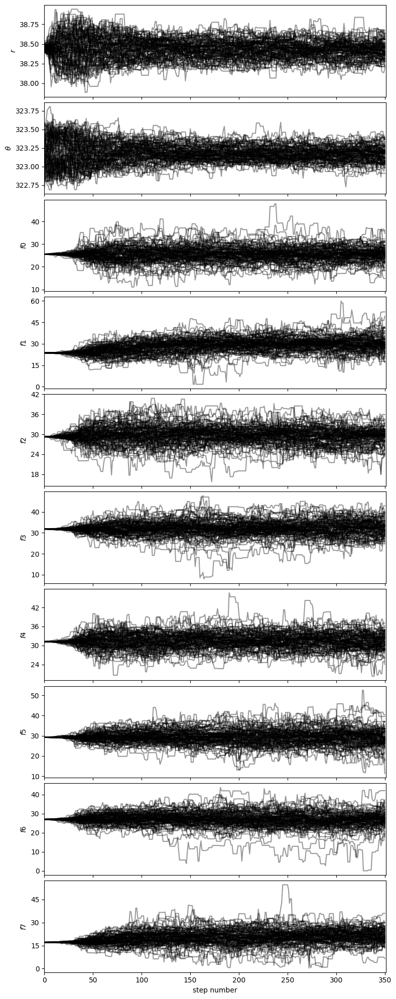

Auto-corr tau/N = [0.08164156 0.08150886 0.07393496 0.09577317 0.07203522 0.07839577
 0.08020406 0.07359604 0.07559539 0.08779127]
tau/N <= 0.02 = [False False False False False False False False False False] 

351		43.57198			6448.65230
352		41.70063			6129.99232
353		40.96340			5980.65684
354		41.58419			6029.70697
355		42.34367			6097.48834
356		41.68511			5960.97001
357		42.37929			6017.85961
358		42.86855			6044.46583
359		42.44497			5942.29538
360		42.36900			5889.29058
361		42.31232			5839.09988
362		40.98184			5614.51249
363		40.89575			5561.82159
364		41.54981			5609.22462
365		42.45422			5688.86561
366		41.66613			5541.59556
367		41.71437			5506.29644
368		40.84662			5350.90683
369		42.34153			5504.39903
370		41.63668			5371.13237
371		42.30502			5415.04294
372		40.90668			5195.14823
373		42.42687			5345.78600
374		42.32597			5290.74575
375		42.36456			5253.20507
376		42.41646			5217.22495
377		42.33143			5164.43458
378		42.30607			5119.03471
379		42.42213			5090.65596
380		4

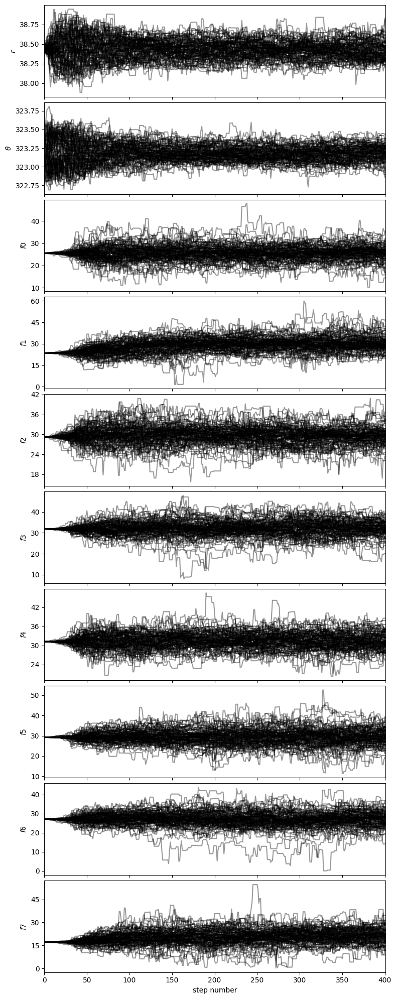

Auto-corr tau/N = [0.07941974 0.07854472 0.07005347 0.09072779 0.06894636 0.0737765
 0.0749939  0.07086589 0.07387962 0.08527202]
tau/N <= 0.02 = [False False False False False False False False False False] 

401		43.91815			4303.97870
402		42.43418			4116.11585
403		41.62088			3995.60410
404		40.97184			3892.32480
405		41.57222			3907.78906
406		40.85908			3799.89407
407		42.42050			3902.68637
408		41.56203			3782.14500
409		41.68306			3751.47495
410		40.95023			3644.57020
411		41.56729			3657.92170
412		40.88569			3557.05460
413		41.66803			3583.45032
414		42.30292			3595.74812
415		41.83192			3513.88086
416		42.45330			3523.62373
417		41.68417			3418.10178
418		41.54964			3365.52076
419		42.41619			3393.29520
420		42.36974			3347.20954
421		42.29505			3299.01398
422		41.67832			3209.23049
423		41.67398			3167.22256
424		42.43442			3182.58120
425		41.75355			3089.76240
426		42.45263			3099.04177
427		42.54186			3063.01406
428		42.33367			3005.69022
429		41.64430			2915.10072
430		41

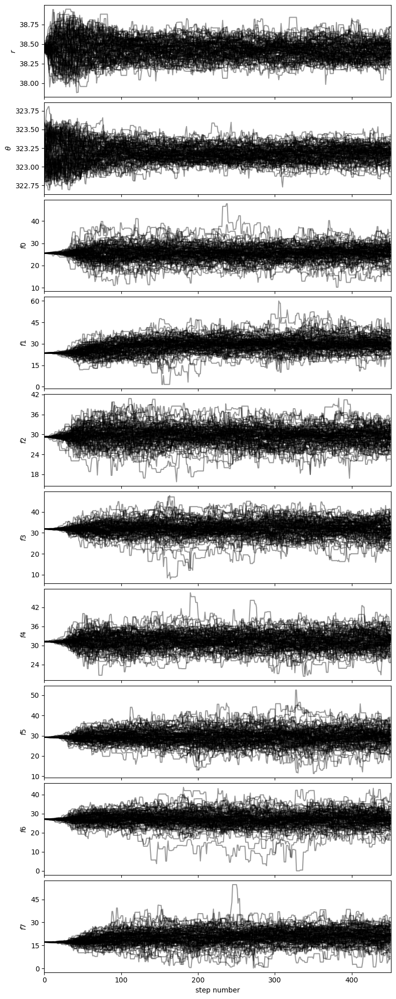

Auto-corr tau/N = [0.07698456 0.07578134 0.06698945 0.08530015 0.0695675  0.07206322
 0.07236937 0.06870056 0.06946411 0.08389287]
tau/N <= 0.02 = [False False False False False False False False False False] 

451		43.45477			2085.82877
452		42.42181			1993.82526
453		42.55455			1957.50948
454		42.32227			1904.50215
455		40.81474			1795.84852
456		41.64643			1790.79645
457		40.92999			1719.05966
458		42.31206			1734.79446
459		40.48955			1619.58184
460		41.81267			1630.69432
461		41.02704			1559.02744
462		40.33687			1492.46412
463		41.01607			1476.57866
464		41.03562			1436.24666
465		41.78340			1420.63574
466		41.80403			1379.53283
467		41.06602			1314.11258
468		41.81698			1296.32632
469		41.82371			1254.71127
470		41.90905			1215.36248
471		41.76623			1169.45441
472		41.77700			1127.97892
473		41.13989			1069.63704
474		40.97086			1024.27140
475		41.06017			985.44403
476		41.82021			961.86488
477		41.75937			918.70614
478		41.80637			877.93385
479		41.20551			824.11014
480		41.008

In [79]:
# MCMC
chain = mcmc_negfc_sampling(cube_fc[final_chs_c], derot_angles, **obs_params, **algo_params, **negfc_params, 
                            initial_state=initial_state, **mcmc_params, **conv_params, weights=weights,
                            display=True, verbosity=2, save=False, output_dir='./')

If you ran the previous box and wish to write your results, set `write=True` in the next box. This will pickle the MCMC chain.

In [80]:
write=False

if write:
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'wb') as fileSave:
        pickle.dump(output, fileSave)

In [81]:
with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'rb') as fi:
    myPickler = pickle.Unpickler(fi)
    mcmc_result = myPickler.load()

chain = mcmc_result['chain']

Let's visualize the chain after setting labels for each parameter:

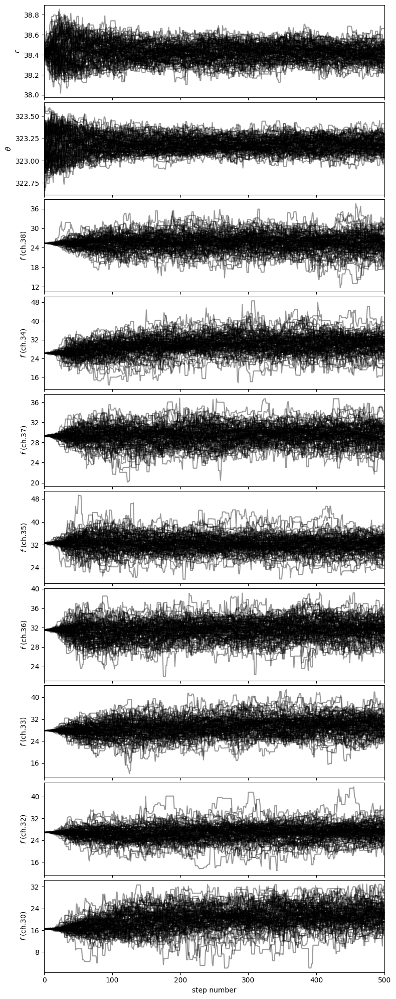

In [82]:
labels = [r"$r$", r"$\theta$"]
for i, ch in enumerate(final_chs_c):
    labels.append(r"$f$ (ch.{:.0f})".format(ch))
show_walk_plot(chain, labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

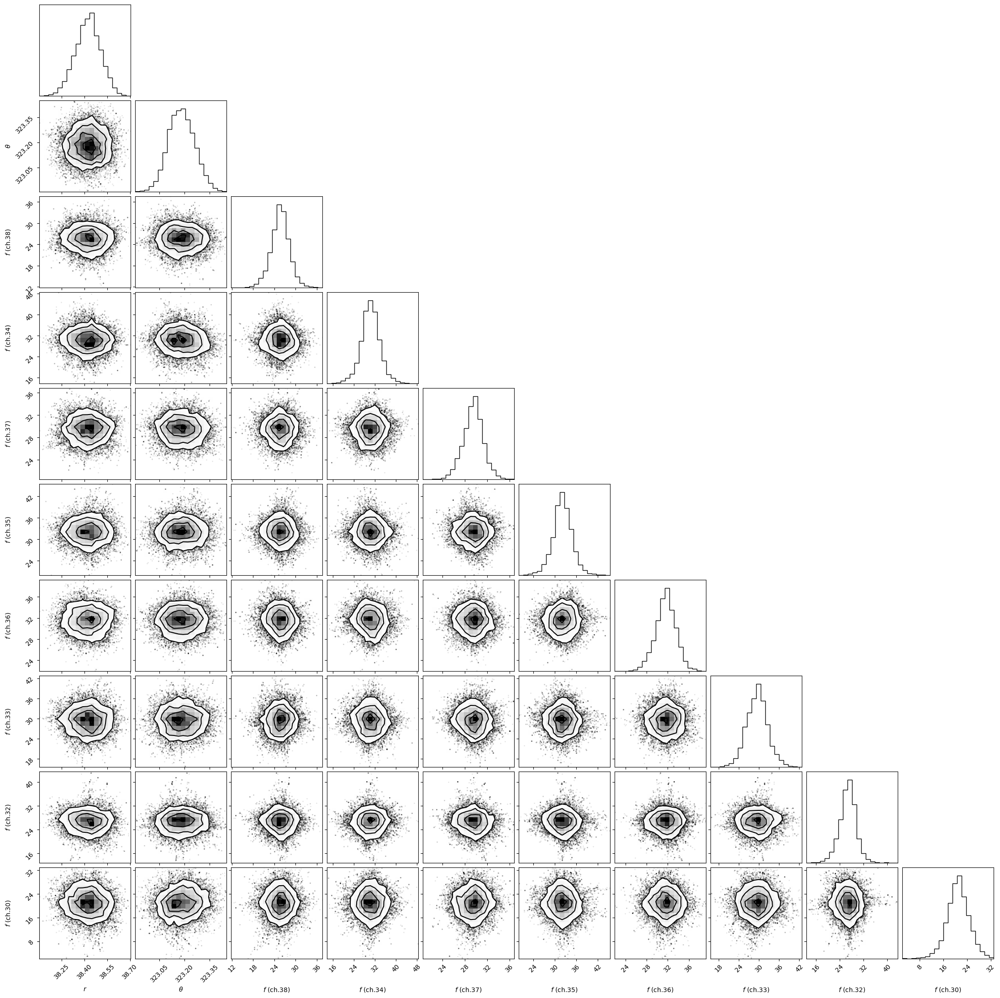

In [83]:
burnin = 0.3
show_corner_plot(chain, burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [84]:
npar = len(initial_state)
isamples_flat = chain[:, int(chain.shape[1]//(1/burnin)):, :].reshape((-1,npar))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

/Users/valentin/GitHub/VIP/vip_hci/fm/negfc_mcmc.py:1541: UserWarning: The figure layout has changed to tight
  plt.tight_layout(w_pad=0.1)


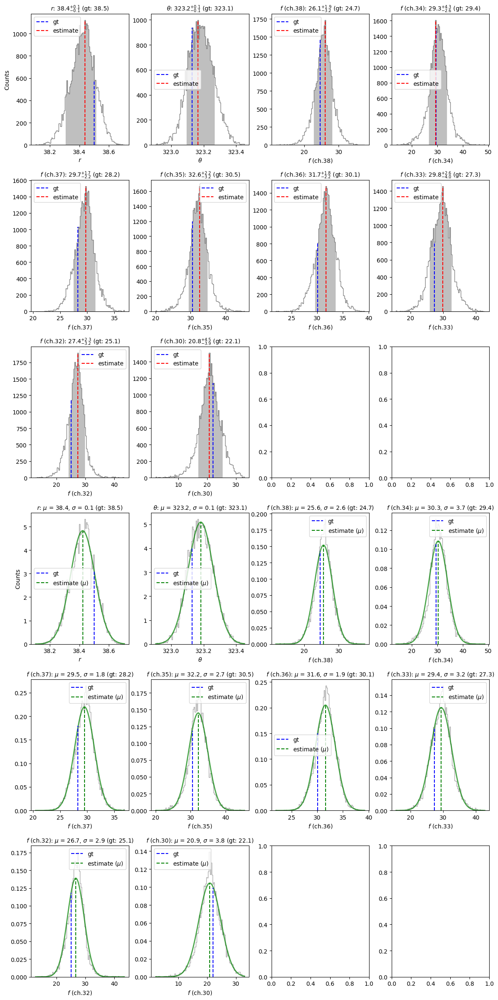

In [85]:
gt = [r_c, theta_c%360]
for i, ch in enumerate(final_chs_c):
    gt.append(flux_c_scal[ch])

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated parameters are consistent with the ground truth values (shown with dashed blue lines).

In [86]:
r_est = mu[0]
theta_est = mu[1]

xc, yc = frame_center(cube_fc)
x_est = xc + r_est*np.cos(np.deg2rad(theta_est))
y_est = yc + r_est*np.sin(np.deg2rad(theta_est))

xy_est = (x_est, y_est)

## 7.7. Spectrum retrieval

### 7.7.1. NEGFC+PCA-ADI (simplex)

Let's use the negative fake companion technique (combined with PCA-ADI) to estimate the flux of the companion in each spectral channel. Here, we will just use the `firstguess` function in VIP which finds a first estimate on a grid of flux values followed by a simplex. Here we set `force_rPA=True` to pin the position during the NEGFC procedure (i.e. only allowing the fluxes at different wavelengths as free parameters).

In [87]:
est_fluxes_c = np.zeros(nch)
for i in range(nch):
    trans_i = np.array([trans[0],trans[i]])
    res = firstguess(cube_fc[i], derot_angles, psfn[i], ncomp=4, planets_xy_coord=[xy_est], 
                     fwhm=fwhm[i], annulus_width=int(4*fwhm[i]), aperture_radius=2, imlib='opencv',
                     f_range=None, transmission=trans_i, mu_sigma=True, force_rPA=True, weights=X_fac,
                     simplex=True, plot=False, verbose=False)
    _, _, est_fluxes_c[i] = res

Note that we arbitrarily assigned the number of principal components to 5 and 2 for the PCA-ADI algorithm used by NEGFC to measure the fluxes of the inner and outer fake planet. A more rigorous approach would consist in finding the optimal number of principal components for each spectral channel first, as done in Tutorial 5 (Sec. 5.2). 

Let's now compare the retrieved fluxes with and without weights to the ground truth values used for injection:

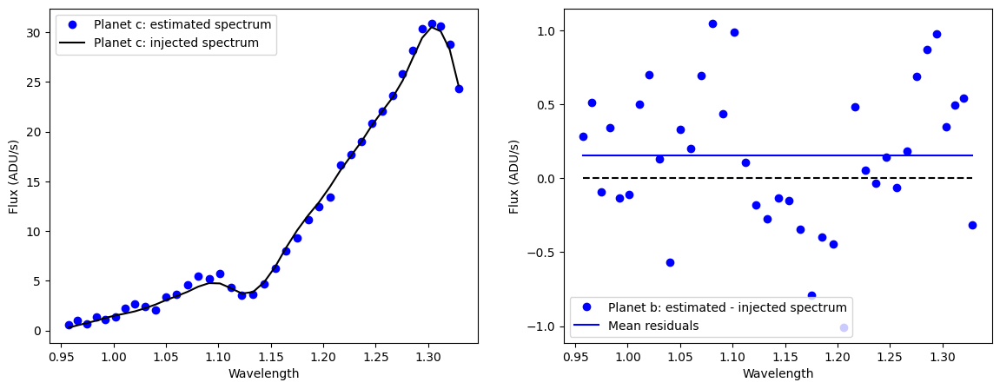

In [88]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, est_fluxes_c, 'bo', label='Planet c: estimated spectrum')
ax1.plot(lbda, flux_c_scal, 'k', label='Planet c: injected spectrum')
ax1.set_xlabel("Wavelength")
ax1.set_ylabel("Flux (ADU/s)")
ax1.legend()

ax2.plot(lbda, est_fluxes_c-flux_c_scal, 'bo', label='Planet b: estimated - injected spectrum')
ax2.plot(lbda, [0]*len(lbda), 'k--')
ax2.plot(lbda, [np.mean(est_fluxes_c-flux_c_scal)]*len(lbda), 'b-', label='Mean residuals')
ax2.set_xlabel("Wavelength")
ax2.set_ylabel("Flux (ADU/s)")
ax2.legend()
plt.show()

This approach does not yield uncertainties. For the latter, it is recommended to run the `mcmc_negfc_sampling` function.

### 7.7.2. NEGFC+PCA-ADI (MCMC)

One can use the MCMC approach to have both estimates and uncertainties on the flux of directly imaged companions. Given that this approach is computationally expensive, we will only apply it to 3 spectral channels.

We refer to Tutorial 5 (Sec. 5.3.3.) for more details on setting the MCMC parameters.

In [89]:
ann_width = 4*np.mean(fwhm)
aperture_radius=2
imlib_rot='opencv'
interpolation = 'lanczos4'
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib_rot, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': 2}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

Important note: the pixel intensities in calibrated SPHERE cubes coming out from the DRH pipeline (as this one) are normalized by their integration time. In absence of knowledge of this original integration time, it is not possible to scale the cube bask to original ADU values, and it is therefore not possible to include photon noise uncertainty among the different sources of uncertainty (in this specific case, the estimated photon noise uncertainty will be so large that the MCMC will not work properly). To alleviate this issue, we set `sigma` to 'spe', instead of 'spe+pho' (default) - although this may slightly underestimate the final uncertainties.


In [90]:
import pickle

lab='c'
test_ch = [20,29,38]

**Warning**: the next box is computer-intensive. The results from that box have been saved in the 'datasets' folder, such that it can be skipped.

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 08:56:01
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.053436
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=7.015
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 30.0
Flux in a centered 1xFWHM circular aperture = 1.948
Central pixel S/N = 8.027
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.612
Max S/N (shifting the aperture center) = 9.537
stddev S/N (shifting the aperture center) = 1.650



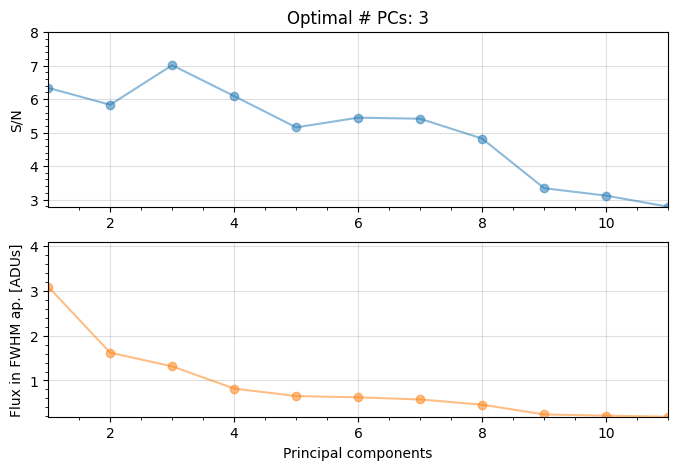

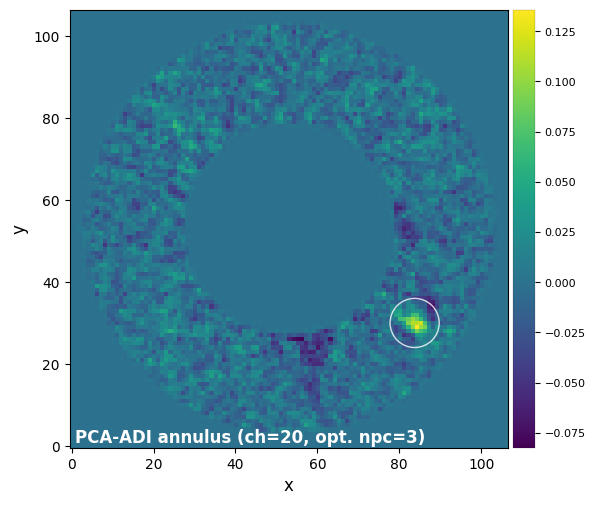

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 08:56:03
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.076
2/30   0.149   0.076
3/30   0.221   0.074
4/30   0.329   0.073
5/30   0.489   0.070
6/30   0.728   0.067
7/30   1.083   0.062
8/30   1.610   0.056
9/30   2.395   0.047
10/30   3.562   0.038
11/30   5.298   0.030
12/30   7.880   0.033
13/30   11.721   0.068
14/30   17.433   0.200


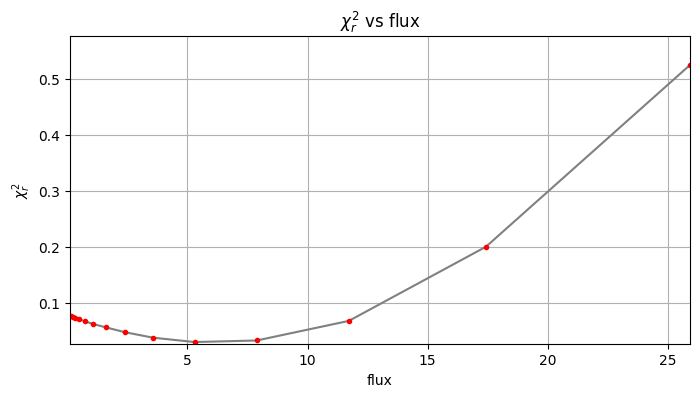

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 5.3
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 23, nfev: 48, chi2r: 0.028579331290166817
message: Optimization terminated successfully.
Planet 0: simplex result: (r, theta, f)=(38.422, 323.182, 5.965) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:07.868699
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 08:56:11
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean a

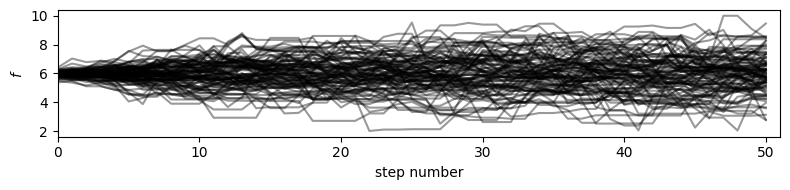

51		5.94852			2664.93606
52		5.59776			2502.19648
53		5.81273			2592.47624
54		5.82023			2590.00369
55		5.80735			2578.46384
56		5.85907			2595.56845
57		5.80409			2565.40866
58		5.80495			2559.98163
59		5.80201			2552.88484
60		5.71429			2508.57199
61		5.80740			2543.64251
62		5.81207			2539.87503
63		5.80139			2529.40604
64		5.81473			2529.40842
65		5.77066			2504.46557
66		5.79084			2507.43329
67		5.83615			2521.21464
68		5.70014			2456.76206
69		5.80063			2494.27176
70		5.80317			2489.55821
71		5.69971			2439.47759
72		5.80048			2476.80624
73		5.80061			2471.05986
74		5.80076			2465.32470
75		5.81364			2464.98251
76		5.71356			2416.83503
77		5.84713			2467.48928
78		5.70480			2401.71954
79		5.80433			2437.81902
80		5.69939			2388.04567
81		5.71779			2390.03580
82		5.80988			2422.71954
83		5.70456			2373.09779
84		5.79877			2406.49038
85		5.80815			2404.57286
86		5.79987			2395.34672
87		5.86613			2416.84432
88		5.81557			2390.19722
89		5.80809			2381.31731
90		5.80987			2376.23601


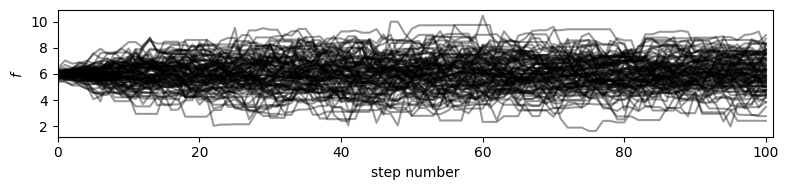

101		6.16415			2453.33011
102		5.79664			2301.26489
103		5.80871			2300.25035
104		5.79919			2290.67965
105		5.79340			2282.59842
106		5.80316			2280.64267
107		5.90503			2314.77019
108		5.88593			2301.39746
109		5.80947			2265.69408
110		5.79820			2255.49902
111		5.79888			2249.96583
112		5.79612			2243.09805
113		5.79935			2238.55026
114		5.80459			2234.76831
115		5.80161			2227.81709
116		5.81838			2228.44031
117		5.70528			2179.41620
118		5.77187			2199.08437
119		5.79842			2203.40150
120		5.79413			2195.97603
121		5.79725			2191.36201
122		5.79918			2186.29161
123		5.81734			2187.31909
124		5.79526			2173.22138
125		5.79925			2168.91838
126		5.80842			2166.53954
127		5.79593			2156.08633
128		5.85561			2172.43205
129		5.85052			2164.69092
130		5.80749			2142.96492
131		5.79473			2132.46138
132		5.80295			2129.68338
133		5.79891			2122.39923
134		5.80231			2117.84352
135		5.79659			2109.95949
136		5.79691			2104.27869
137		5.80889			2102.81890
138		5.80201			2094.52453
139		5.84506

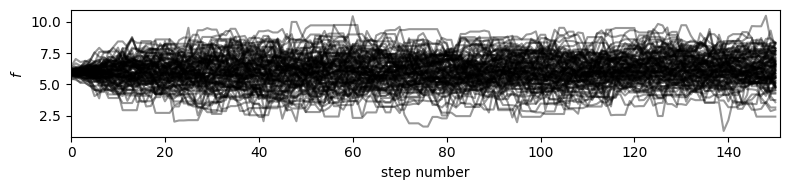

151		5.95231			2071.40284
152		5.69692			1976.83159
153		5.80223			2007.57089
154		5.80193			2001.66447
155		5.86861			2018.80115
156		5.70146			1955.59907
157		5.80285			1984.57402
158		5.79760			1976.97990
159		5.69833			1937.43118
160		5.85806			1985.88404
161		5.80303			1961.42549
162		5.80436			1956.06764
163		5.80576			1950.73536
164		5.82470			1951.27517
165		5.81750			1943.04400
166		5.79877			1930.99074
167		5.80107			1925.95657
168		5.81197			1923.76273
169		5.86083			1934.07291
170		5.85922			1927.68272
171		5.80701			1904.69928
172		5.79902			1896.27856
173		5.80103			1891.13741
174		5.80552			1886.79530
175		5.79514			1877.62633
176		5.80368			1874.58832
177		5.80836			1870.29256
178		5.81659			1867.12443
179		5.80322			1857.03008
180		5.86004			1869.35180
181		5.79511			1842.84498
182		5.80019			1838.65960
183		5.79989			1832.76556
184		5.80462			1828.45687
185		5.80562			1822.96311
186		5.79794			1814.75647
187		5.80222			1810.29420
188		5.82650			1812.04119
189		5.81383

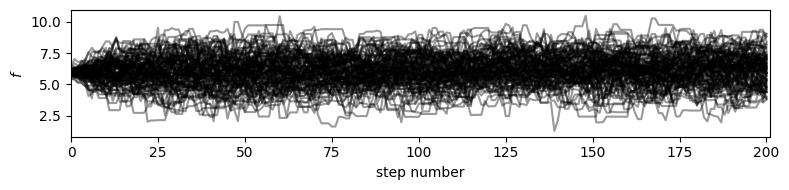

Auto-corr tau/N = [0.05665871]
tau/N <= 0.02 = [False] 

201		6.01271			1791.78788
202		5.79632			1721.50763
203		5.79552			1715.47274
204		5.79902			1710.71002
205		5.69870			1675.41692
206		5.69914			1669.84919
207		5.79628			1692.51376
208		5.76079			1676.39076
209		5.81300			1685.77058
210		5.79594			1675.02666
211		5.81083			1673.52048
212		5.80885			1667.14110
213		5.80016			1658.84662
214		5.79678			1652.08088
215		5.70419			1619.98996
216		5.79582			1640.21734
217		5.79893			1635.29939
218		5.80056			1629.95876
219		5.80535			1625.49940
220		5.80230			1618.84114
221		5.71937			1589.98569
222		5.84631			1619.42842
223		5.79276			1598.80286
224		5.70340			1568.43363
225		5.80360			1590.18667
226		5.79634			1582.40027
227		5.81372			1581.33293
228		5.79673			1570.91302
229		5.80287			1566.77490
230		5.67901			1527.65234
231		5.86575			1572.02207
232		5.85004			1561.96201
233		5.81933			1547.94258
234		5.79634			1536.03090
235		5.79903			1530.94471
236		5.80288			1526.15797
237		5.

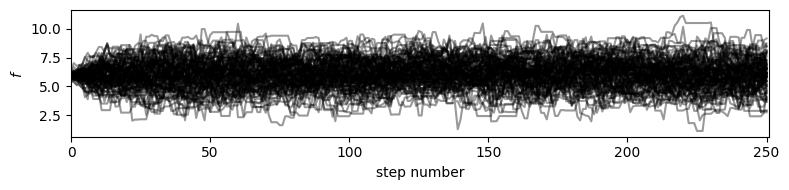

Auto-corr tau/N = [0.05337428]
tau/N <= 0.02 = [False] 

251		5.95256			1476.23538
252		5.84114			1442.76232
253		5.85466			1440.24636
254		5.80542			1422.32814
255		5.76007			1405.45806
256		5.80157			1409.78102
257		5.79796			1403.10559
258		5.80242			1398.38394
259		5.80036			1392.08664
260		5.71099			1364.92780
261		5.81439			1383.82553
262		5.80541			1375.88288
263		5.74965			1356.91834
264		5.76124			1353.89093
265		5.80915			1359.34180
266		5.79705			1350.71195
267		5.80658			1347.12633
268		5.79692			1339.08898
269		5.79275			1332.33250
270		5.80123			1328.48144
271		5.80665			1323.91574
272		5.81398			1319.77278
273		5.90262			1333.99325
274		5.81599			1308.59820
275		5.80570			1300.47702
276		5.76068			1284.63186
277		5.76618			1280.09196
278		5.79380			1280.42980
279		5.80005			1276.01100
280		5.79729			1269.60563
281		5.77409			1258.75097
282		5.80409			1259.48840
283		5.80762			1254.44570
284		5.75185			1236.64775
285		5.79711			1240.58218
286		5.79413			1234.14990
287		5.

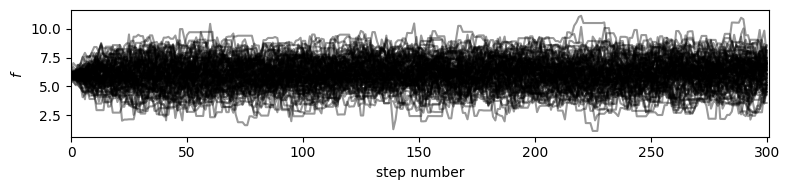

Auto-corr tau/N = [0.05031548]
tau/N <= 0.02 = [False] 

301		5.95791			1179.66717
302		5.80842			1144.25894
303		5.80991			1138.74236
304		5.82695			1136.25623
305		5.82453			1129.95882
306		5.79581			1118.59191
307		5.79599			1112.82931
308		5.80050			1107.89550
309		5.79363			1100.79008
310		5.69782			1076.88874
311		5.80693			1091.70359
312		5.80430			1085.40410
313		5.81117			1080.87818
314		5.89445			1090.47325
315		5.85589			1077.48376
316		5.82093			1065.22946
317		5.80993			1057.40762
318		5.80029			1049.85321
319		5.80368			1044.66330
320		5.80141			1038.45239
321		5.76022			1025.31863
322		5.80551			1027.57562
323		5.80596			1021.84984
324		5.69737			997.03922
325		5.85595			1018.93513
326		5.69473			985.18742
327		5.70670			981.55274
328		5.80574			992.78154
329		5.81151			987.95636
330		5.82420			984.29031
331		5.81589			977.06969
332		5.79901			968.43434
333		5.81314			964.98141
334		5.69992			940.48730
335		5.86485			961.83507
336		5.84414			952.59466
337		5.80455			940.

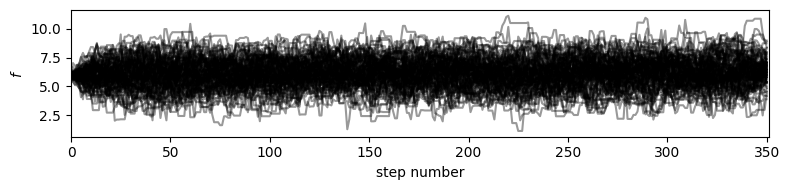

Auto-corr tau/N = [0.04544788]
tau/N <= 0.02 = [False] 

351		6.00558			888.82584
352		5.80297			853.03586
353		5.80255			847.17230
354		5.81322			842.91705
355		5.87050			845.35128
356		5.88642			841.75849
357		5.81330			825.48817
358		5.80125			817.97667
359		5.79692			811.56950
360		5.80664			807.12296
361		5.77206			796.54497
362		5.75183			788.00112
363		5.80547			789.54351
364		5.79947			782.92885
365		5.79250			776.19540
366		5.82927			775.29264
367		5.82404			768.77288
368		5.80903			760.98241
369		5.80392			754.50999
370		5.81047			749.55011
371		5.80359			742.85939
372		5.76160			731.72358
373		5.76280			726.11230
374		5.69377			711.72137
375		5.71245			708.34430
376		5.74367			706.47129
377		5.86718			715.79572
378		5.81920			704.12296
379		5.80435			696.52236
380		5.76013			685.45488
381		5.79873			684.25026
382		5.83162			682.29907
383		5.70191			661.42202
384		5.76201			662.63115
385		5.80834			662.15076
386		5.79918			655.30779
387		5.86457			656.83184
388		5.70947			633

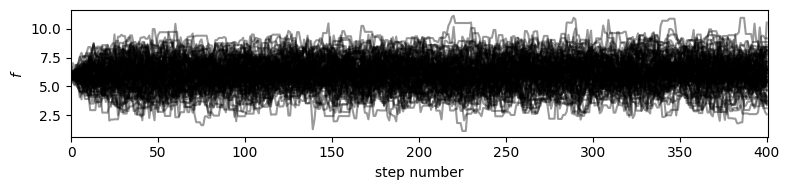

Auto-corr tau/N = [0.04241222]
tau/N <= 0.02 = [False] 

401		5.97408			585.45984
402		5.80684			563.26387
403		5.79849			556.65533
404		5.55867			528.07394
405		5.79622			544.84440
406		5.81281			540.59105
407		5.66695			521.35940
408		5.84701			532.07836
409		5.69267			512.34039
410		5.79709			515.94146
411		5.80483			510.82460
412		5.79550			504.20833
413		5.82217			500.70628
414		5.79201			492.32076
415		5.80904			487.95970
416		5.81917			482.99111
417		5.80303			475.84846
418		5.80157			469.92701
419		5.82252			465.80176
420		5.79540			457.83700
421		5.79475			451.99019
422		5.81702			447.91062
423		5.81056			441.60256
424		5.79576			434.68178
425		5.79682			428.96475
426		5.81006			424.13409
427		5.80243			417.77474
428		5.81558			412.90618
429		5.84593			409.21489
430		5.80310			400.41362
431		5.79400			393.99214
432		5.81648			389.70443
433		5.80883			383.38252
434		5.80742			377.48204
435		5.76980			369.26707
436		5.80234			365.54717
437		5.80937			360.18119
438		5.73652			349

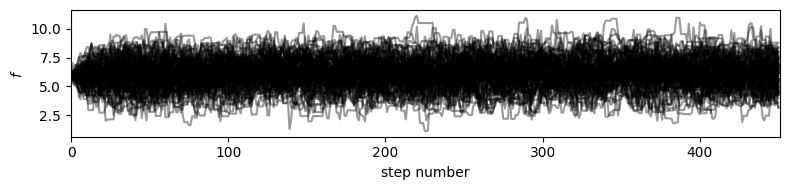

Auto-corr tau/N = [0.03899771]
tau/N <= 0.02 = [False] 

451		5.96007			286.08341
452		5.79334			272.28679
453		5.79480			266.56089
454		5.80330			261.14850
455		5.68739			250.24520
456		5.79717			249.27848
457		5.81687			244.30841
458		5.98882			245.54166
459		5.88886			235.55456
460		5.75642			224.50034
461		5.80339			220.52874
462		5.80280			214.70360
463		5.80756			209.07209
464		5.80328			203.11487
465		5.80403			197.33719
466		5.79718			191.30681
467		5.79829			185.54515
468		5.80649			180.00113
469		5.81033			174.30981
470		5.84314			169.45118
471		5.79469			162.25118
472		5.81830			157.09407
473		5.80191			150.84963
474		5.80361			145.09015
475		5.79561			139.09466
476		5.79976			133.39448
477		5.79967			127.59274
478		5.81992			122.21842
479		5.79868			115.97368
480		5.91684			112.42000
481		5.71668			102.90020
482		5.80394			98.66700
483		5.80219			92.83510
484		5.79802			86.97030
485		5.79617			81.14634
486		5.79491			75.33384
487		5.80060			69.60720
488		5.81212			63.93328


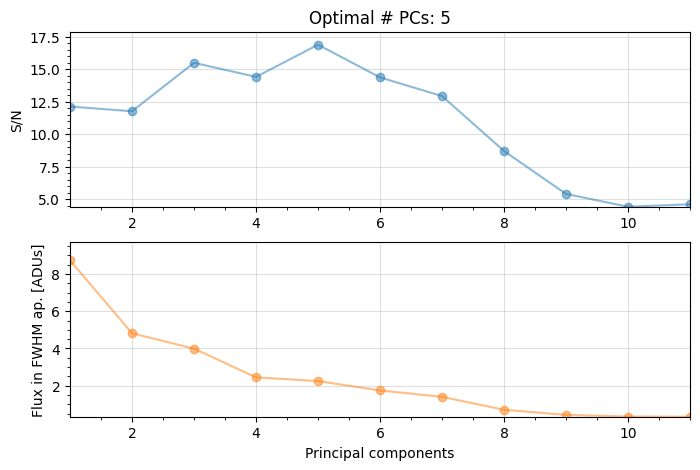

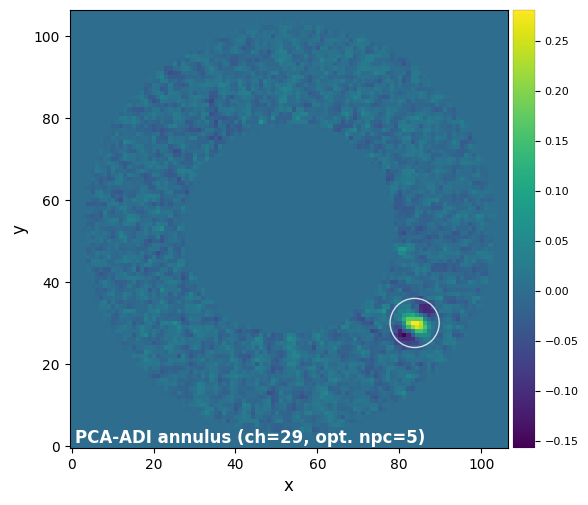

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 09:44:40
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.248
2/30   0.149   0.247
3/30   0.221   0.246
4/30   0.329   0.244
5/30   0.489   0.242
6/30   0.728   0.237
7/30   1.083   0.230
8/30   1.610   0.220
9/30   2.395   0.205
10/30   3.562   0.185
11/30   5.298   0.158
12/30   7.880   0.121
13/30   11.721   0.078
14/30   17.433   0.038
15/30   25.929   0.050
16/30   38.566   0.213
17/30   57.362   0.487


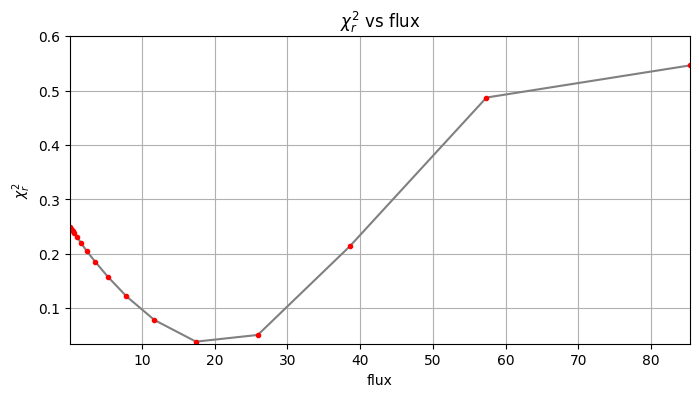

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 26, nfev: 60, chi2r: 0.032676364712401304
message: Optimization terminated successfully.
Planet 0: simplex result: (r, theta, f)=(38.422, 323.182, 20.300) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:09.845940
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 09:44:50
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean

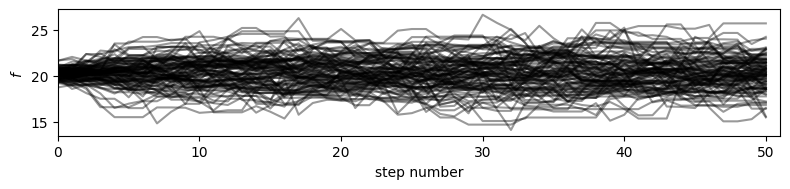

51		5.96074			2670.41286
52		5.81901			2601.09926
53		5.82081			2596.08260
54		5.82555			2592.36975
55		5.83051			2588.74777
56		5.82355			2579.83132
57		5.82523			2574.75299
58		5.82944			2570.78084
59		5.93835			2612.87576
60		5.84422			2565.61434
61		5.82587			2551.72975
62		5.82201			2544.21706
63		5.82440			2539.43796
64		5.82117			2532.20721
65		5.82638			2528.65022
66		5.82499			2522.22240
67		5.83598			2521.14163
68		5.82352			2509.93540
69		5.84167			2511.91767
70		5.88538			2524.82673
71		5.82789			2494.33820
72		5.83125			2489.94290
73		5.81576			2477.51163
74		5.82657			2476.29310
75		5.82211			2468.57464
76		5.81877			2461.33802
77		5.81814			2455.25424
78		5.83761			2457.63255
79		5.92237			2487.39708
80		5.89315			2469.23111
81		5.83478			2438.93637
82		5.83365			2432.63205
83		5.82325			2422.47325
84		5.82428			2417.07537
85		5.81682			2408.16348
86		5.82445			2405.49785
87		5.82451			2399.69853
88		5.83971			2400.11958
89		5.83185			2391.05645
90		5.88397			2406.54209


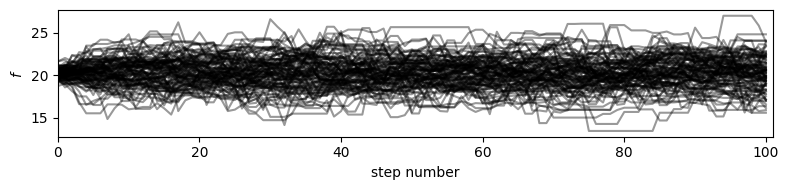

101		5.97921			2379.72518
102		5.84785			2321.59566
103		5.82794			2307.86305
104		5.83364			2304.28820
105		5.82397			2294.64379
106		5.81773			2286.36946
107		5.82899			2284.96526
108		5.83311			2280.74679
109		5.82949			2273.50071
110		5.83976			2271.66469
111		5.87618			2279.95629
112		5.81564			2250.65461
113		5.82578			2248.75031
114		5.82577			2242.92029
115		5.82643			2237.34758
116		5.83672			2235.46491
117		5.81468			2221.20661
118		5.82400			2218.94324
119		5.83812			2218.48674
120		5.87165			2225.35649
121		5.89532			2228.43134
122		5.83845			2201.09603
123		5.82580			2190.49967
124		5.82372			2183.89425
125		5.81988			2176.63662
126		5.82287			2171.92976
127		5.82376			2166.43946
128		5.83208			2163.70168
129		5.84091			2161.13855
130		5.82995			2151.25007
131		5.89184			2168.19712
132		5.82280			2136.96870
133		5.83108			2134.17638
134		5.82884			2127.52806
135		5.82834			2121.51722
136		5.85586			2125.67899
137		5.82900			2110.09909
138		5.82601			2103.18997
139		5.81349

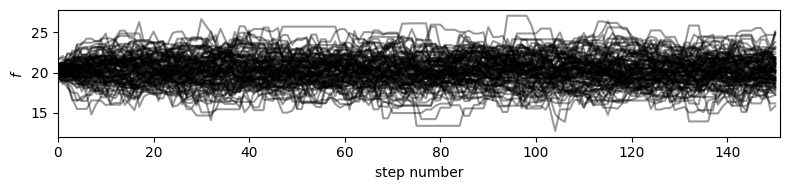

151		5.99917			2087.71151
152		5.89311			2044.90744
153		5.82779			2016.41396
154		5.82815			2010.71003
155		5.82918			2005.23723
156		5.82941			1999.48729
157		5.83097			1994.19242
158		5.82634			1986.78058
159		5.82823			1981.59854
160		5.83869			1979.31625
161		5.89537			1992.63574
162		5.88133			1982.00821
163		5.84253			1963.09109
164		5.82860			1952.58000
165		5.83161			1947.75841
166		5.83028			1941.48158
167		5.83077			1935.81398
168		5.82817			1929.12295
169		5.83227			1924.64844
170		5.83540			1919.84726
171		5.82649			1911.08872
172		5.88682			1924.98851
173		5.82024			1897.39791
174		5.82245			1892.29787
175		5.83651			1891.02956
176		5.83035			1883.20434
177		5.84112			1880.84193
178		5.82914			1871.15266
179		5.84630			1870.81568
180		5.83455			1861.22113
181		5.82538			1852.46925
182		5.88640			1865.99039
183		5.88730			1860.38680
184		5.81805			1832.68512
185		5.82649			1829.51849
186		5.83063			1824.98625
187		5.82538			1817.51762
188		5.82449			1811.41639
189		5.82216

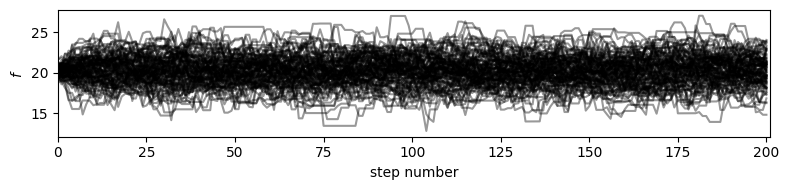

Auto-corr tau/N = [0.06204499]
tau/N <= 0.02 = [False] 

201		5.98316			1782.98019
202		5.86020			1740.47910
203		5.91547			1750.97882
204		5.84059			1722.97405
205		5.82093			1711.35254
206		5.82225			1705.91925
207		5.82018			1699.49256
208		5.81404			1691.88564
209		5.81871			1687.42677
210		5.81481			1680.48038
211		5.83950			1681.77744
212		5.82732			1672.44141
213		5.86316			1676.86376
214		5.82731			1660.78250
215		5.97968			1698.23026
216		5.81521			1645.70330
217		5.82609			1642.95682
218		5.82531			1636.91071
219		5.82433			1630.81380
220		5.82347			1624.74813
221		5.83352			1621.71745
222		5.82924			1614.70003
223		5.89722			1627.63382
224		5.89461			1621.01748
225		5.82394			1595.75901
226		5.81505			1587.50947
227		5.83265			1586.48162
228		5.84880			1585.02399
229		5.82943			1573.94583
230		5.84008			1570.98044
231		5.82212			1560.32843
232		5.83628			1558.28703
233		5.84971			1556.02339
234		5.88647			1559.91508
235		5.83148			1539.51046
236		5.83158			1533.70554
237		5.

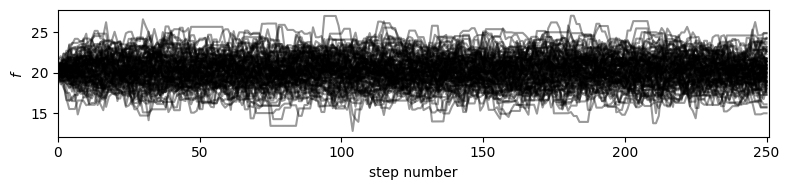

Auto-corr tau/N = [0.05451807]
tau/N <= 0.02 = [False] 

251		5.98607			1484.54660
252		5.84143			1442.83296
253		5.81965			1431.63365
254		5.85884			1435.41604
255		5.84718			1426.71143
256		5.81883			1413.97690
257		5.81997			1408.43322
258		5.83550			1406.35574
259		5.82944			1399.06560
260		5.82529			1392.24383
261		5.82181			1385.59078
262		5.83261			1382.32786
263		5.81701			1372.81342
264		5.88119			1382.07941
265		5.88902			1378.03021
266		5.82676			1357.63601
267		5.82618			1351.67306
268		5.83359			1347.55929
269		5.81703			1337.91644
270		5.83129			1335.36633
271		5.82887			1328.98145
272		5.82773			1322.89403
273		5.84527			1321.03102
274		5.82159			1309.85685
275		5.86856			1314.55811
276		5.82113			1298.11266
277		5.82369			1292.85896
278		5.82282			1286.84278
279		5.82072			1280.55906
280		5.82583			1275.85786
281		5.84196			1273.54750
282		5.81972			1262.87859
283		5.83740			1260.87797
284		5.97694			1285.04231
285		5.99759			1283.48490
286		5.83696			1243.27333
287		5.

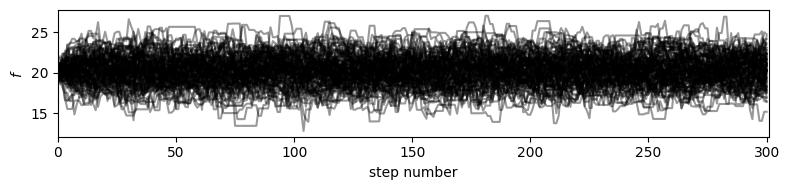

Auto-corr tau/N = [0.05093563]
tau/N <= 0.02 = [False] 

301		6.43325			1273.78390
302		5.86240			1154.89181
303		5.84113			1144.86128
304		5.83423			1137.67544
305		5.90701			1145.96052
306		5.91436			1141.47187
307		5.85783			1124.70374
308		5.88600			1124.22505
309		5.87483			1116.21751
310		5.86307			1108.11966
311		5.85655			1101.03065
312		5.88127			1099.79824
313		5.85064			1088.21941
314		5.87664			1087.17766
315		5.88239			1082.36068
316		5.90884			1081.31735
317		5.88387			1070.86489
318		5.89302			1066.63590
319		5.90989			1063.78020
320		5.90708			1057.36660
321		5.88779			1048.02751
322		5.86764			1038.57246
323		5.83394			1026.77362
324		5.85933			1025.38345
325		5.88732			1024.39281
326		5.91105			1022.61182
327		5.86651			1009.03989
328		5.84320			999.18788
329		5.86749			997.47279
330		5.89813			996.78448
331		5.91025			992.92267
332		5.93423			991.01574
333		5.89383			978.37512
334		5.86417			967.58805
335		5.85677			960.51028
336		5.95451			970.58448
337		5.85105			9

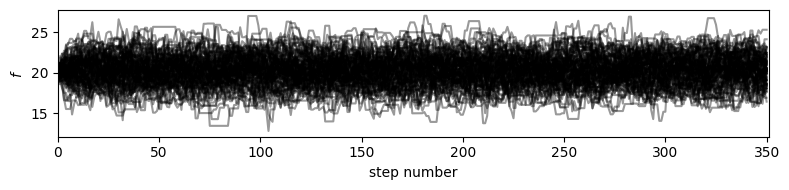

Auto-corr tau/N = [0.04740246]
tau/N <= 0.02 = [False] 

351		5.93516			878.40309
352		5.79652			852.08917
353		5.79432			845.97145
354		5.78304			838.54094
355		5.75225			828.32458
356		5.75930			823.58047
357		5.77040			819.39737
358		5.74033			809.38724
359		5.76001			806.40140
360		5.74901			799.11239
361		5.75028			793.53850
362		5.75207			788.03386
363		5.74819			781.75438
364		5.74271			775.26585
365		5.76438			772.42719
366		5.74925			764.65078
367		5.88783			777.19382
368		5.76044			754.61751
369		5.74163			746.41216
370		5.78939			746.83144
371		5.75681			736.87194
372		5.79160			735.53371
373		5.76193			726.00268
374		5.77248			721.55938
375		5.78718			717.60982
376		5.77600			710.44763
377		5.86888			716.00336
378		5.80244			702.09500
379		5.77585			693.10176
380		5.82262			692.89142
381		5.77006			680.86649
382		5.79976			678.57192
383		5.75022			667.02529
384		5.74833			661.05760
385		5.78823			659.85822
386		5.74037			648.66192
387		5.81190			650.93291
388		5.80710			644

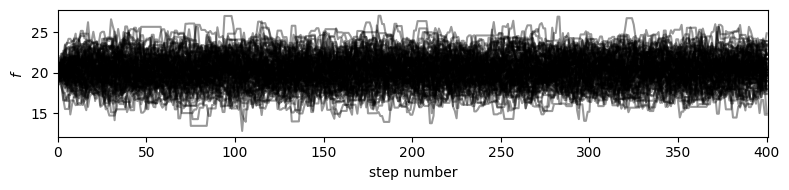

Auto-corr tau/N = [0.04336613]
tau/N <= 0.02 = [False] 

401		5.92130			580.28740
402		5.77514			560.18868
403		5.82119			558.83405
404		5.77300			548.43538
405		5.76790			542.18241
406		5.86799			545.72326
407		5.80079			533.67250
408		5.83835			531.28967
409		5.84986			526.48776
410		5.76281			512.89053
411		5.80418			510.76758
412		5.78445			503.24724
413		5.76948			496.17545
414		5.83203			495.72230
415		5.78878			486.25769
416		5.76657			478.62498
417		5.79652			475.31489
418		5.81902			471.34086
419		5.94883			475.90664
420		5.83844			461.23652
421		5.79682			452.15173
422		5.75462			443.10551
423		5.75966			437.73408
424		5.73881			430.41098
425		5.73993			424.75445
426		5.77498			421.57376
427		5.80030			417.62124
428		5.76029			408.98073
429		5.95327			416.72883
430		5.79185			399.63765
431		5.76237			391.84096
432		5.78212			387.40170
433		5.79197			382.26982
434		5.75437			374.03379
435		5.76415			368.90554
436		5.78394			364.38828
437		5.81787			360.70782
438		5.76831			351

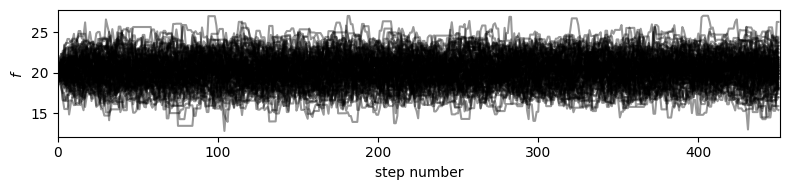

Auto-corr tau/N = [0.03942814]
tau/N <= 0.02 = [False] 

451		5.98981			287.51098
452		5.75482			270.47663
453		5.76882			265.36581
454		5.80268			261.12074
455		5.80081			255.23542
456		5.77567			248.35372
457		5.79796			243.51428
458		5.90850			242.24871
459		5.78904			231.56160
460		5.91520			230.69288
461		5.82856			221.48536
462		5.83832			216.01780
463		5.79665			208.67944
464		5.77646			202.17600
465		5.85945			199.22147
466		5.77014			190.41472
467		5.76457			184.46621
468		5.88715			182.50165
469		5.85960			175.78806
470		5.86154			169.98466
471		5.93795			166.26271
472		5.81727			157.06640
473		5.75148			149.53843
474		5.75475			143.86867
475		5.78742			138.89806
476		5.77179			132.75124
477		5.81701			127.97415
478		5.76909			121.15085
479		5.75040			115.00796
480		5.80792			110.35040
481		5.85954			105.47165
482		5.80263			98.64471
483		5.77606			92.41696
484		5.76272			86.44080
485		5.76446			80.70243
486		5.76622			74.96090
487		5.78873			69.46477
488		5.80469			63.85161


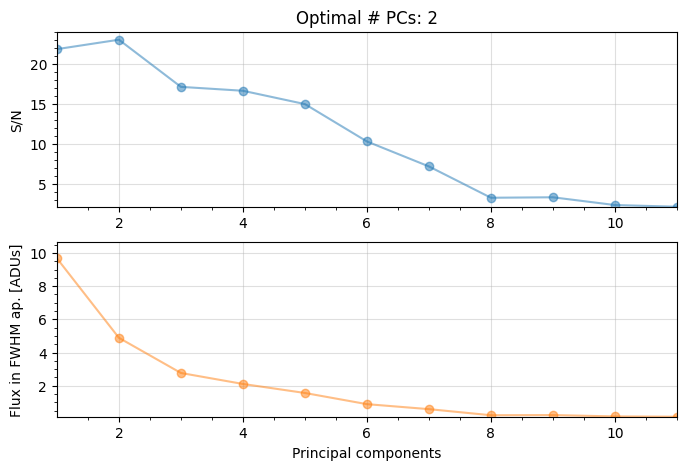

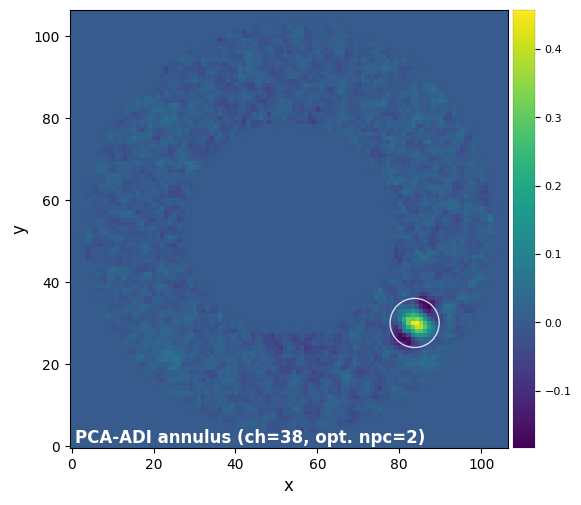

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 10:33:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.628
2/30   0.149   0.626
3/30   0.221   0.624
4/30   0.329   0.619
5/30   0.489   0.613
6/30   0.728   0.603
7/30   1.083   0.589
8/30   1.610   0.568
9/30   2.395   0.538
10/30   3.562   0.494
11/30   5.298   0.432
12/30   7.880   0.350
13/30   11.721   0.230
14/30   17.433   0.107
15/30   25.929   0.031
16/30   38.566   0.201
17/30   57.362   0.906
18/30   85.317   2.627


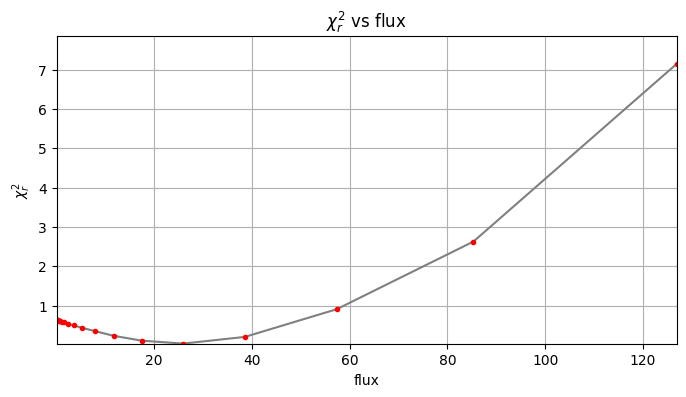

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 25.9
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 23, nfev: 51, chi2r: 0.030991103251775107
message: Optimization terminated successfully.
Planet 0: simplex result: (r, theta, f)=(38.422, 323.182, 26.067) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:08.735703
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-08-01 10:33:44
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean

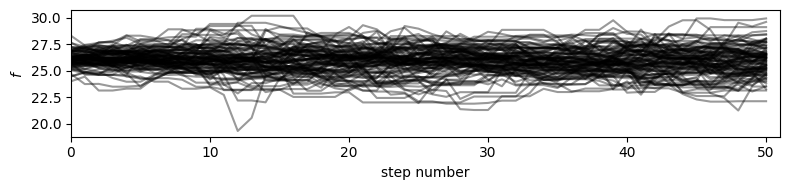

51		5.86191			2626.13613
52		5.71694			2555.47352
53		5.70648			2545.09142
54		5.70232			2537.53151
55		5.79946			2574.96157
56		5.70821			2528.73526
57		5.71410			2525.63264
58		5.71153			2518.78297
59		5.71928			2516.48496
60		5.71458			2508.70238
61		5.71103			2501.42939
62		5.74885			2512.24876
63		5.74286			2503.88783
64		5.76331			2507.04072
65		5.84585			2537.09803
66		5.84028			2528.84167
67		5.78904			2500.86528
68		5.83745			2515.94181
69		5.76270			2477.96186
70		5.87889			2522.04596
71		5.91387			2531.13465
72		5.87992			2510.72541
73		5.76044			2453.94957
74		5.78967			2460.61060
75		5.73955			2433.56962
76		5.79559			2451.53288
77		5.76357			2432.22696
78		5.77283			2430.36227
79		5.81449			2442.08790
80		5.89064			2468.17690
81		5.81420			2430.33602
82		5.78003			2410.27126
83		5.78261			2405.56659
84		5.72187			2374.57522
85		5.78248			2393.94589
86		5.72734			2365.39183
87		5.74531			2367.06937
88		5.71081			2347.14209
89		5.71593			2343.53048
90		5.80961			2376.12885


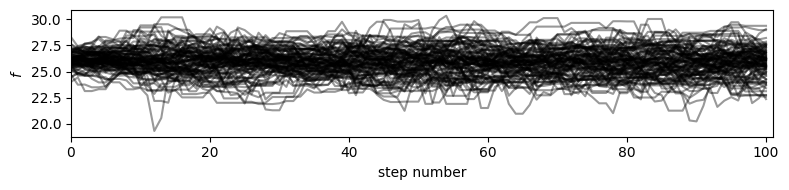

101		5.89413			2345.86294
102		5.75483			2284.66950
103		5.75158			2277.62687
104		5.77031			2279.27284
105		5.73667			2260.24798
106		5.72829			2251.21718
107		5.76363			2259.34296
108		5.74031			2244.45965
109		5.74585			2240.88345
110		5.75084			2237.07832
111		5.75823			2234.19208
112		5.79869			2244.09458
113		5.74979			2219.41933
114		5.74062			2210.13831
115		5.70879			2192.17613
116		5.74075			2198.70687
117		5.72137			2185.56410
118		5.70998			2175.50047
119		5.71521			2171.78094
120		5.72129			2168.36891
121		5.71488			2160.22615
122		5.71988			2156.39664
123		5.72662			2153.20837
124		5.71360			2142.60037
125		5.76605			2156.50233
126		5.74076			2141.30460
127		5.70570			2122.52077
128		5.71277			2119.43581
129		5.71062			2112.93051
130		5.70959			2106.83760
131		5.71113			2101.69437
132		5.71141			2096.08674
133		5.76805			2111.10520
134		5.72189			2088.48985
135		5.70946			2078.24417
136		5.74896			2086.87139
137		5.72121			2071.07766
138		5.71633			2063.59405
139		5.70564

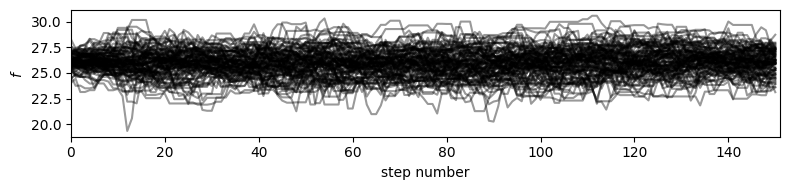

151		6.05471			2107.03908
152		5.77012			2002.23199
153		5.75613			1991.62029
154		5.79242			1998.38594
155		5.71983			1967.62290
156		5.71969			1961.85470
157		5.72040			1956.37714
158		5.71075			1947.36643
159		5.71073			1941.64752
160		5.73499			1944.16330
161		5.78247			1954.47587
162		5.81870			1960.90257
163		5.77175			1939.30699
164		5.82423			1951.11571
165		5.73849			1916.65533
166		5.70987			1901.38671
167		5.71230			1896.48426
168		5.70806			1889.36786
169		5.70476			1882.57179
170		5.70970			1878.49163
171		5.72042			1876.29776
172		5.70523			1865.60988
173		5.70574			1860.07157
174		5.70983			1855.69637
175		5.78328			1873.78142
176		5.70703			1843.37198
177		5.72098			1842.15492
178		5.71276			1833.79468
179		5.70183			1824.58528
180		5.69935			1818.09137
181		5.70182			1813.17971
182		5.75616			1824.70335
183		5.70828			1803.81774
184		5.71177			1799.20786
185		5.70762			1792.19268
186		5.71011			1787.26287
187		5.70843			1781.02954
188		5.71915			1778.65596
189		5.70828

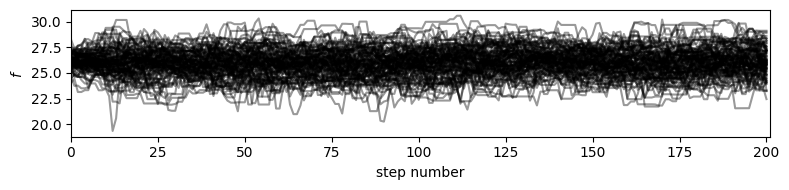

Auto-corr tau/N = [0.05251387]
tau/N <= 0.02 = [False] 

201		5.89902			1757.90647
202		5.70346			1693.92792
203		5.72902			1695.78844
204		5.72088			1687.66107
205		5.71969			1681.58945
206		5.70478			1671.50142
207		5.70688			1666.40925
208		5.70524			1660.22368
209		5.70643			1654.86412
210		5.70375			1648.38404
211		5.71389			1645.59917
212		5.70574			1637.54709
213		5.70956			1632.93359
214		5.71058			1627.51416
215		5.70967			1621.54571
216		5.73862			1624.02861
217		5.74783			1620.88919
218		5.74544			1614.46892
219		5.70505			1597.41316
220		5.71335			1594.02326
221		5.70426			1585.78317
222		5.70627			1580.63762
223		5.71487			1577.30357
224		5.70217			1568.09703
225		5.70805			1564.00515
226		5.70726			1558.08089
227		5.71809			1555.32102
228		5.71242			1548.06690
229		5.71518			1543.09833
230		5.71167			1536.43896
231		5.71139			1530.65252
232		5.70786			1523.99835
233		5.70449			1517.39407
234		5.70244			1511.14792
235		5.70389			1505.82670
236		5.71081			1501.94250
237		5.

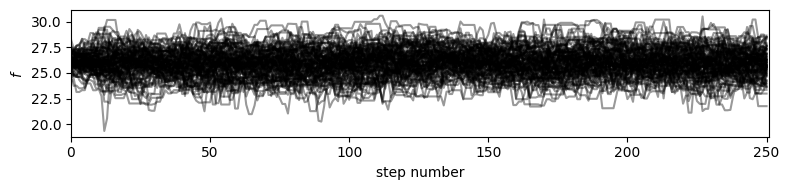

Auto-corr tau/N = [0.05106302]
tau/N <= 0.02 = [False] 

251		5.85888			1453.00100
252		5.70966			1410.28553
253		5.70798			1404.16308
254		5.71307			1399.70264
255		5.69622			1389.87744
256		5.69975			1385.03876
257		5.70919			1381.62471
258		5.72718			1380.25134
259		5.72733			1374.55944
260		5.72308			1367.81684
261		5.70497			1357.78191
262		5.70953			1353.15837
263		5.70953			1347.44932
264		5.70562			1340.82023
265		5.70503			1334.97819
266		5.70801			1329.96703
267		5.74285			1332.34166
268		5.75699			1329.86353
269		5.73751			1319.62776
270		5.73232			1312.70174
271		5.72105			1304.40008
272		5.70908			1295.96116
273		5.71879			1292.44677
274		5.70744			1284.17310
275		5.71027			1279.09981
276		5.72632			1276.96958
277		5.72505			1270.96043
278		5.71308			1262.59068
279		5.78778			1273.31094
280		5.72693			1254.19855
281		5.73723			1250.71570
282		5.70953			1238.96758
283		5.70809			1232.94679
284		5.70558			1226.69927
285		5.70217			1220.26352
286		5.70793			1215.78994
287		5.

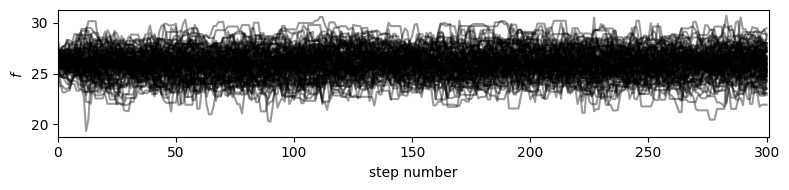

Auto-corr tau/N = [0.04719361]
tau/N <= 0.02 = [False] 

301		5.88954			1166.12932
302		5.72935			1128.68116
303		5.70507			1118.19352
304		5.70441			1112.35975
305		5.70476			1106.72383
306		5.70655			1101.36434
307		5.71050			1096.41542
308		5.71620			1091.79477
309		5.71035			1084.96631
310		5.71634			1080.38788
311		5.71663			1074.72663
312		5.70297			1066.45464
313		5.70507			1061.14358
314		5.71183			1056.68873
315		5.70690			1050.06942
316		5.70852			1044.65971
317		5.70691			1038.65689
318		5.70689			1032.94691
319		5.70526			1026.94662
320		5.71481			1022.95171
321		5.73466			1020.76895
322		5.72613			1013.52501
323		5.72222			1007.11019
324		5.70302			998.02920
325		5.70433			992.55394
326		5.70906			987.66686
327		5.70737			981.66730
328		5.71293			976.91171
329		5.71209			971.05462
330		5.70240			963.70475
331		5.71338			959.84801
332		5.70958			953.49919
333		5.71116			948.05256
334		5.70758			941.75087
335		5.70535			935.67724
336		5.71201			931.05779
337		5.70770			924.6

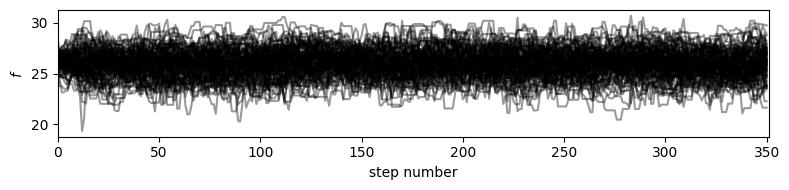

Auto-corr tau/N = [0.04499889]
tau/N <= 0.02 = [False] 

351		5.86812			868.48176
352		5.74585			844.63951
353		5.70910			833.52918
354		5.70610			827.38493
355		5.70534			821.56838
356		5.70108			815.25487
357		5.72648			813.16073
358		5.70372			804.22466
359		5.75341			805.47712
360		5.69934			792.20798
361		5.71853			789.15659
362		5.73958			786.32260
363		5.73664			780.18250
364		5.71242			771.17630
365		5.72764			767.50349
366		5.70577			758.86741
367		5.70369			752.88655
368		5.70414			747.24208
369		5.70338			741.44005
370		5.70610			736.08754
371		5.70379			730.08499
372		5.71206			725.43099
373		5.70941			719.38629
374		5.71502			714.37762
375		5.70620			707.56830
376		5.70186			701.32829
377		5.70955			696.56534
378		5.70038			689.74610
379		5.70927			685.11300
380		5.70481			678.87215
381		5.70287			672.93819
382		5.70599			667.60130
383		5.72142			663.68518
384		5.73791			659.85988
385		5.70269			650.10632
386		5.72315			646.71618
387		5.70060			638.46675
388		5.70370			633

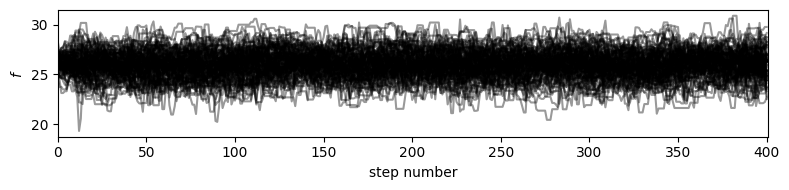

Auto-corr tau/N = [0.04120988]
tau/N <= 0.02 = [False] 

401		5.87167			575.42337
402		5.70712			553.59025
403		5.70399			547.58352
404		5.71676			543.09230
405		5.74946			540.44905
406		5.71292			531.30137
407		5.72916			527.08244
408		5.70345			519.01350
409		5.70291			513.26208
410		5.70489			507.73565
411		5.70624			502.14947
412		5.70192			496.06678
413		5.71785			491.73536
414		5.71525			485.79608
415		5.71795			480.30788
416		5.71587			474.41746
417		5.70110			467.48995
418		5.70667			462.24059
419		5.70469			456.37536
420		5.71534			451.51202
421		5.70693			445.14015
422		5.70533			439.31072
423		5.69570			432.87335
424		5.69873			427.40460
425		5.71444			422.86849
426		5.77599			421.64698
427		5.71247			411.29813
428		5.72630			406.56716
429		5.70544			399.38087
430		5.70471			393.62506
431		5.70434			387.89532
432		5.71088			382.62883
433		5.70309			376.40401
434		5.70782			371.00817
435		5.70737			365.27200
436		5.70766			359.58252
437		5.70162			353.50025
438		5.70367			347

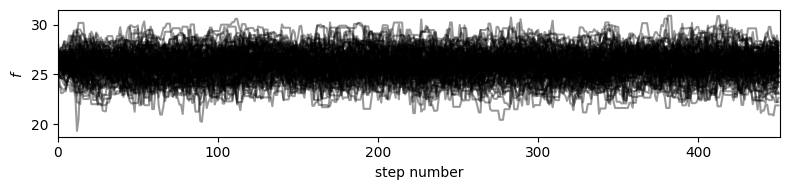

Auto-corr tau/N = [0.03902046]
tau/N <= 0.02 = [False] 

451		6.14985			295.19256
452		5.71717			268.70694
453		5.71350			262.82082
454		5.70607			256.77297
455		5.70693			251.10510
456		5.71027			245.54161
457		5.73913			241.04350
458		5.71328			234.24432
459		5.71343			228.53712
460		5.70731			222.58525
461		5.70492			216.78700
462		5.70456			211.06891
463		5.69844			205.14380
464		5.69863			199.45202
465		5.70468			193.95929
466		5.69910			188.07043
467		5.71304			182.81741
468		5.74115			177.97571
469		6.98081			209.42418
470		7.37793			213.96009
471		7.68818			215.26912
472		34.16667			922.50001
473		7.37190			191.66948
474		7.38308			184.57690
475		7.38100			177.14398
476		7.46784			171.76039
477		7.35157			161.73445
478		7.37185			154.80875
479		7.37311			147.46216
480		7.34941			139.63873
481		7.35881			132.45860
482		7.35466			125.02927
483		7.34722			117.55544
484		7.36387			110.45800
485		7.42104			103.89450
486		7.43563			96.66322
487		7.37530			88.50360
488		7.35043			80.8

In [91]:
for i, ch in enumerate(test_ch):
    # find optimal npc
    res_ann_opt = pca_grid(cube_fc[ch], derot_angles, fwhm=fwhm[ch], range_pcs=(1,11,1), 
                           source_xy=xy_est, mode='annular',
                           annulus_width=ann_width, imlib=imlib_rot, 
                           interpolation=interpolation, 
                           full_output=True, plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, _, opt_npc_ann = res_ann_opt
    plot_frames(final_ann_opt, label='PCA-ADI annulus (ch={}, opt. npc={:.0f})'.format(ch, opt_npc_ann),
                dpi=100, colorbar=True, circle=xy_est)
    # first guess
    trans_i = np.array([trans[0],trans[ch]])
    r_0, theta_0, f_0 = firstguess(cube_fc[ch], derot_angles, psfn[ch], ncomp=opt_npc_ann,
                                   planets_xy_coord=[xy_est], fwhm=fwhm[ch], weights=X_fac,
                                   f_range=None, annulus_width=ann_width, aperture_radius=aperture_radius,
                                   imlib=imlib_rot, interpolation=interpolation, simplex=True, force_rPA=True,
                                   transmission=trans_i, plot=True, verbose=True)
    initial_state = np.array([r_0[0], theta_0[0], f_0[0]])
    # MCMC
    obs_params['psfn']= psfn[ch]
    obs_params['fwhm']= fwhm[ch]
    obs_params['transmission']= trans_i
    algo_params['ncomp'] = opt_npc_ann
    chain = mcmc_negfc_sampling(cube_fc[ch], derot_angles, **obs_params, **algo_params, **negfc_params, 
                                initial_state=initial_state, **mcmc_params, **conv_params, weights=X_fac,
                                force_rPA=True, display=True, verbosity=2, save=False, output_dir='./')
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'wb') as fileSave:
        pickle.dump(output, fileSave)           

In [92]:
chain = []
for i, ch in enumerate(test_ch):

    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'rb') as fi:
        myPickler = pickle.Unpickler(fi)
        mcmc_result = myPickler.load()

    chain.append(mcmc_result['chain'])

Let's visualize the chain after setting labels for each parameter:

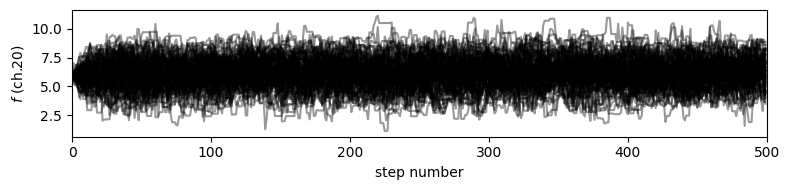

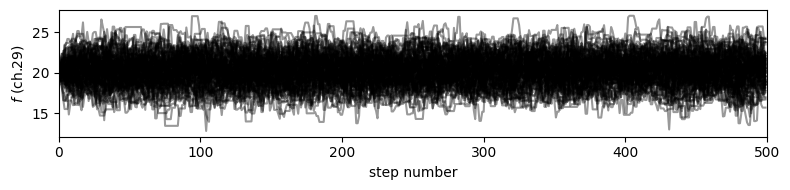

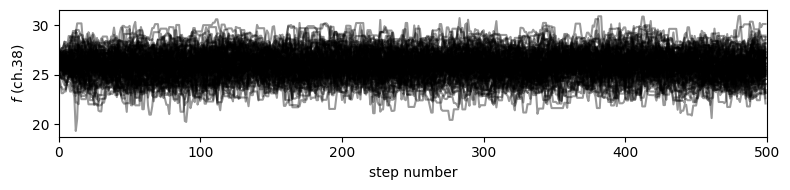

In [93]:
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_walk_plot(chain[i], labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

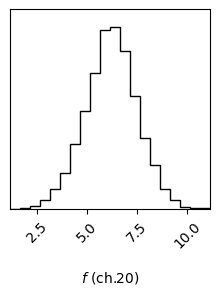

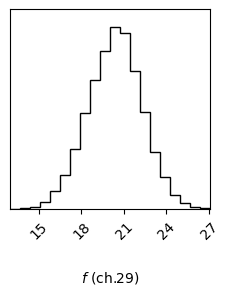

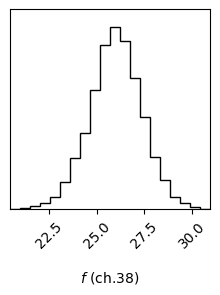

In [94]:
burnin = 0.3
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_corner_plot(chain[i], burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [95]:
npar = 1

In [96]:
isamples_flat = chain[0][:, int(chain[0].shape[1]//(1/burnin)):, :].reshape((-1,npar))
for i in range(1,len(test_ch)):
    isamples_flat = np.hstack((isamples_flat, 
                               chain[i][:, int(chain[i].shape[1]//(1/burnin)):, :].reshape((-1,npar))))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

/Users/valentin/GitHub/VIP/vip_hci/fm/negfc_mcmc.py:1541: UserWarning: The figure layout has changed to tight
  plt.tight_layout(w_pad=0.1)


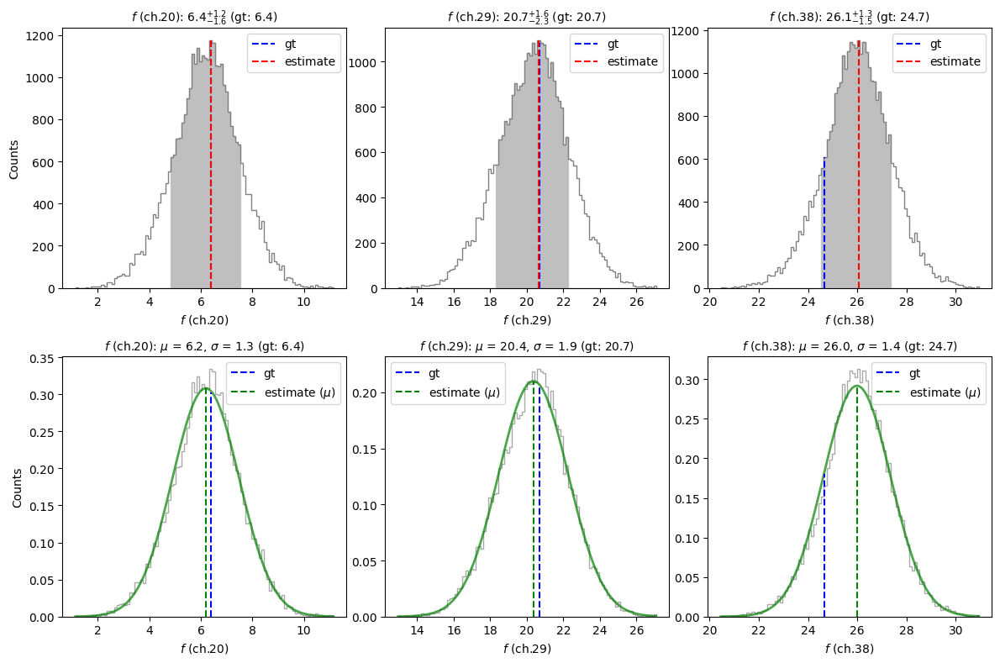

In [97]:
gt = []
labels = []
for i, ch in enumerate(test_ch):
    gt.append(flux_c_scal[ch])
    labels.append(r"$f$ (ch.{:.0f})".format(ch))

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated fluxes are consistent with the ground truth values (shown with dashed blue lines).